# **Inference process to evaluate models on Van Mijenfjorden 2025 dataset**

# **1. Connect to Google drive and import dataset**

The dataset must be divided into train, valid and test sets

Each folder with two subfolder, images and txt

Only test set contains real images and txt within each subfolder

Import model file as well


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
################################IMPORTAR EL dataset entero a colab UNA VEZ TIENES LA ESTRUCTURA  ####################################################
####################################################################################


# Copiar el archivo data.yaml desde Drive a la ruta deseada en Colab
!cp -r "/content/drive/MyDrive/inference/AWS.v145van_mijen_final_inferencei.yolov8" "/content/dataset"

# Verificar que se copió correctamente
!ls -l "/content/dataset"

total 12
-rw------- 1 root root  236 Aug 13 15:18 data.yaml
-rw------- 1 root root  949 Aug 13 15:18 README.roboflow.txt
drwx------ 4 root root 4096 Aug 13 15:27 train


# **2. Tiling process**

 Tile the images (6000 x 4000 pixels) to tiles ( 640 x 640 pixels)

 The tiles are saved in a folder of your choice in the Google Colab cloud

 It provides with the tiles and ground truth for the tiles that will be used later for inference

In [4]:
import os
import cv2
import numpy as np
import shutil
import yaml # Importar yaml para leer el archivo data.yaml

# ====================
# CONFIGURACIÓN
# ====================
TILE_SIZE = 640
OVERLAP = 128
STEP = TILE_SIZE - OVERLAP
MIN_SIZE = 0.01
IMAGE_EXTENSIONS = ('.jpg', '.jpeg', '.png')

# RUTAS DE ENTRADA Y SALIDA
IMAGE_DIR = "/content/dataset/train/images"
LABEL_DIR = "/content/dataset/train/labels"
EXPORT_DIR = "/content/van_mijen_eval"
# Ruta al archivo data.yaml original
DATA_YAML_SOURCE_PATH = "/content/dataset/data.yaml"

# ====================
# FUNCIONES UTILIDAD
# ====================
def polygon_to_bbox(coords):
    if not coords or len(coords) % 2 != 0:
        return None
    xs = coords[0::2]
    ys = coords[1::2]
    if not xs or not ys:
        return None
    x_min, x_max = min(xs), max(xs)
    y_min, y_max = min(ys), max(ys)
    return (x_min + x_max) / 2, (y_min + y_max) / 2, x_max - x_min, y_max - y_min

def load_annotations(label_path, image_width, image_height):
    annotations = []
    if not os.path.exists(label_path):
        return annotations
    with open(label_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if not parts:
                continue
            cls = parts[0]
            try:
                coords = list(map(float, parts[1:]))
            except:
                continue
            if len(coords) == 4:
                x_center, y_center, w, h = coords
                x1 = (x_center - w / 2) * image_width
                y1 = (y_center - h / 2) * image_height
                x2 = (x_center + w / 2) * image_width
                y2 = (y_center + h / 2) * image_height
            else:
                bbox = polygon_to_bbox(coords)
                if bbox is None:
                    continue
                x_center, y_center, w, h = bbox
                x1 = (x_center - w / 2) * image_width
                y1 = (y_center - h / 2) * image_height
                x2 = (x_center + w / 2) * image_width
                y2 = (y_center + h / 2) * image_height
            annotations.append((cls, x1, y1, x2, y2))
    return annotations

def adjust_annotation_for_tile(annotation, tile_x, tile_y, tile_size):
    cls, x1, y1, x2, y2 = annotation
    inter_x1 = max(x1, tile_x)
    inter_y1 = max(y1, tile_y)
    inter_x2 = min(x2, tile_x + tile_size)
    inter_y2 = min(y2, tile_y + tile_size)
    if inter_x2 <= inter_x1 or inter_y2 <= inter_y1:
        return None
    local_x1 = inter_x1 - tile_x
    local_y1 = inter_y1 - tile_y
    local_x2 = inter_x2 - tile_x
    local_y2 = inter_y2 - tile_y
    w = local_x2 - local_x1
    h = local_y2 - local_y1
    x_center = local_x1 + w / 2
    y_center = local_y1 + h / 2
    norm_x = x_center / tile_size
    norm_y = y_center / tile_size
    norm_w = w / tile_size
    norm_h = h / tile_size
    if norm_w < MIN_SIZE or norm_h < MIN_SIZE:
        return None
    return (cls, norm_x, norm_y, norm_w, norm_h)

# ====================
# PROCESAR UNA IMAGEN
# ====================
def tile_image(img_path, label_path, out_img_dir, out_lbl_dir, instance_counts_by_class):
    image = cv2.imread(img_path)
    if image is None:
        print(f"⚠️ No se pudo cargar la imagen: {img_path}")
        return 0, 0

    base_name = os.path.splitext(os.path.basename(img_path))[0]
    h, w = image.shape[:2]
    annotations = load_annotations(label_path, w, h)
    tile_idx = 0
    count_with_labels = 0
    count_empty = 0

    log_dir = os.path.join(EXPORT_DIR, "logs")
    os.makedirs(log_dir, exist_ok=True)
    log_path = os.path.join(log_dir, "tiles_descartados.txt")
    discard_entries = []

    for y in range(0, h, STEP):
        for x in range(0, w, STEP):
            tile = image[y:min(y+TILE_SIZE, h), x:min(x+TILE_SIZE, w)]
            if tile.shape[0] < TILE_SIZE or tile.shape[1] < TILE_SIZE:
                padded = np.zeros((TILE_SIZE, TILE_SIZE, 3), dtype=tile.dtype)
                padded[:tile.shape[0], :tile.shape[1]] = tile
                tile = padded

            tile_name = f"{base_name}_tile_{tile_idx}.jpg"
            label_name = f"{base_name}_tile_{tile_idx}.txt"
            tile_idx += 1

            valid_annots = []
            for ann in annotations:
                adj = adjust_annotation_for_tile(ann, x, y, TILE_SIZE)
                if adj:
                    valid_annots.append(adj)
                    # Contar la instancia por clase
                    class_id = int(adj[0]) # Convertir a int si la clase es numérica
                    if class_id in instance_counts_by_class:
                        instance_counts_by_class[class_id] += 1
                    else:
                        instance_counts_by_class[class_id] = 1 # Inicializar si es la primera vez

            cv2.imwrite(os.path.join(out_img_dir, tile_name), tile)
            with open(os.path.join(out_lbl_dir, label_name), 'w') as f:
                for cls, xc, yc, w_, h_ in valid_annots:
                    f.write(f"{cls} {xc:.6f} {yc:.6f} {w_:.6f} {h_:.6f}\n")

            if valid_annots:
                count_with_labels += 1
            else:
                count_empty += 1
                discard_entries.append(f"{tile_name} → sin etiquetas válidas")

    if discard_entries:
        with open(log_path, "a") as log:
            log.write(f"\n🔹 DESCARTES PARA {base_name.upper()}\n")
            log.write("-" * 50 + "\n")
            for entry in discard_entries:
                log.write(entry + "\n")
            log.write(f"\n🔸 TOTAL: {len(discard_entries)} tiles vacíos\n")

    return count_with_labels, count_empty

# ====================
# CREAR CARPETAS VACÍAS
# ====================
def ensure_ultralytics_dirs(export_dir):
    for split in ["train", "valid"]:
        img_dir = os.path.join(export_dir, split, "images")
        lbl_dir = os.path.join(export_dir, split, "labels")
        os.makedirs(img_dir, exist_ok=True)
        os.makedirs(lbl_dir, exist_ok=True)

# ====================
# PIPELINE PRINCIPAL
# ====================
def run_pipeline(image_dir, label_dir, export_dir, data_yaml_source):
    # Asegurarse de que el directorio de exportación exista antes de crear subdirectorios
    os.makedirs(export_dir, exist_ok=True)

    img_out = os.path.join(export_dir, "test", "images")
    lbl_out = os.path.join(export_dir, "test", "labels")
    os.makedirs(img_out, exist_ok=True)
    os.makedirs(lbl_out, exist_ok=True)

    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(IMAGE_EXTENSIONS)]
    total_with_labels = 0
    total_empty = 0
    # Diccionario para almacenar el conteo de instancias por clase
    instance_counts_by_class = {}

    print(f"🔄 Iniciando el proceso de tiling para {len(image_files)} imágenes...")

    for img_file in image_files:
        img_path = os.path.join(image_dir, img_file)
        label_path = os.path.join(label_dir, os.path.splitext(img_file)[0] + ".txt")
        # Pasar instance_counts_by_class para que sea actualizado
        with_labels, empty = tile_image(img_path, label_path, img_out, lbl_out, instance_counts_by_class)
        total_with_labels += with_labels
        total_empty += empty

    print(f"\n✅ Proceso de tiling terminado.")
    print(f"🧩 Tiles con etiquetas: {total_with_labels}")
    print(f"📭 Tiles sin etiquetas: {total_empty}")

    # --- Resumen de instancias por clase ---
    print("\n--- Resumen de Instancias por Clase ---")
    class_names = {}
    if os.path.exists(data_yaml_source):
        try:
            with open(data_yaml_source, 'r') as f:
                data_config = yaml.safe_load(f)
            if 'names' in data_config:
                class_names = {i: name for i, name in enumerate(data_config['names'])}
                print(f"Clases cargadas de '{os.path.basename(data_yaml_source)}': {class_names}")
        except Exception as e:
            print(f"❌ Error al leer las clases de '{data_yaml_source}': {e}")
            print("Se mostrarán las clases por su ID numérico.")
    else:
        print(f"⚠️ Advertencia: El archivo '{data_yaml_source}' no se encontró. No se pueden obtener los nombres de las clases.")
        print("Se mostrarán las clases por su ID numérico.")

    if not instance_counts_by_class:
        print("No se detectaron instancias en los tiles procesados.")
    else:
        total_instances_overall = 0
        for class_id in sorted(instance_counts_by_class.keys()):
            count = instance_counts_by_class[class_id]
            class_name = class_names.get(class_id, f"Clase {class_id}")
            print(f"  - {class_name}: {count} instancias")
            total_instances_overall += count
        print(f"Total de instancias procesadas: {total_instances_overall}")


    # Crear carpetas vacías para train y val (si aún no existen)
    ensure_ultralytics_dirs(export_dir)

    # --- Copiar data.yaml ---
    data_yaml_destination_path = os.path.join(export_dir, os.path.basename(data_yaml_source))
    if os.path.exists(data_yaml_source):
        try:
            shutil.copyfile(data_yaml_source, data_yaml_destination_path)
            print(f"\n📂 Archivo '{os.path.basename(data_yaml_source)}' copiado a '{export_dir}'.")
        except Exception as e:
            print(f"❌ Error al copiar '{os.path.basename(data_yaml_source)}': {e}")
    else:
        print(f"\n⚠️ Advertencia: El archivo '{data_yaml_source}' no se encontró. No se pudo copiar.")

# ====================
# EJECUCIÓN
# ====================
run_pipeline(IMAGE_DIR, LABEL_DIR, EXPORT_DIR, DATA_YAML_SOURCE_PATH)

🔄 Iniciando el proceso de tiling para 3628 imágenes...

✅ Proceso de tiling terminado.
🧩 Tiles con etiquetas: 84
📭 Tiles sin etiquetas: 348204

--- Resumen de Instancias por Clase ---
Clases cargadas de 'data.yaml': {0: 'seal'}
  - seal: 106 instancias
Total de instancias procesadas: 106

📂 Archivo 'data.yaml' copiado a '/content/van_mijen_eval'.


# **3. Install Ultralytics**

In [5]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 59.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 92.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 60.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 12.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 42.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.7/188.7 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 93.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-c

# **4. Inference in Ultralytics official evaluation funtion (model.eval) on the test set**

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.174 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 9.4±1.6 MB/s, size: 17.6 KB)


val: Scanning /content/van_mijen_eval/test/labels... 348288 images, 348204 backgrounds, 0 corrupt: 100%|██████████| 348288/348288 [03:27<00:00, 1681.86it/s]


val: New cache created: /content/van_mijen_eval/test/labels.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 21768/21768 [56:35<00:00,  6.41it/s]


                   all     348288        106      0.877      0.742      0.839      0.505
Speed: 0.3ms preprocess, 8.8ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/val

📊 Métricas de test:
✔️ Precision:     0.8773
✔️ Recall:        0.7421
✔️ F1-score:      0.8041
✔️ mAP@0.5:       0.8389
✔️ mAP@0.5:0.95:  0.5051


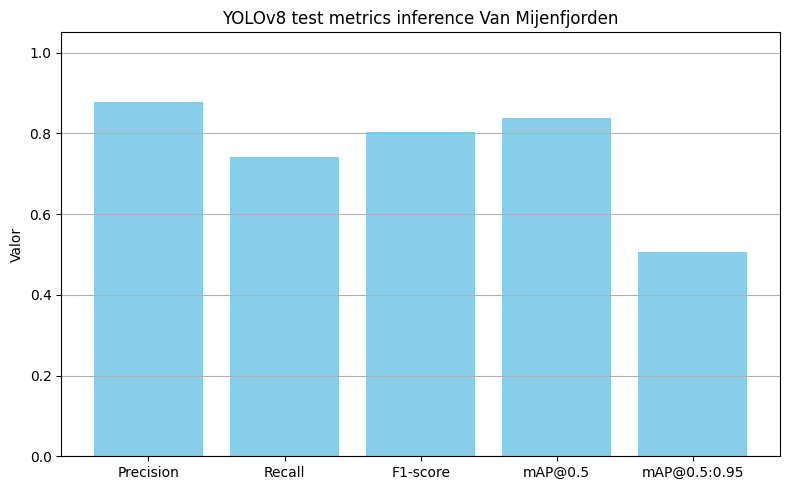


📄 CSV guardado en: /content/metricas_test_z_yolo_23/metricas_validacion_conf__iou_.csv
🖼️ Gráfico guardado en: /content/metricas_test_z_yolo_23/metricas_conf__iou_.png


In [ ]:
import os
import matplotlib.pyplot as plt
import pandas as pd
from ultralytics import YOLO # <--- Add this line

# === CONFIGURACIÓN ===
model_path = "/content/best_coseno_z_25.pt"
data_yaml = "/content/van_mijen_eval/data.yaml"
OUTPUT_DIR = "/content/metricas_test_z_yolo_23"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# === Cargar modelo ===
model = YOLO(model_path)

# === Ejecutar validación ===
metrics = model.val(data=data_yaml, split="test", save_txt=True)

# === Extraer métricas ===
precision = metrics.box.mp
recall = metrics.box.mr
f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0
map50 = metrics.box.map50
map5095 = metrics.box.map

# === Mostrar métricas por consola ===
print("\n📊 Métricas de test:")
print(f"✔️ Precision:     {precision:.4f}")
print(f"✔️ Recall:        {recall:.4f}")
print(f"✔️ F1-score:      {f1:.4f}")
print(f"✔️ mAP@0.5:       {map50:.4f}")
print(f"✔️ mAP@0.5:0.95:  {map5095:.4f}")

# === Graficar ===
metric_names = ["Precision", "Recall", "F1-score", "mAP@0.5", "mAP@0.5:0.95"]
metric_values = [precision, recall, f1, map50, map5095]

plt.figure(figsize=(8, 5))
plt.bar(metric_names, metric_values, color='skyblue')
plt.ylim(0, 1.05)
plt.title(f"YOLOv8 test metrics inference Van Mijenfjorden")
plt.ylabel("Valor")
plt.grid(axis='y')
plt.tight_layout()
plot_path = os.path.join(OUTPUT_DIR, f"metricas_conf__iou_.png")
plt.savefig(plot_path)
plt.show()

# === Exportar CSV ===
csv_path = os.path.join(OUTPUT_DIR, f"metricas_validacion_conf__iou_.csv")
df_metrics = pd.DataFrame({
    "Métrica": metric_names,
    "Valor": metric_values
})
df_metrics.to_csv(csv_path, index=False)
print(f"\n📄 CSV guardado en: {csv_path}")
print(f"🖼️ Gráfico guardado en: {plot_path}")

# **5. Customized procedure to run the inference and evaluate the model on the Van Mijenfjorden dataset**

4.1 The model is evaluated on Ultralytics model.evaluate function (with the tiles obtained previously that are labeled)

4.2 The inference process is applied to the Van mijenfjorden tiles

4.3 The predictions are compared to the ground truth under different IoU and confidence threshold

-The IoU and confidence threshold for inference evaluation are customizable

-The IoU for NMS is customizable

- The model path and data_yaml path must be especified

- If the results wants to be save into Google drive, the directory have to be especified

- The code shows the results at the end with images as examples and final valuas, as well as saving results into the Google drive especified directory


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
✔️ Base output directory set to: /content/drive/MyDrive/inferencia_proSeal
--- Verificando directorios necesarios ---
✅ Directorios de datos encontrados.

--- Preparando directorios de salida ---
✔️ Output directories ensured in Google Drive.

--- Paso 1: Cargando el modelo: /content/best_coseno_z_25.pt ---
✅ Modelo cargado exitosamente.

--- Paso 2: Ejecutando model.val() para obtener métricas oficiales ---
Ultralytics 8.3.178 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 788.5±448.2 MB/s, size: 23.6 KB)


val: Scanning /content/van_mijen_eval/test/labels... 348288 images, 348204 backgrounds, 0 corrupt: 100%|██████████| 348288/348288 [02:29<00:00, 2328.96it/s]


val: New cache created: /content/van_mijen_eval/test/labels.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 21768/21768 [10:14<00:00, 35.40it/s]


                   all     348288        106      0.878      0.744      0.839      0.504
Speed: 0.1ms preprocess, 1.2ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to runs/detect/val

--- Métricas de Validación del Conjunto de TEST (model.val() con conf=0.001, iou=0.7) ---
mAP50:       0.8387
mAP50-95:    0.5040
Precisión:   0.8775
Recall:      0.7436

=== mAP50-95 por Clase ===
seal: mAP50-95 = 0.5040

✅ Plots y resultados de model.val() guardados automáticamente por Ultralytics en: runs/detect/val

📄 CSV de métricas de Ultralytics val guardado en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/ultralytics_val_metrics/metricas_ultralytics_val_conf0001_iou07.csv
🖼️ Gráfico de métricas de Ultralytics val guardado en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/ultralytics_val_metrics/grafica_ultralytics_val_conf0001_iou07.png

--- Paso 3: Generando predicciones con confianza y guardándolas en /content/drive/MyDrive/inferencia_proSeal/custom_pr

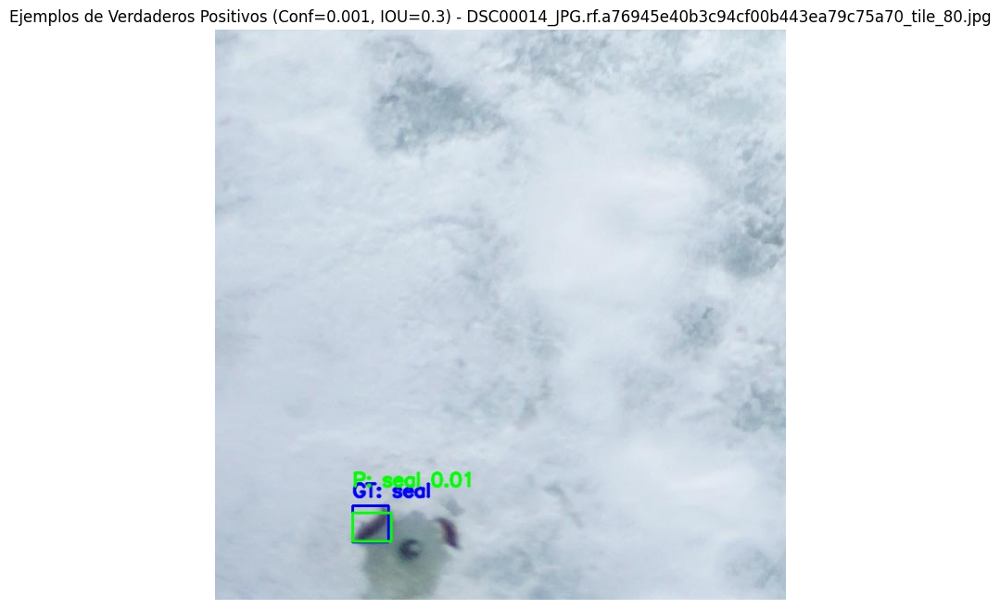

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_88.jpg


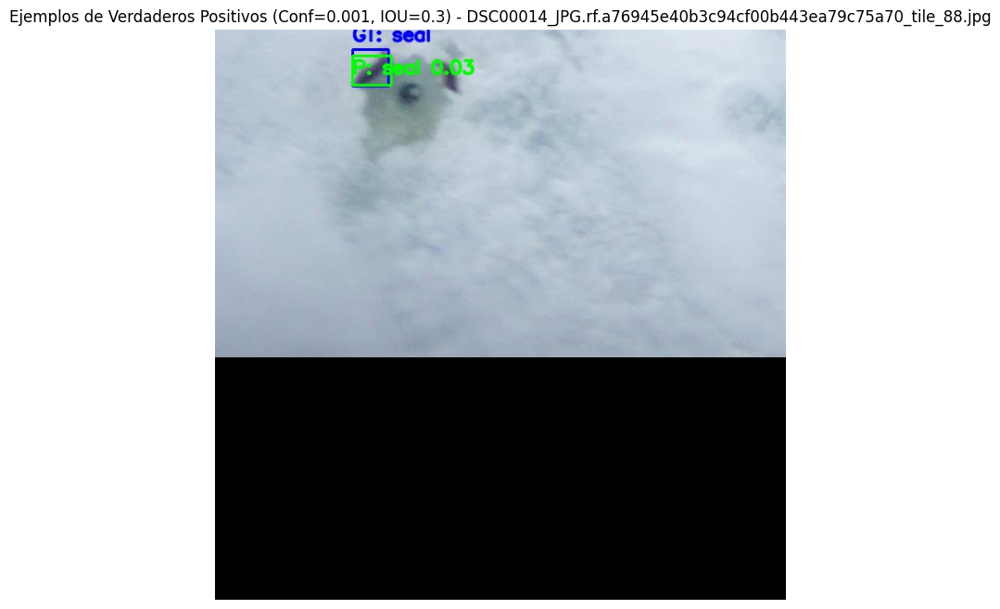

🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


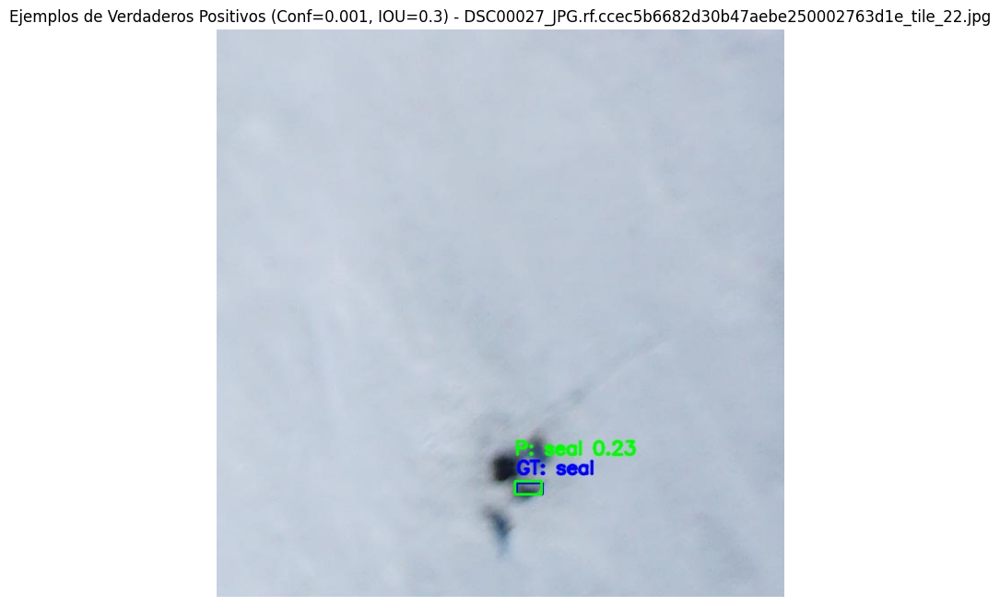


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.001, IOU=0.3)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


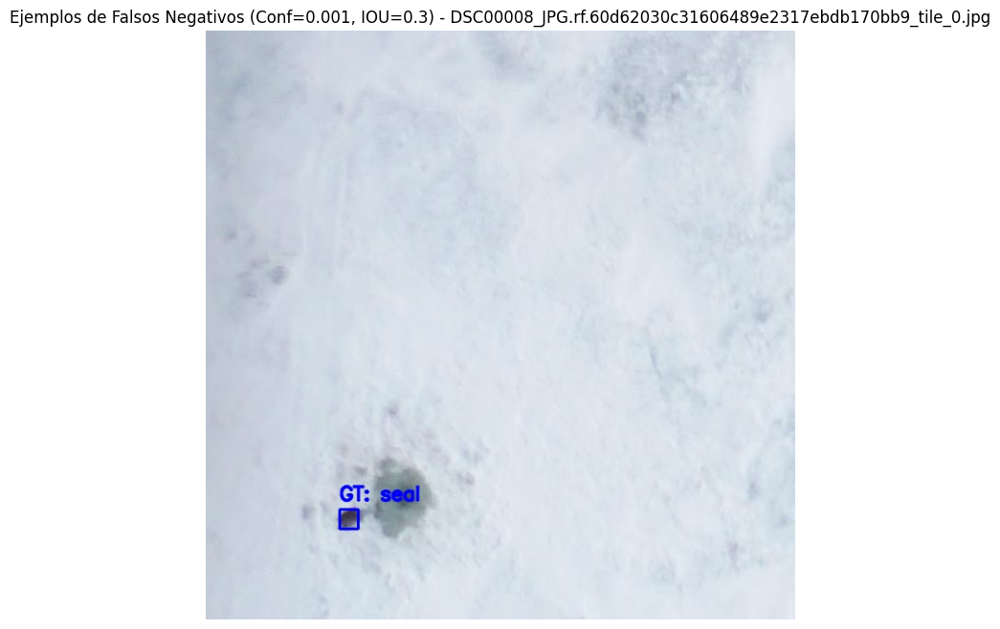

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


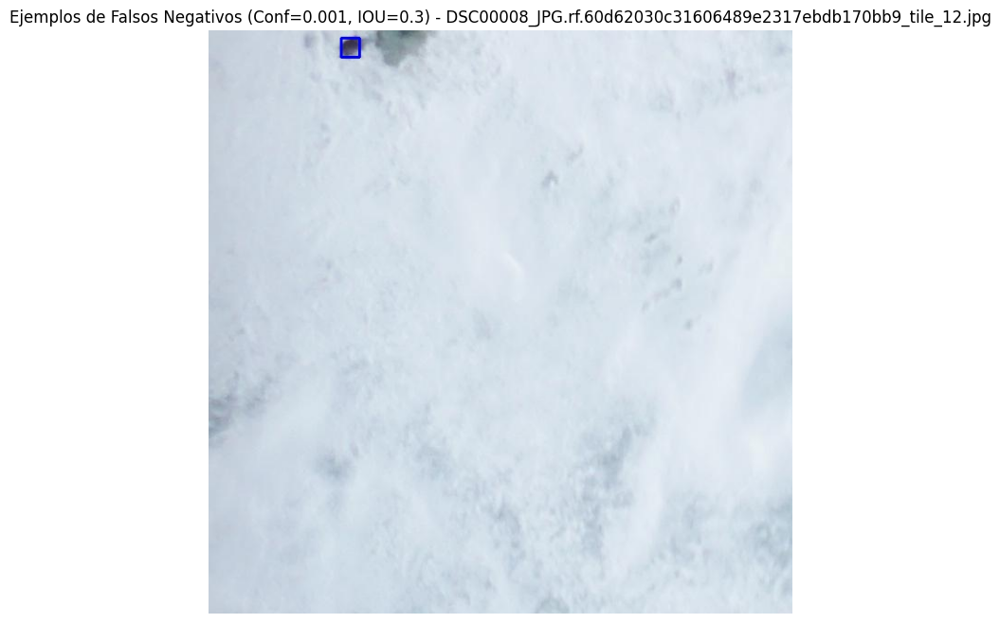

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_93.jpg


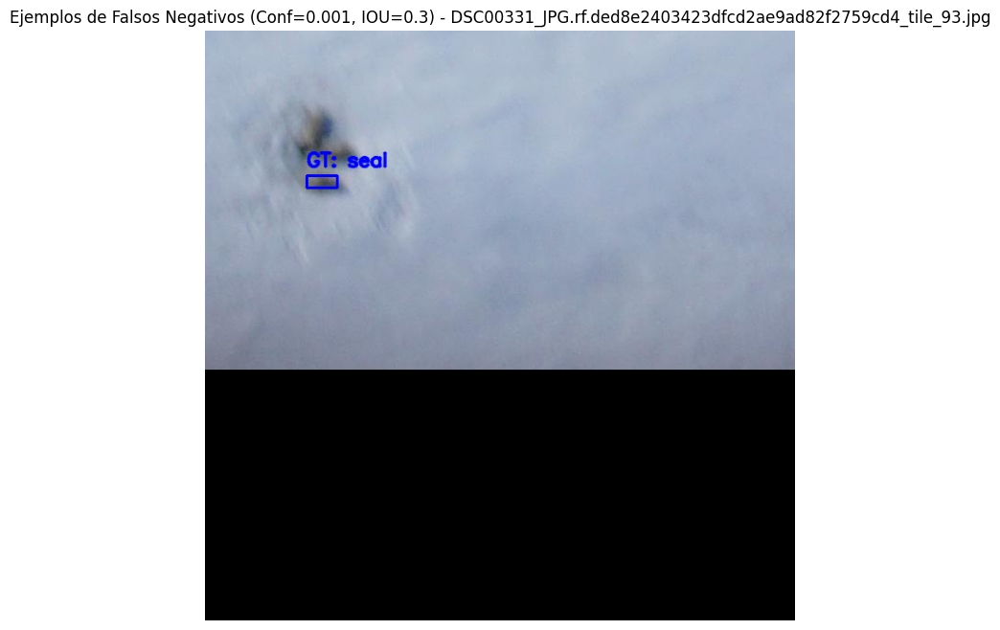


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.001, IOU=0.3)
🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


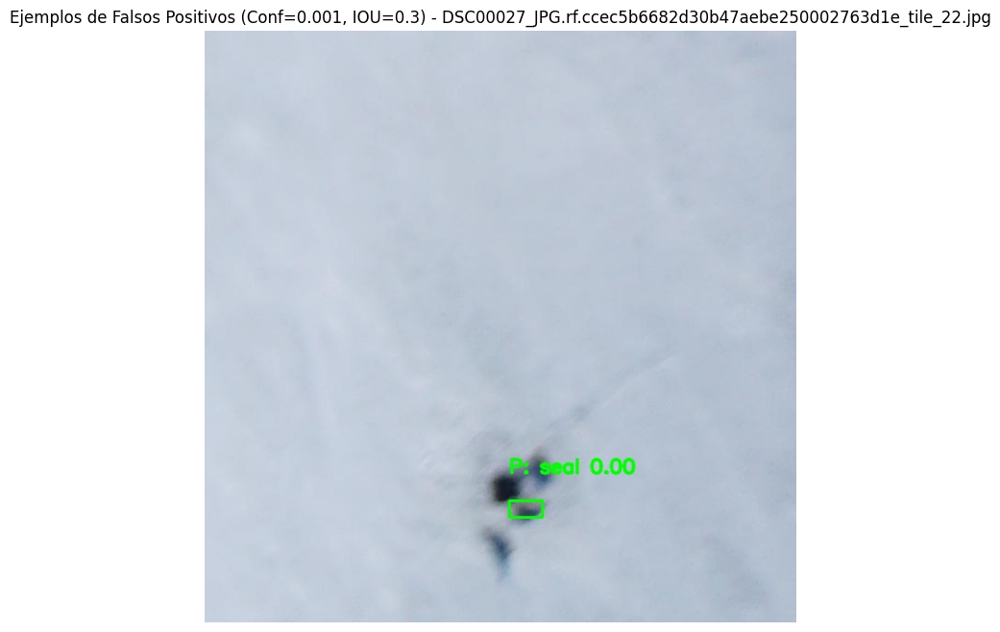

🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_34.jpg


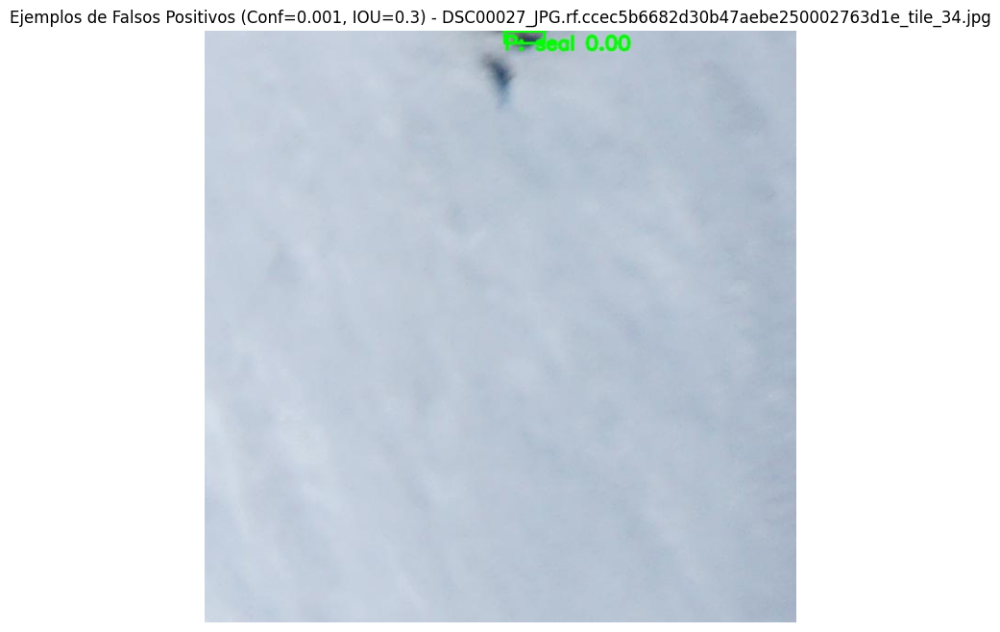

🖼️ Mostrando: DSC00085_JPG.rf.e7390ecaf46ae719a1e6c7bbe081ee3b_tile_24.jpg


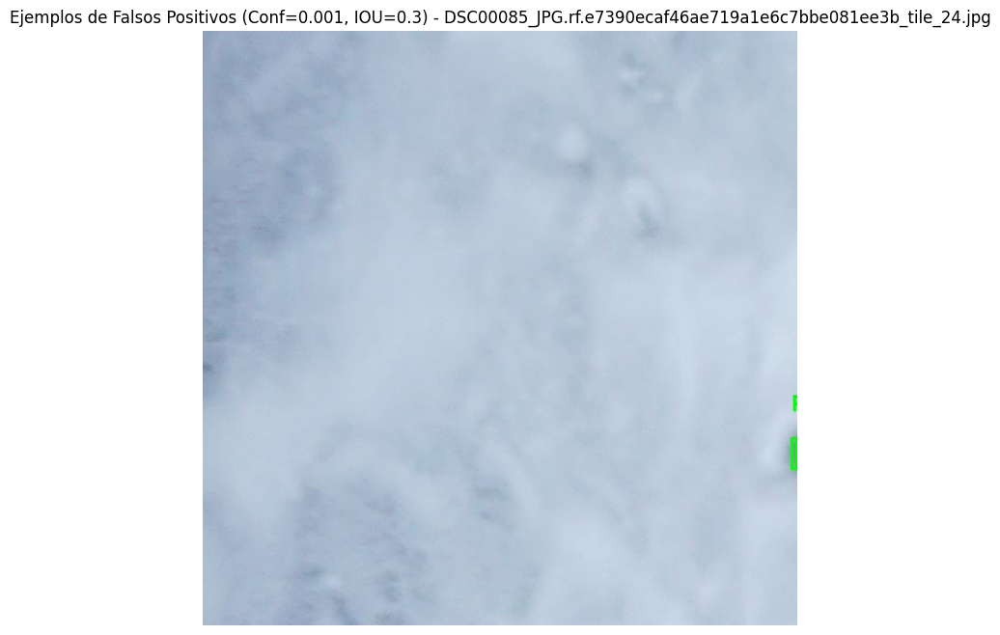


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf0001_iou03/errores_por_instancia_conf0001_iou03.csv

--- Generando curvas de rendimiento para Confianza=0.001, IOU=0.3 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou03/precision_recall_curve_iou03.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou03/f1_confidence_curve_iou03.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou03/precision_confidence_curve_iou03.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou03/recall_confidence_curve_iou03.png

--- Ejecutando Análisis para Confianza=0.001, IOU=0.5 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.001, IOU=0

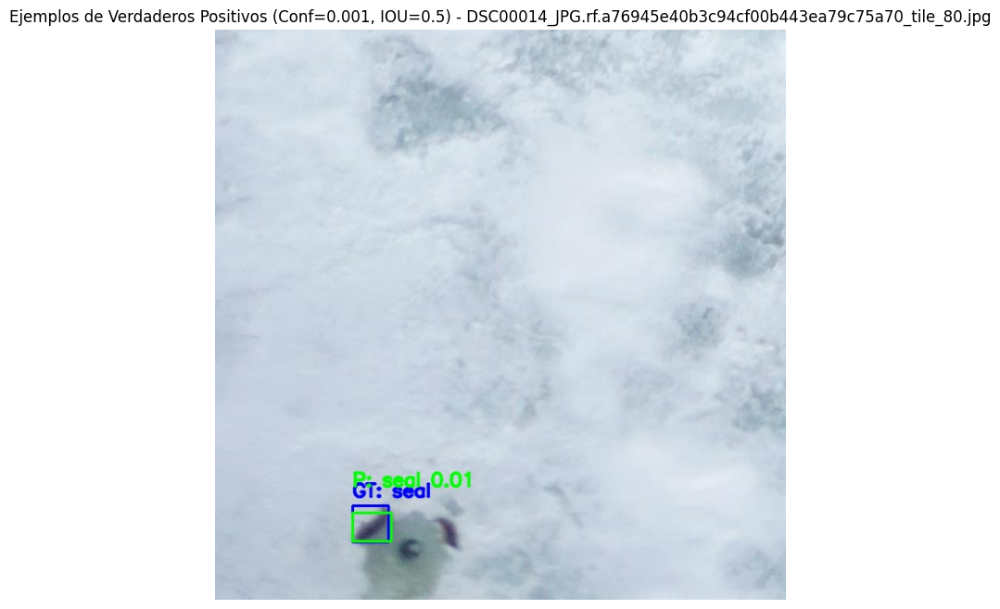

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_88.jpg


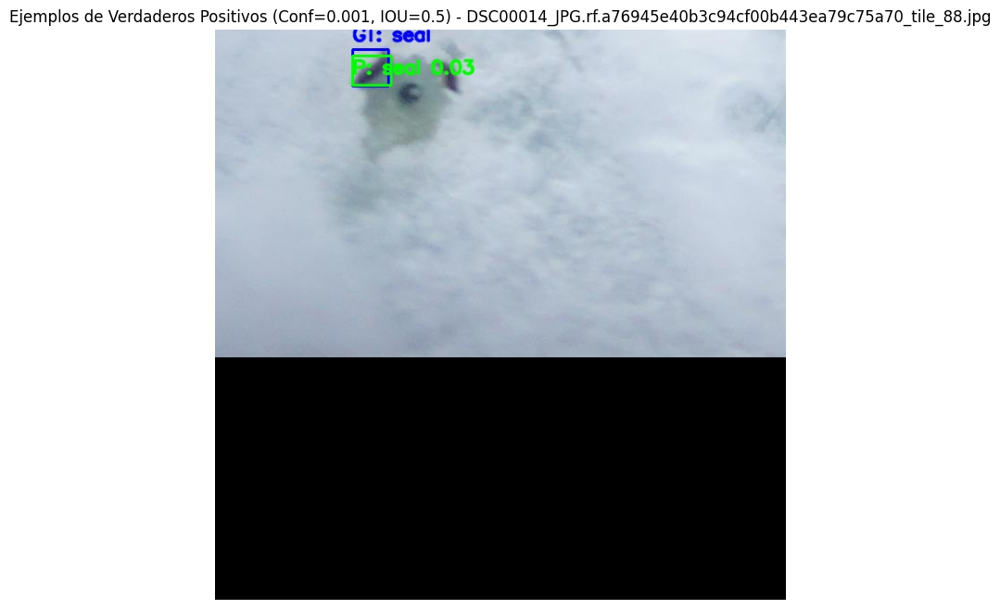

🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


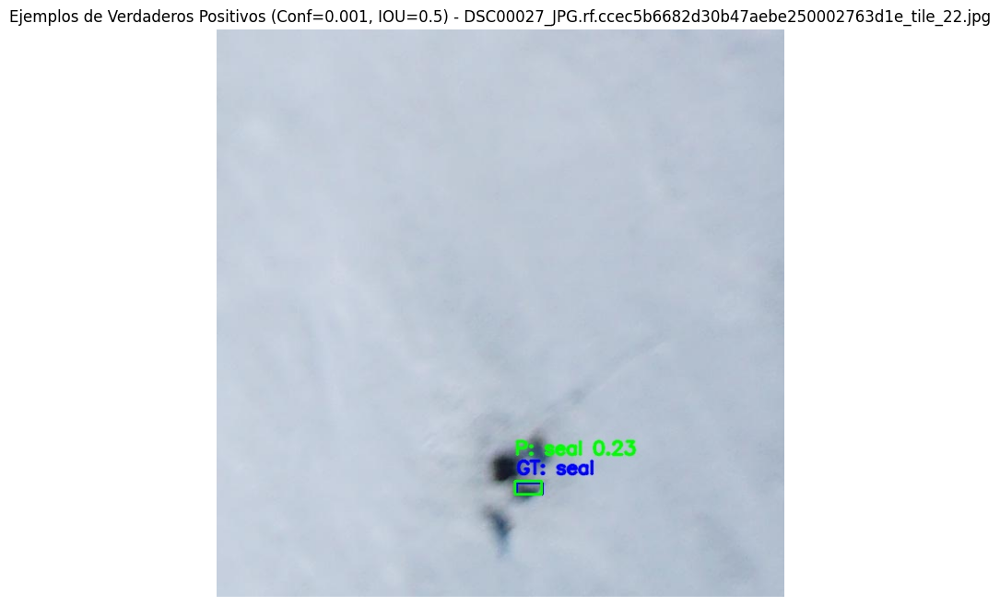


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.001, IOU=0.5)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


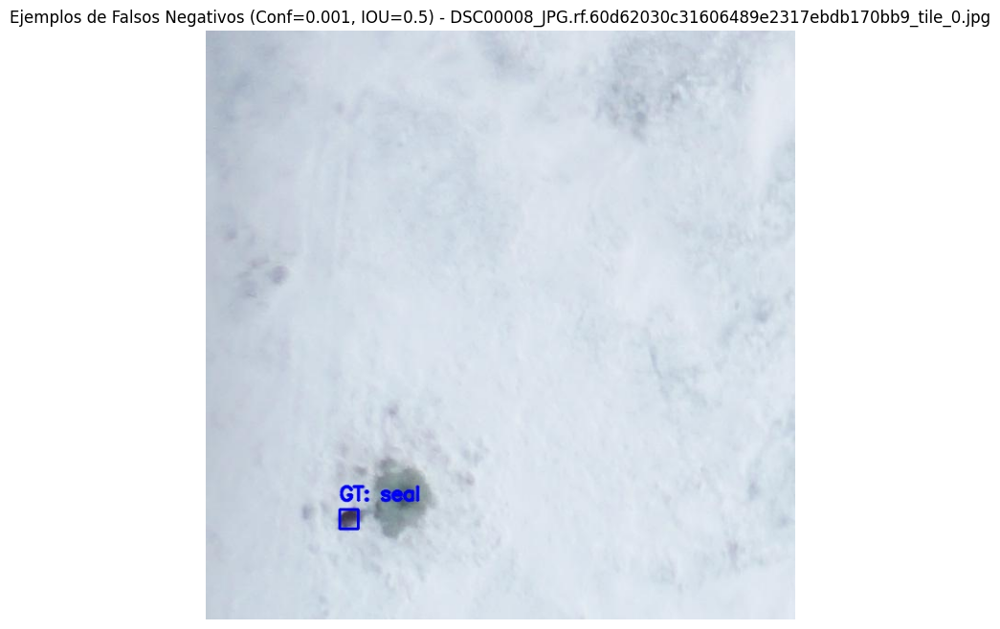

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


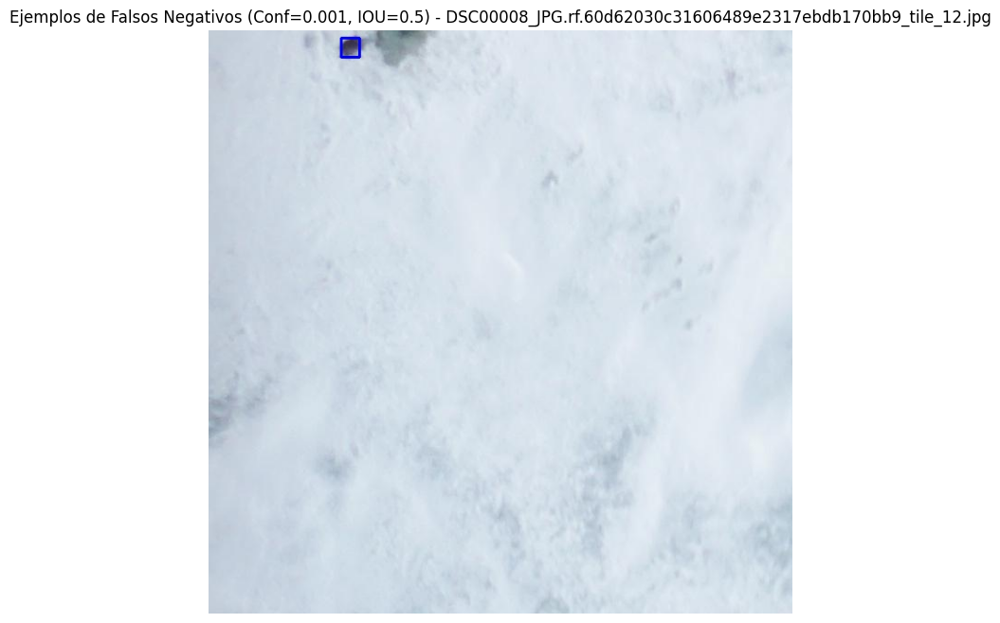

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_85.jpg


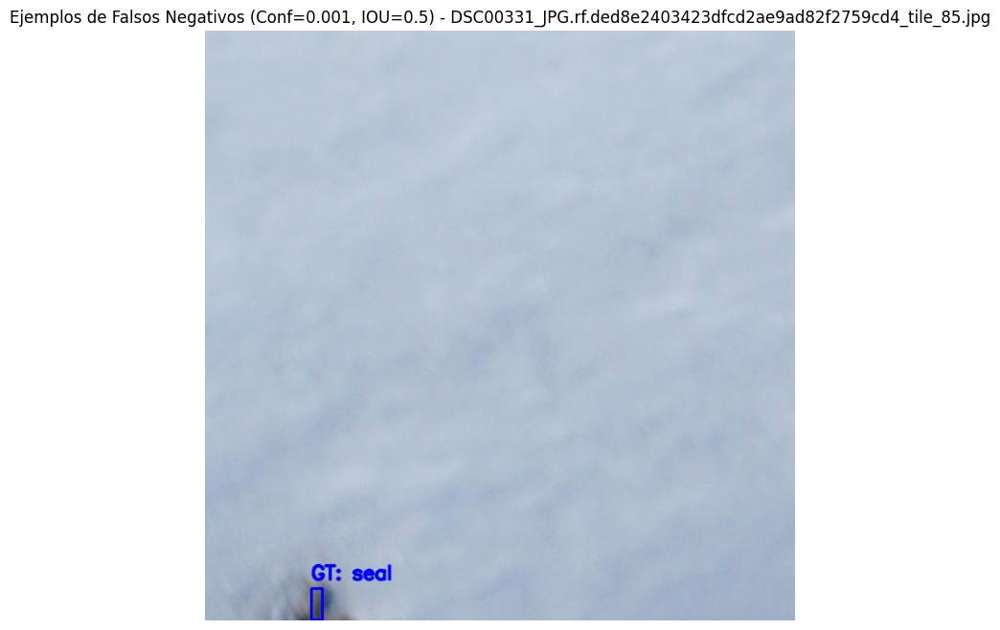


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.001, IOU=0.5)
🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


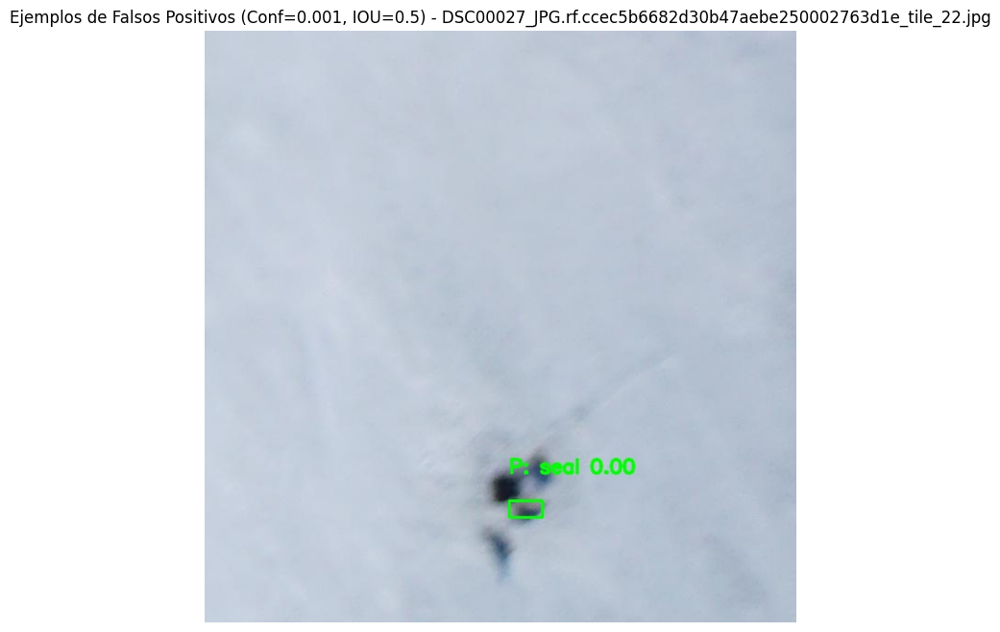

🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_34.jpg


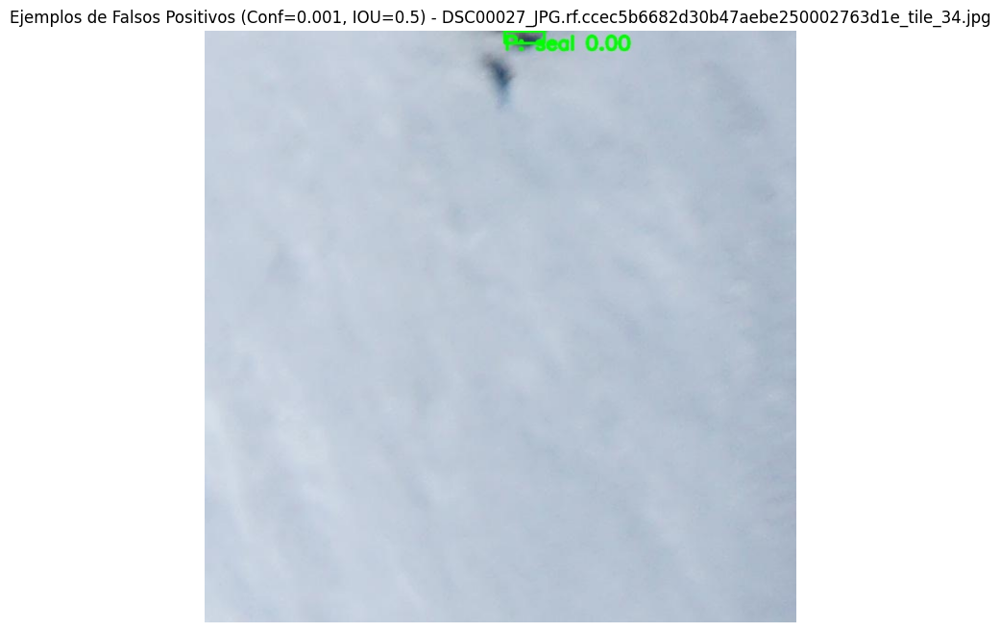

🖼️ Mostrando: DSC00085_JPG.rf.e7390ecaf46ae719a1e6c7bbe081ee3b_tile_24.jpg


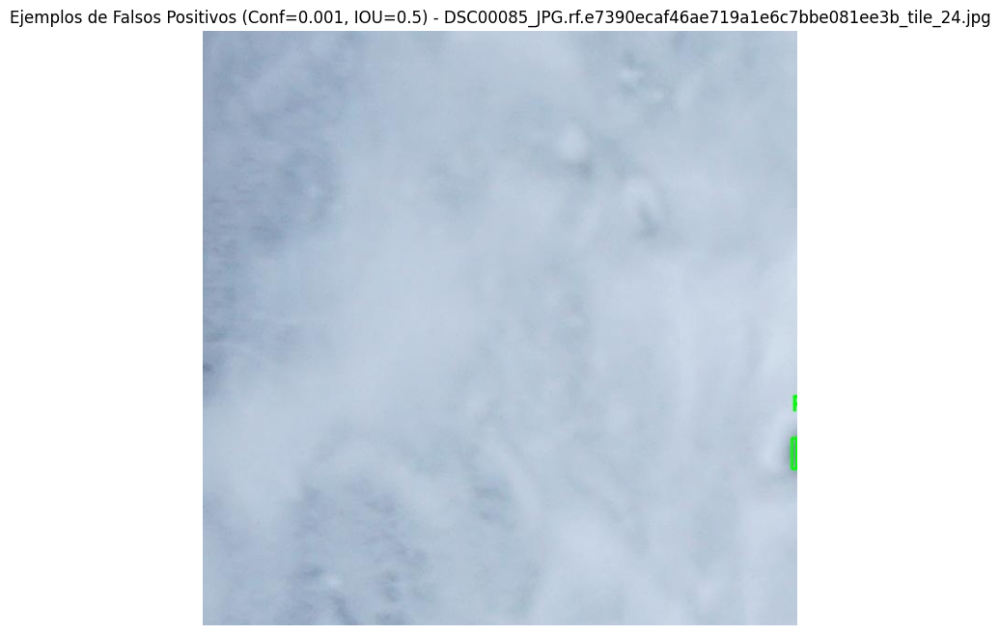


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf0001_iou05/errores_por_instancia_conf0001_iou05.csv

--- Generando curvas de rendimiento para Confianza=0.001, IOU=0.5 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou05/precision_recall_curve_iou05.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou05/f1_confidence_curve_iou05.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou05/precision_confidence_curve_iou05.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf0001_iou05/recall_confidence_curve_iou05.png

--- Ejecutando Análisis para Confianza=0.01, IOU=0.3 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.01, IOU=0.3

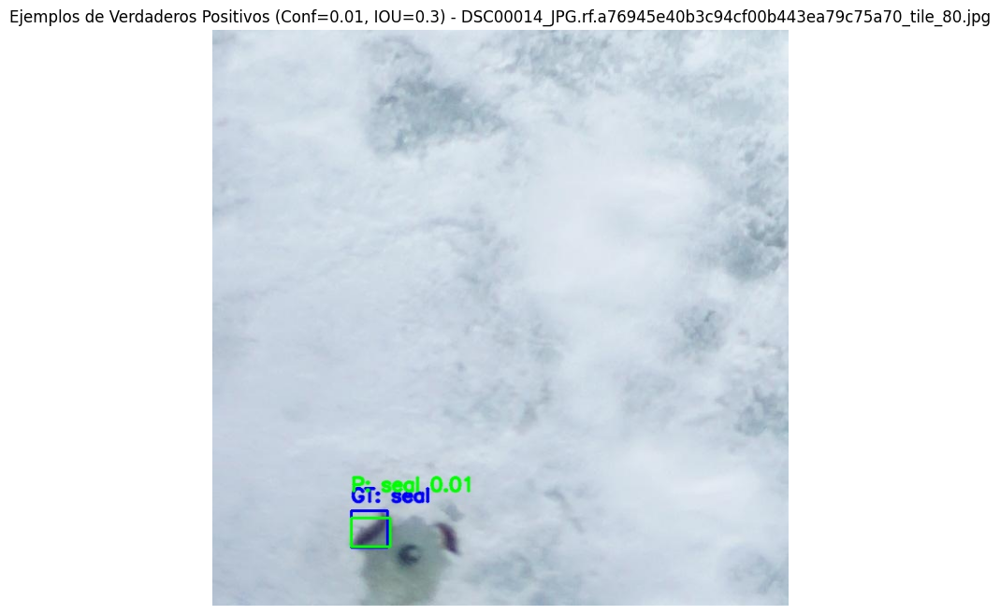

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_88.jpg


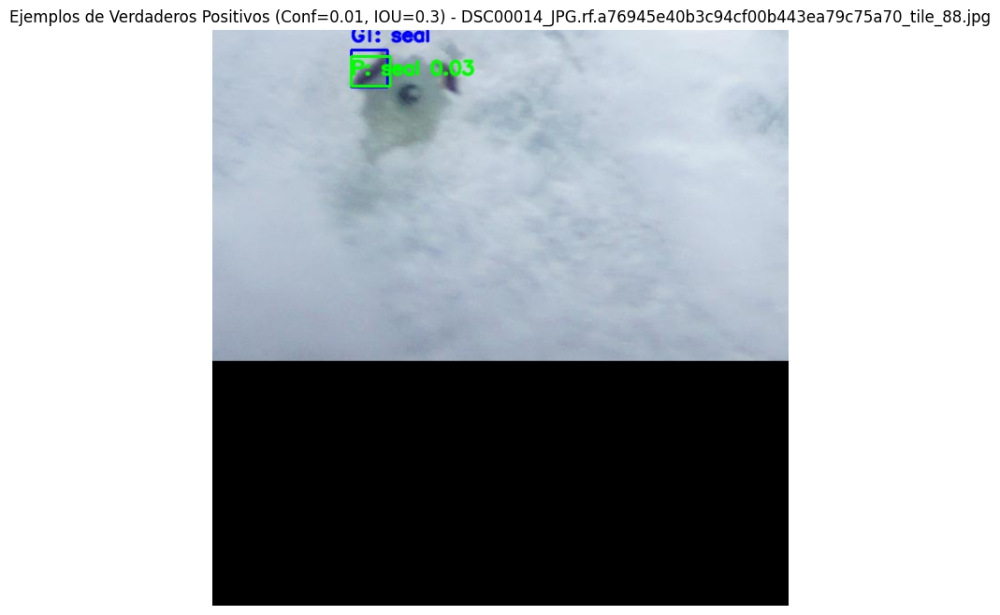

🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


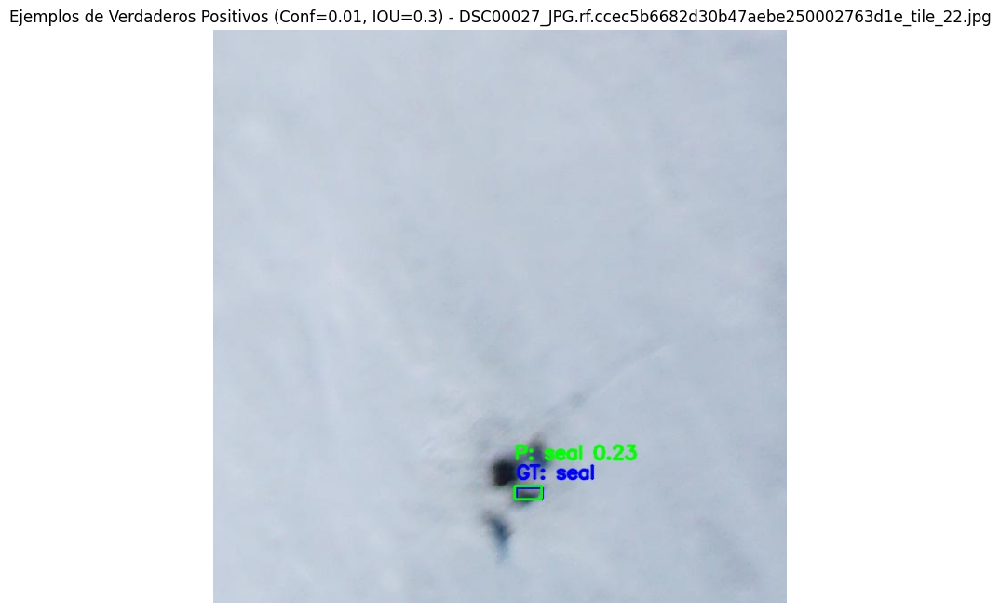


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.01, IOU=0.3)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


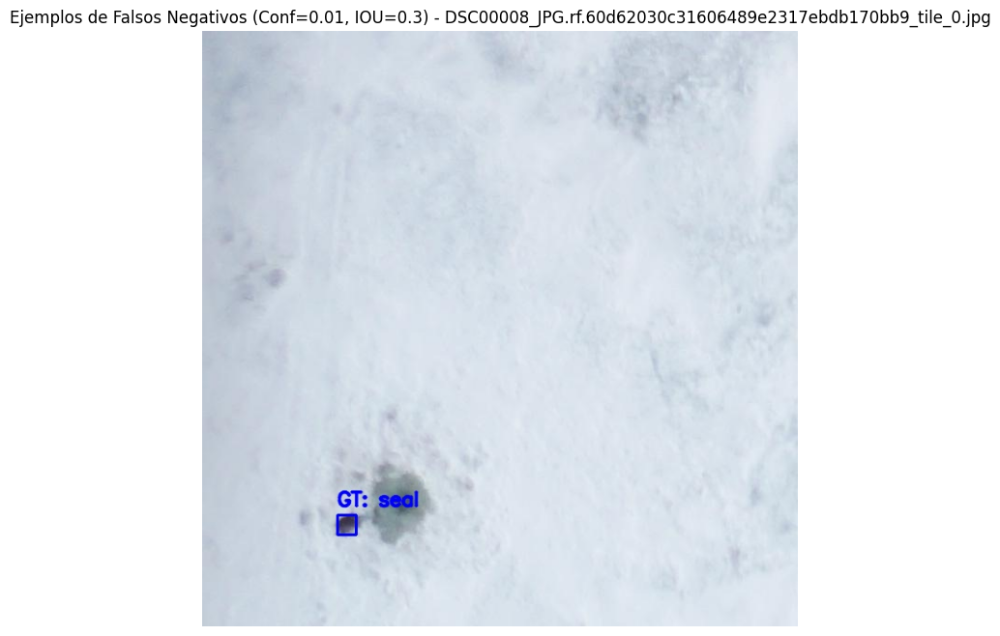

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


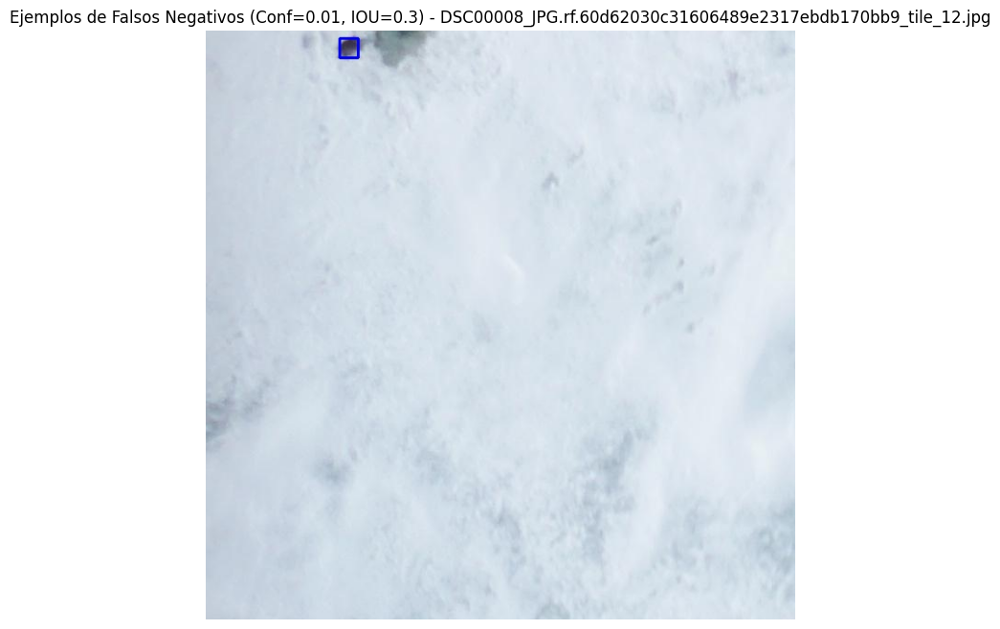

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_92.jpg


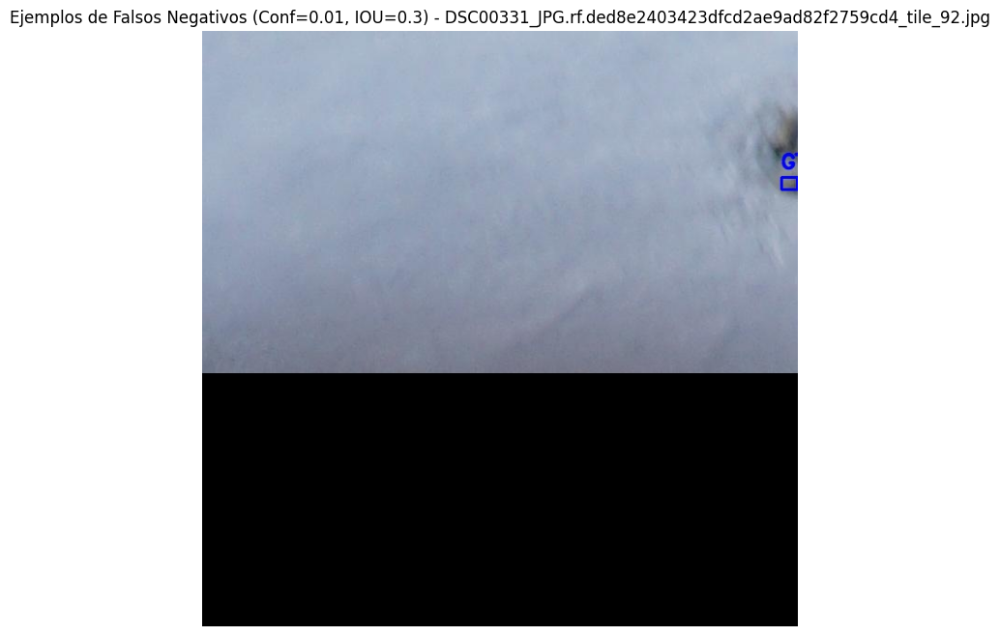


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.01, IOU=0.3)
🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


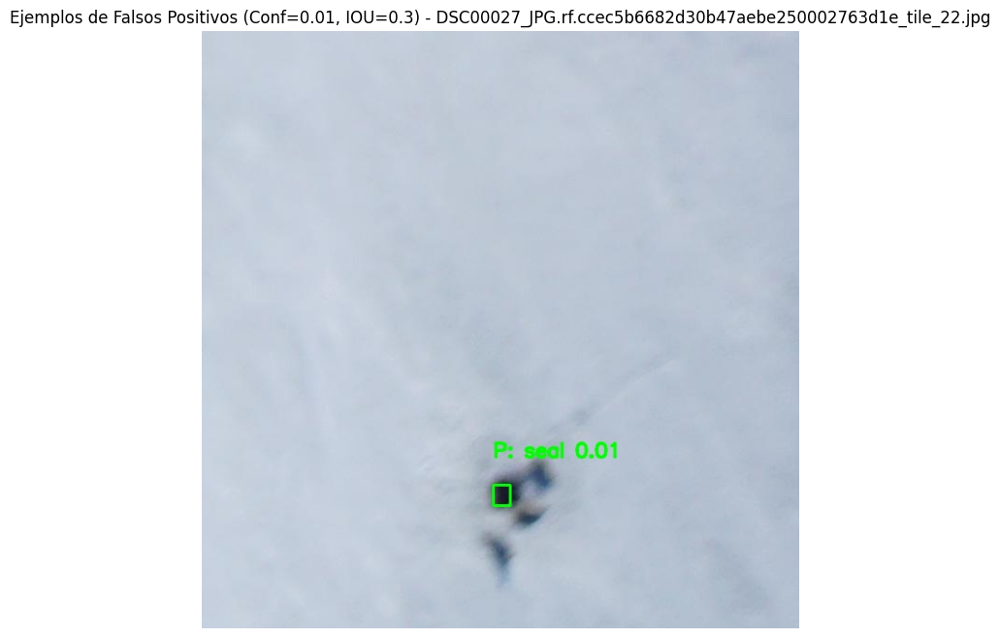

🖼️ Mostrando: DSC00304_JPG.rf.ad12f2268375f373b46df007a44c379f_tile_70.jpg


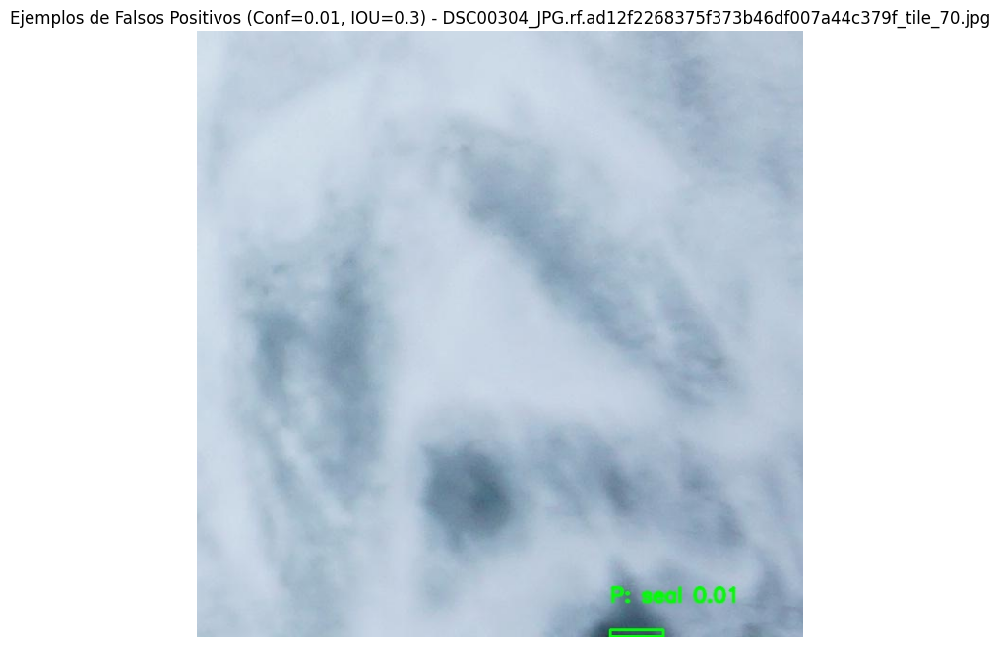

🖼️ Mostrando: DSC00313_JPG.rf.0defa291036b5e8b14daa6c9932b0e67_tile_87.jpg


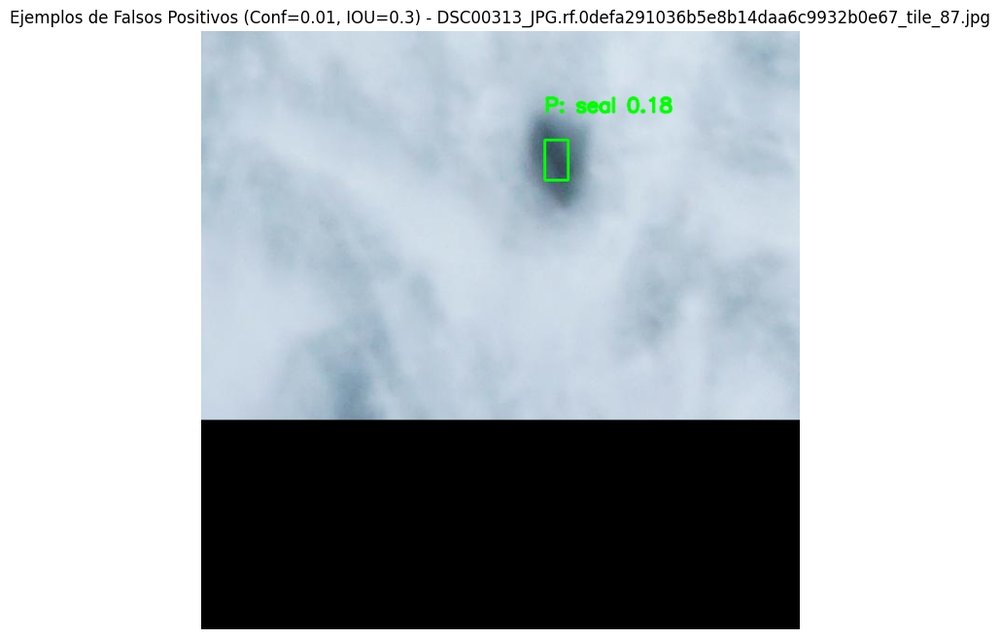


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf001_iou03/errores_por_instancia_conf001_iou03.csv

--- Generando curvas de rendimiento para Confianza=0.01, IOU=0.3 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou03/precision_recall_curve_iou03.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou03/f1_confidence_curve_iou03.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou03/precision_confidence_curve_iou03.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou03/recall_confidence_curve_iou03.png

--- Ejecutando Análisis para Confianza=0.01, IOU=0.5 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.01, IOU=0.5) ---
✔

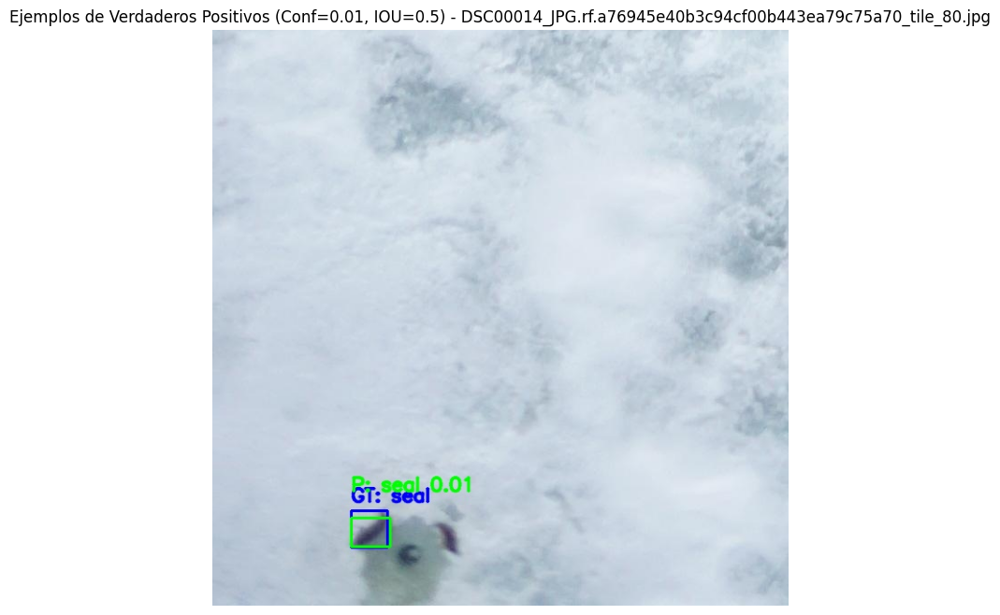

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_88.jpg


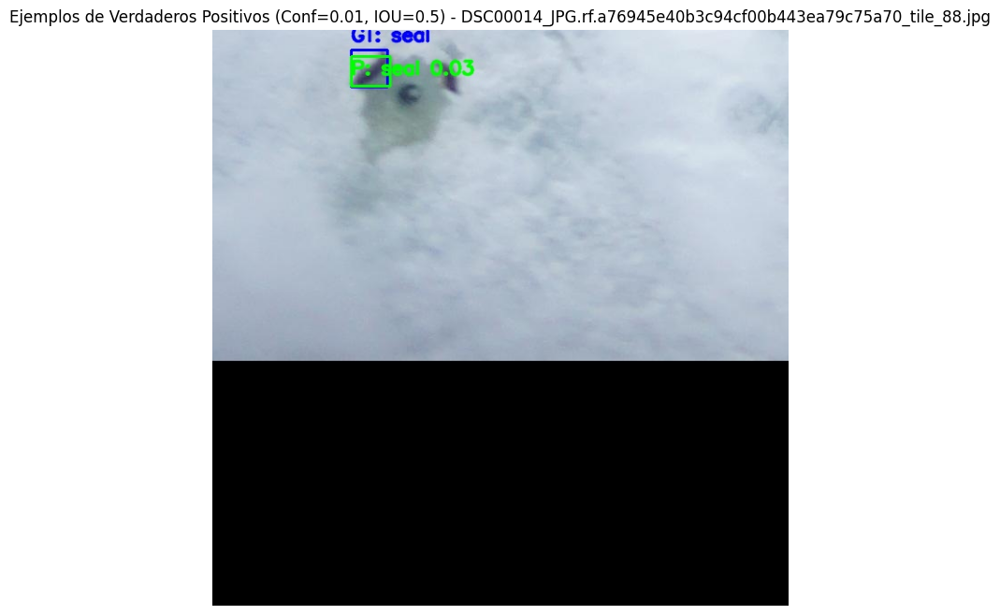

🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


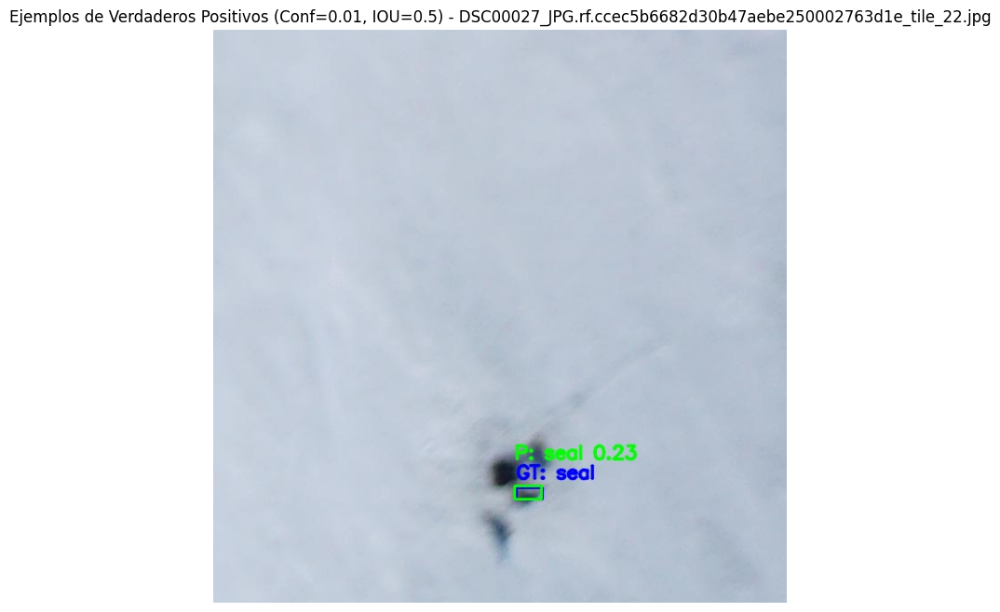


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.01, IOU=0.5)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


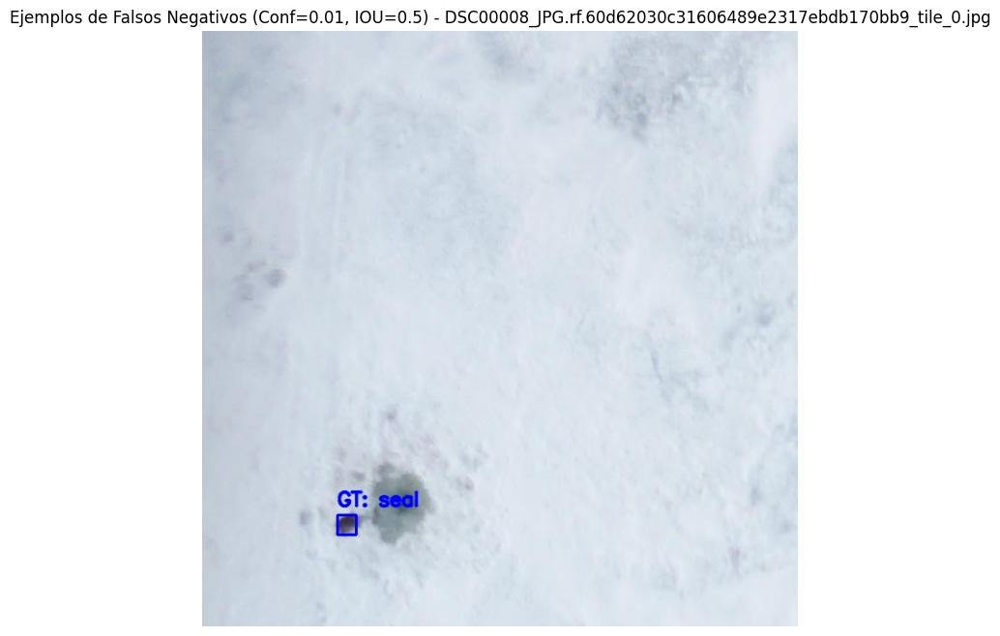

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


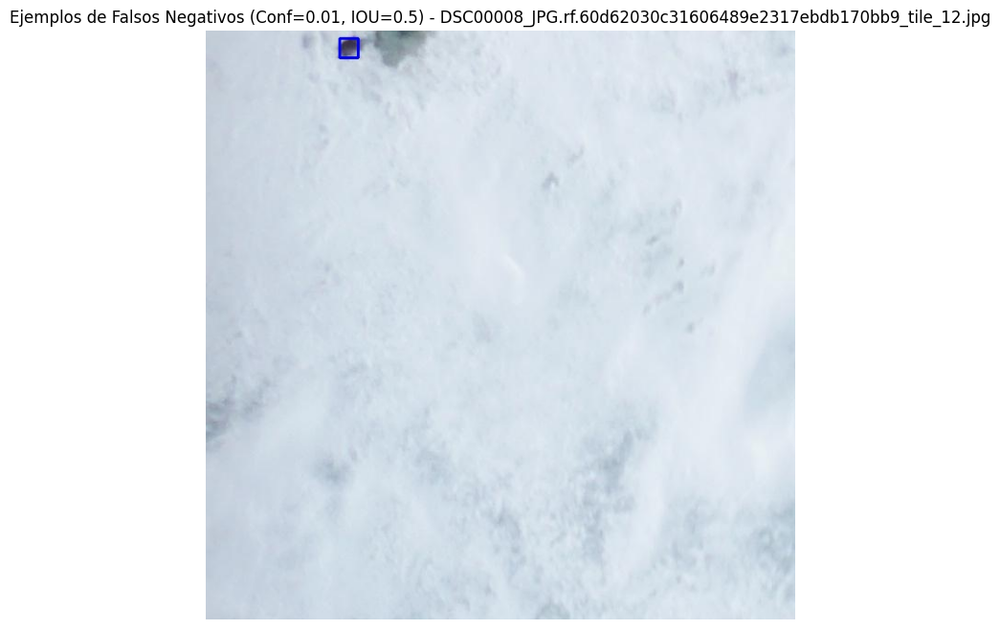

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_85.jpg


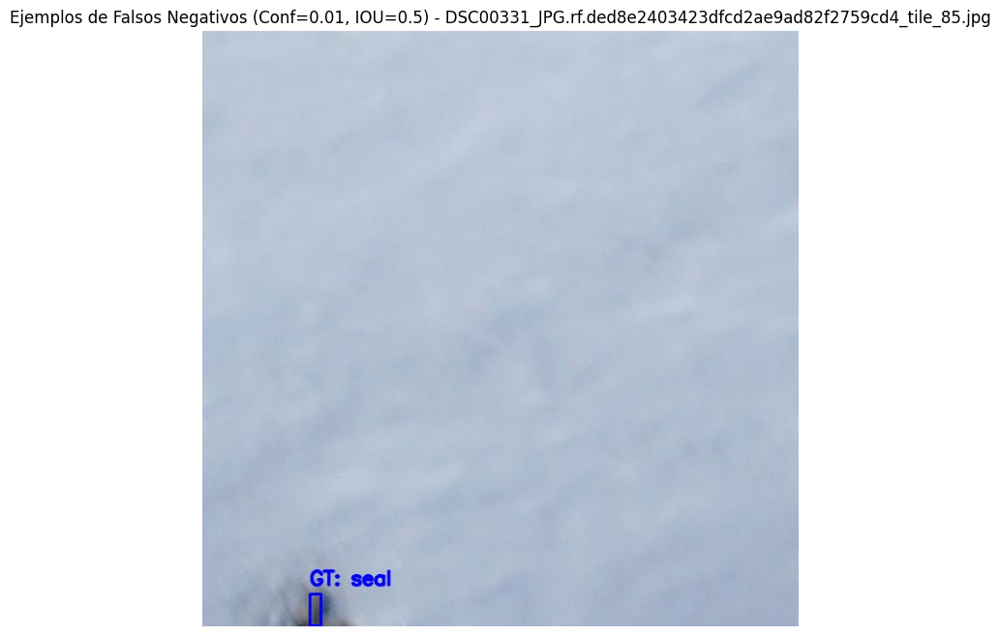


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.01, IOU=0.5)
🖼️ Mostrando: DSC00027_JPG.rf.ccec5b6682d30b47aebe250002763d1e_tile_22.jpg


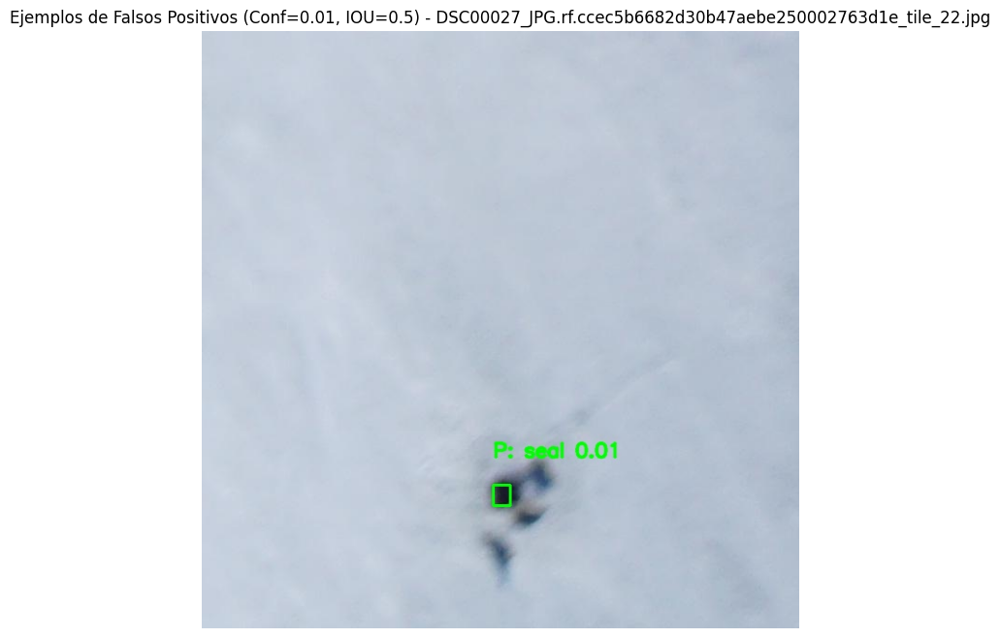

🖼️ Mostrando: DSC00304_JPG.rf.ad12f2268375f373b46df007a44c379f_tile_70.jpg


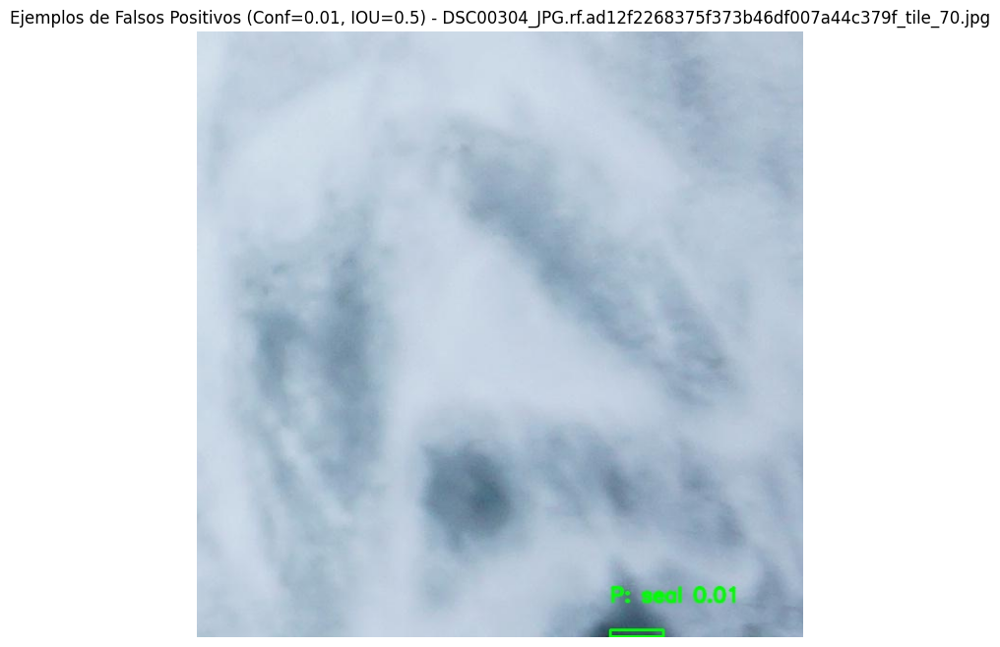

🖼️ Mostrando: DSC00313_JPG.rf.0defa291036b5e8b14daa6c9932b0e67_tile_87.jpg


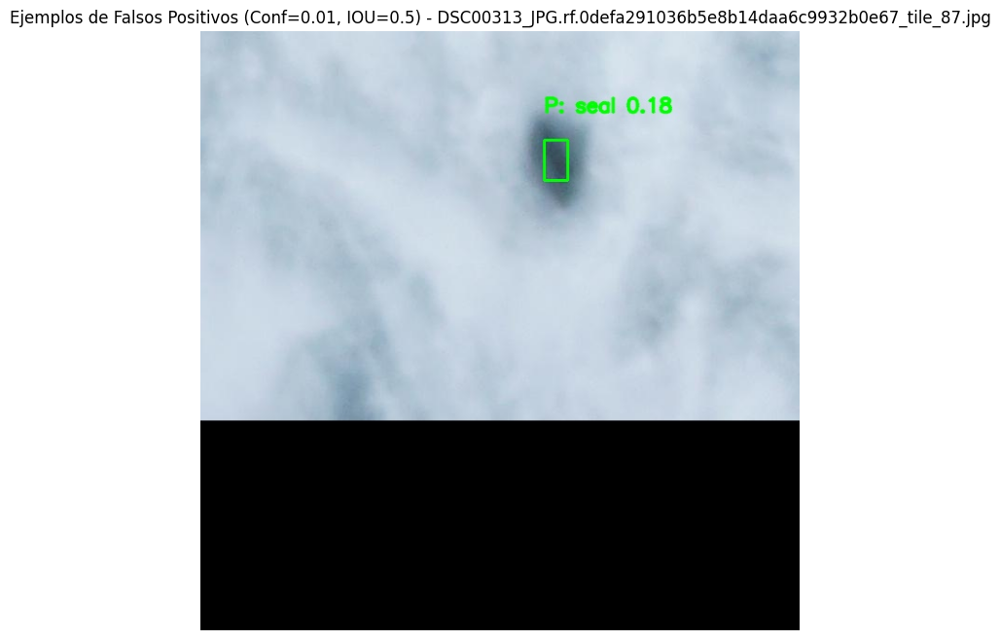


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf001_iou05/errores_por_instancia_conf001_iou05.csv

--- Generando curvas de rendimiento para Confianza=0.01, IOU=0.5 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou05/precision_recall_curve_iou05.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou05/f1_confidence_curve_iou05.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou05/precision_confidence_curve_iou05.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf001_iou05/recall_confidence_curve_iou05.png

--- Ejecutando Análisis para Confianza=0.1, IOU=0.3 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.1, IOU=0.3) ---
✔️ 

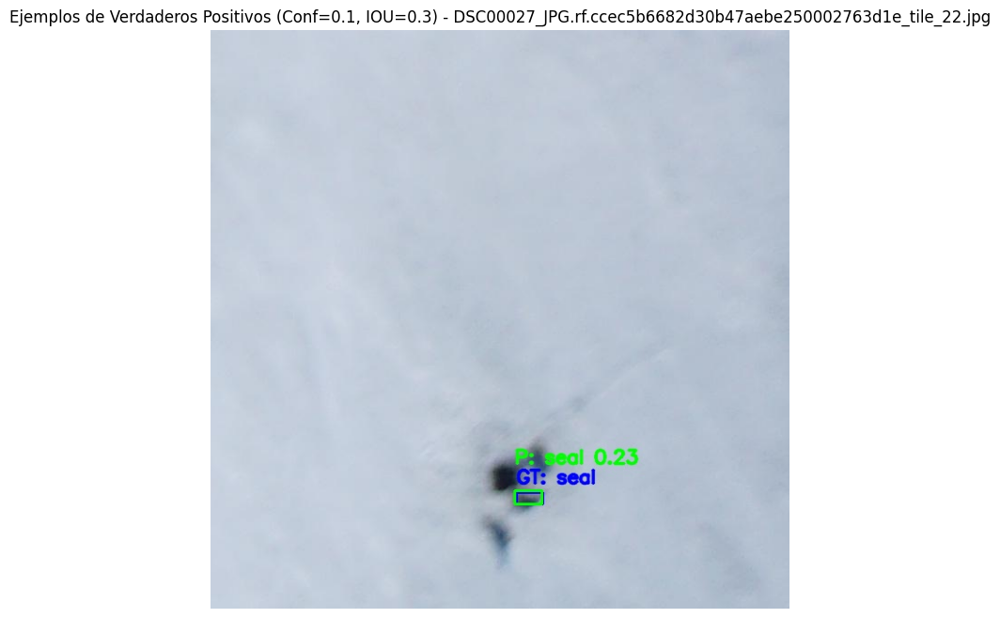

🖼️ Mostrando: DSC00241_JPG.rf.64722eeaed4f211c8bfb4be0a1778d5c_tile_64.jpg


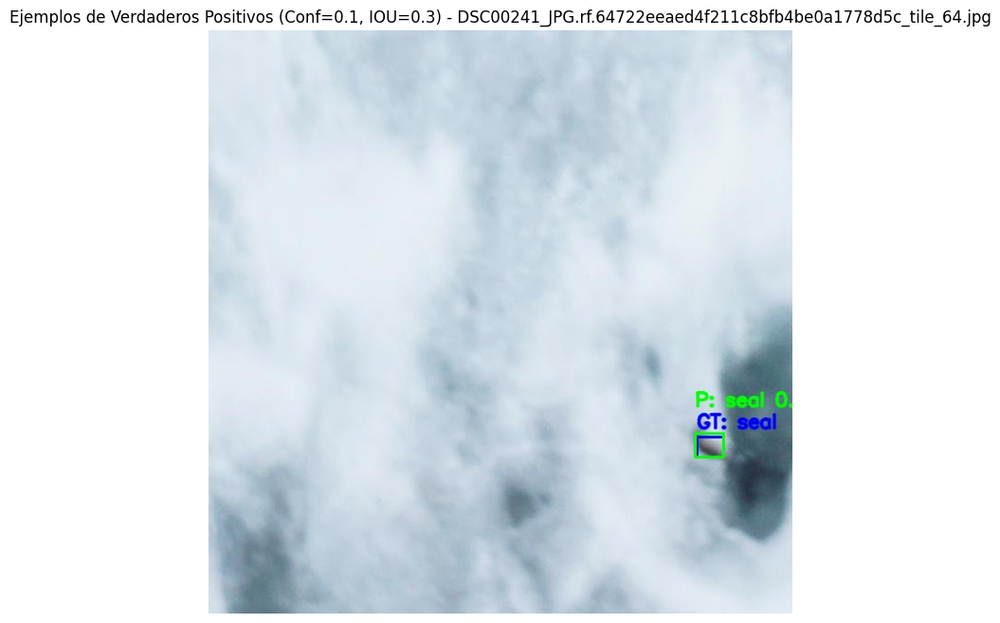

🖼️ Mostrando: DSC00241_JPG.rf.64722eeaed4f211c8bfb4be0a1778d5c_tile_65.jpg


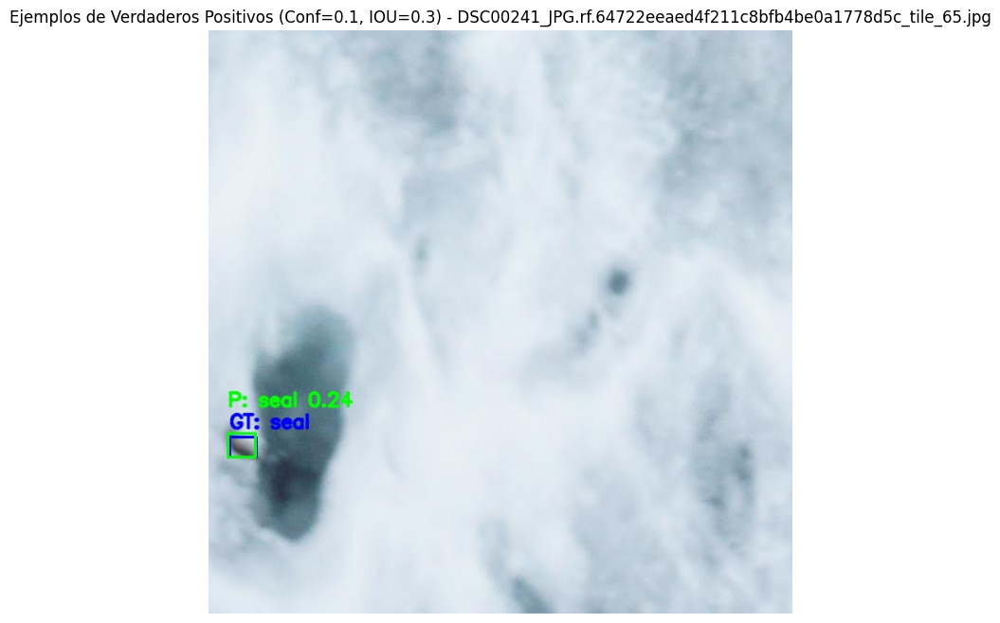


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.1, IOU=0.3)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


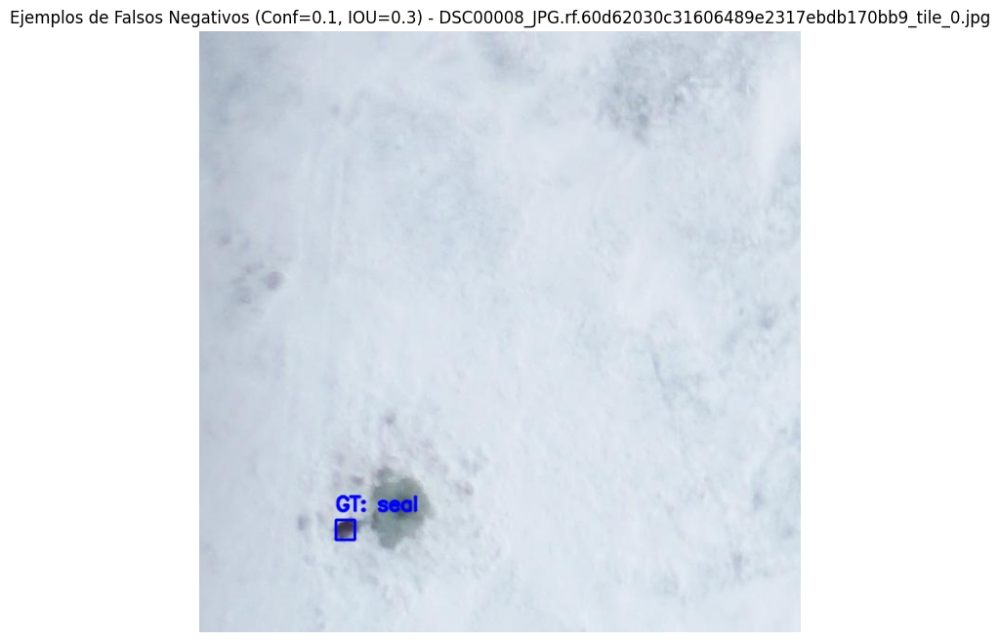

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


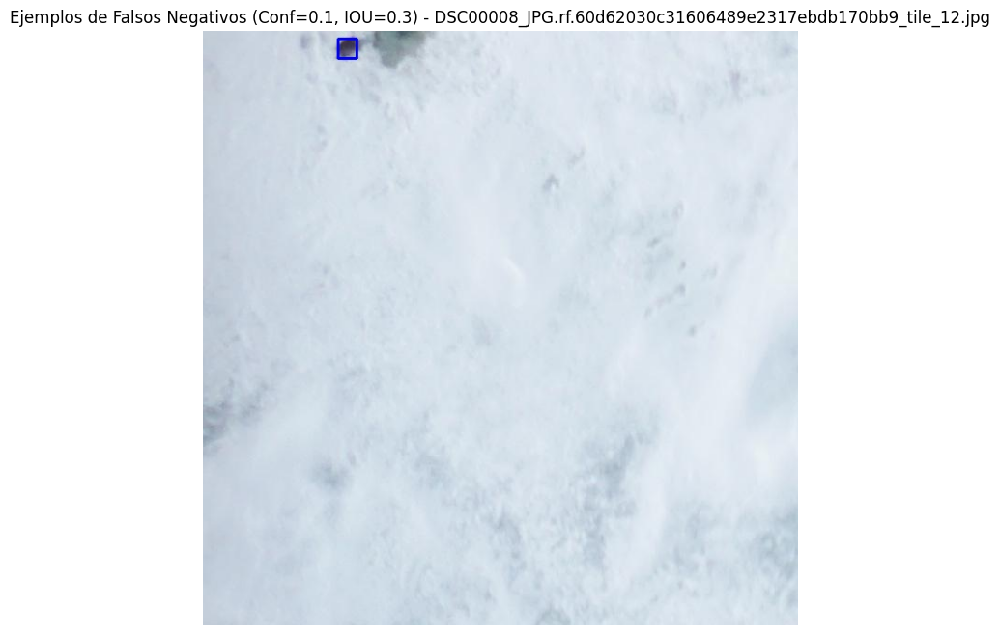

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_80.jpg


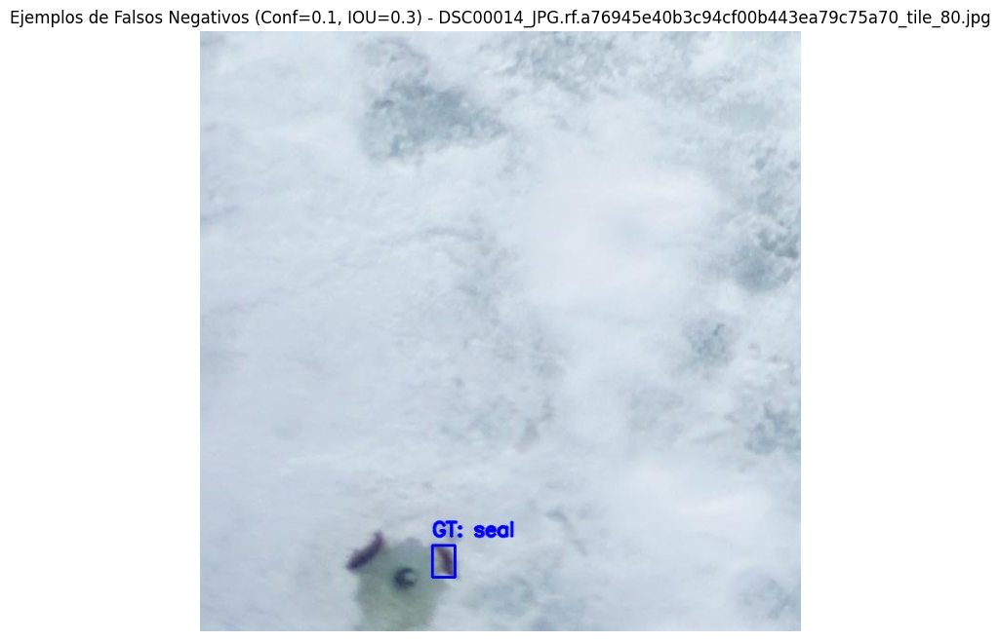


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.1, IOU=0.3)
🖼️ Mostrando: DSC00313_JPG.rf.0defa291036b5e8b14daa6c9932b0e67_tile_87.jpg


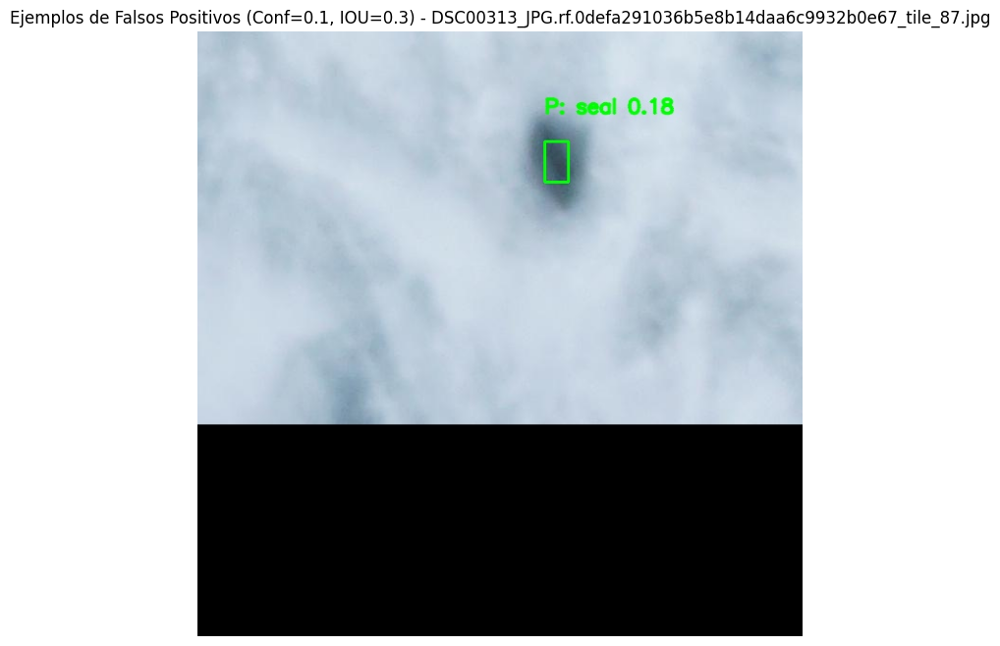

🖼️ Mostrando: DSC00736_JPG.rf.6cc8a7d0f2708471d9cc8598ffb7868a_tile_63.jpg


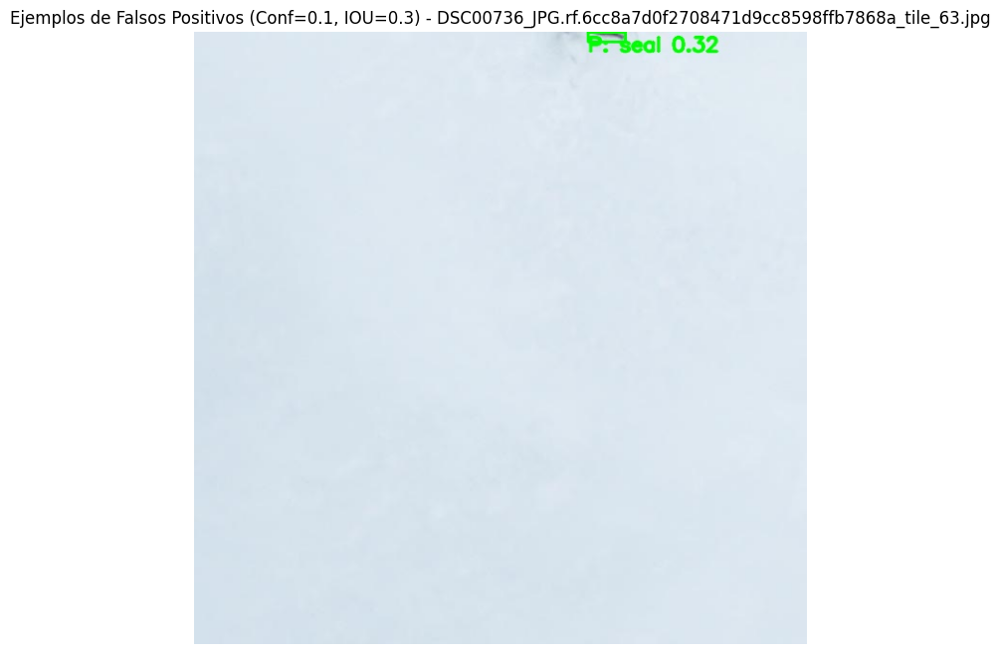

🖼️ Mostrando: DSC05302_JPG.rf.93f951a74b4cb8940b00e607329e8632_tile_85.jpg


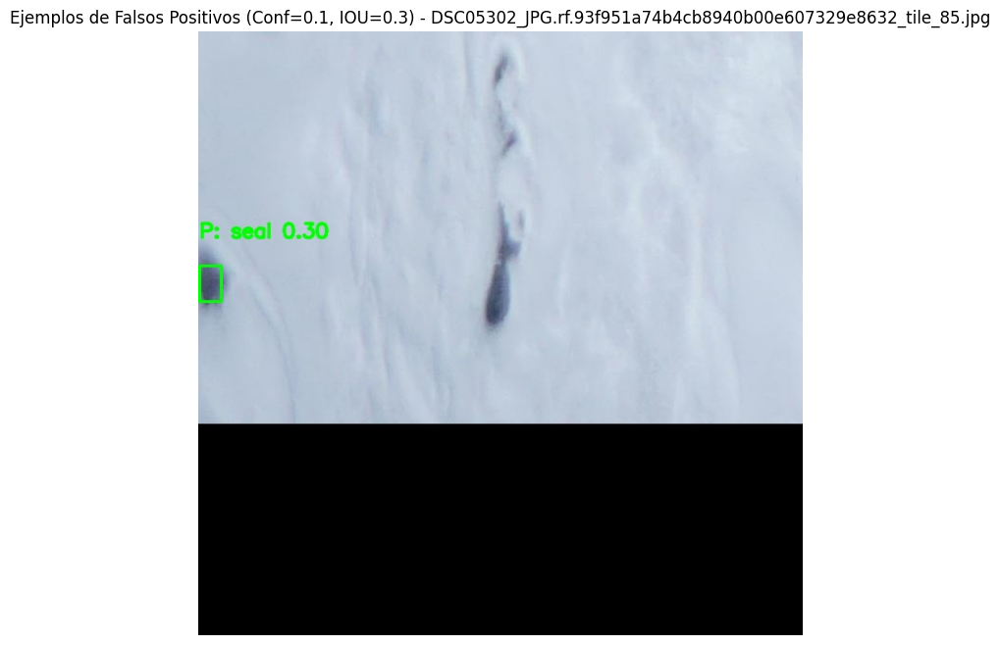


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf01_iou03/errores_por_instancia_conf01_iou03.csv

--- Generando curvas de rendimiento para Confianza=0.1, IOU=0.3 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou03/precision_recall_curve_iou03.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou03/f1_confidence_curve_iou03.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou03/precision_confidence_curve_iou03.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou03/recall_confidence_curve_iou03.png

--- Ejecutando Análisis para Confianza=0.1, IOU=0.5 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.1, IOU=0.5) ---
✔️ Verdade

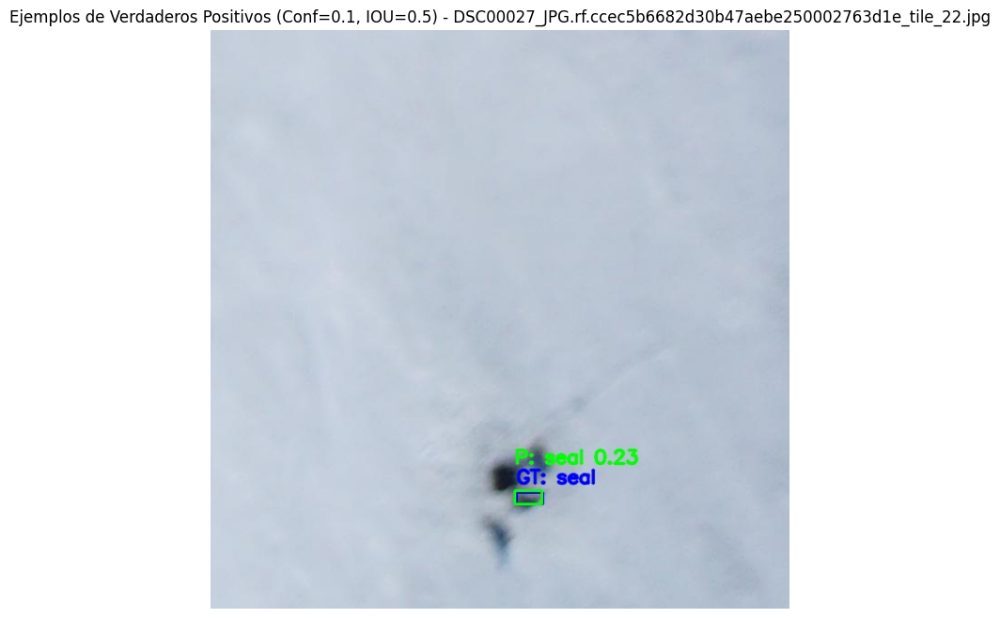

🖼️ Mostrando: DSC00241_JPG.rf.64722eeaed4f211c8bfb4be0a1778d5c_tile_64.jpg


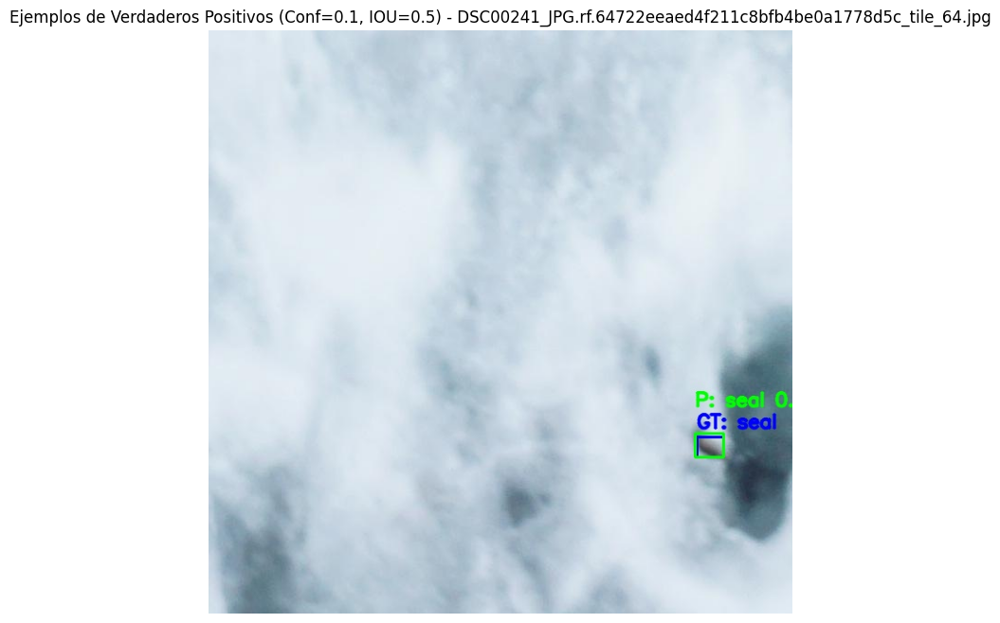

🖼️ Mostrando: DSC00241_JPG.rf.64722eeaed4f211c8bfb4be0a1778d5c_tile_65.jpg


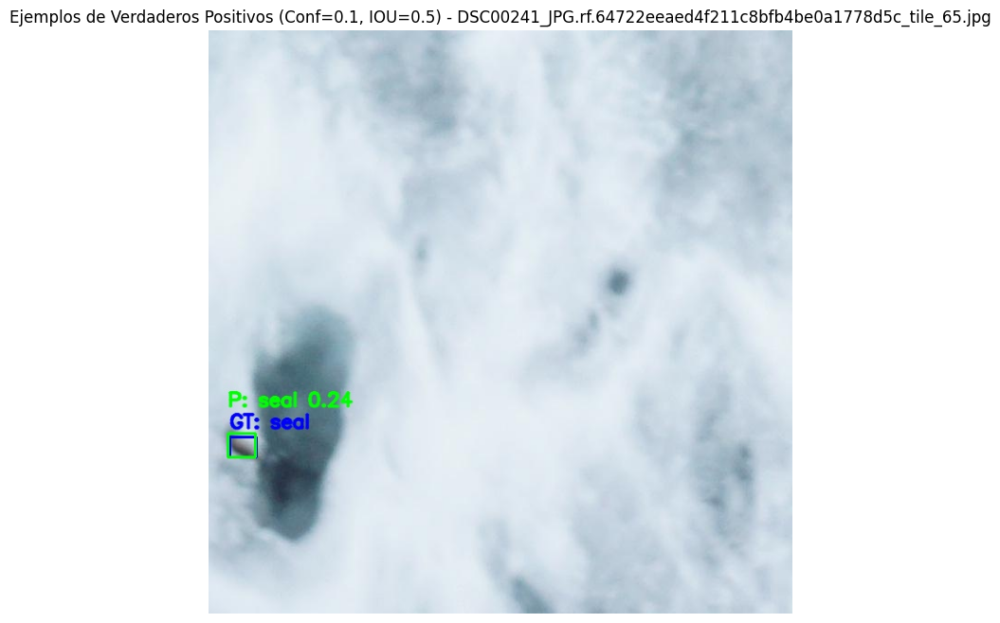


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.1, IOU=0.5)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


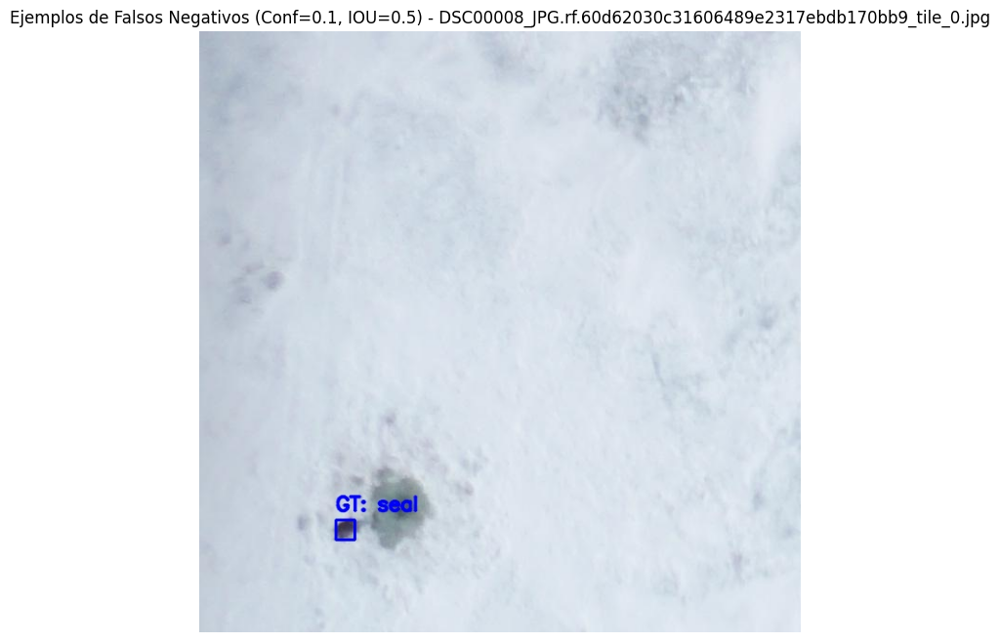

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


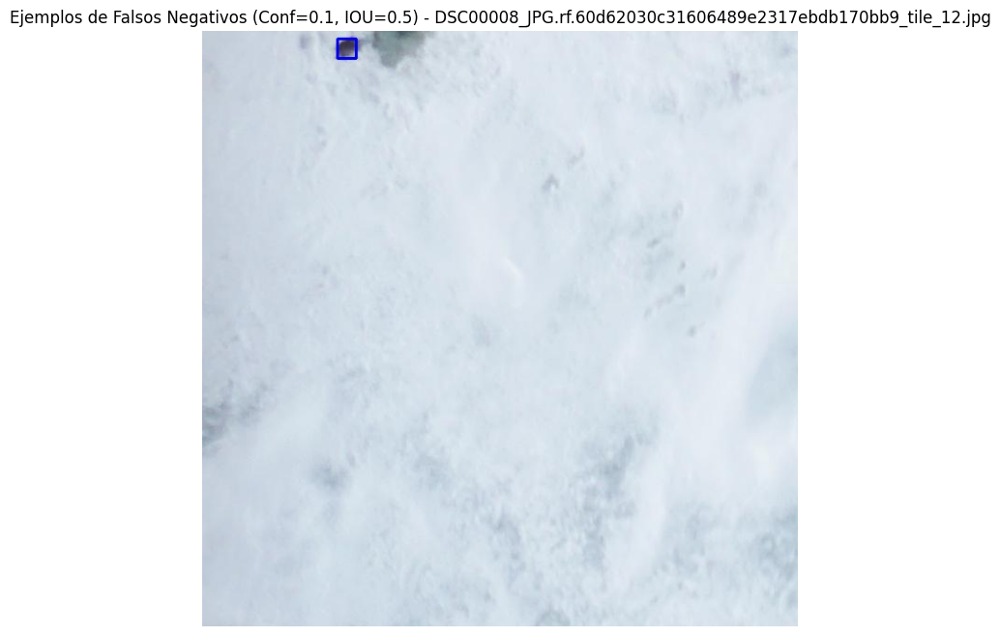

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_80.jpg


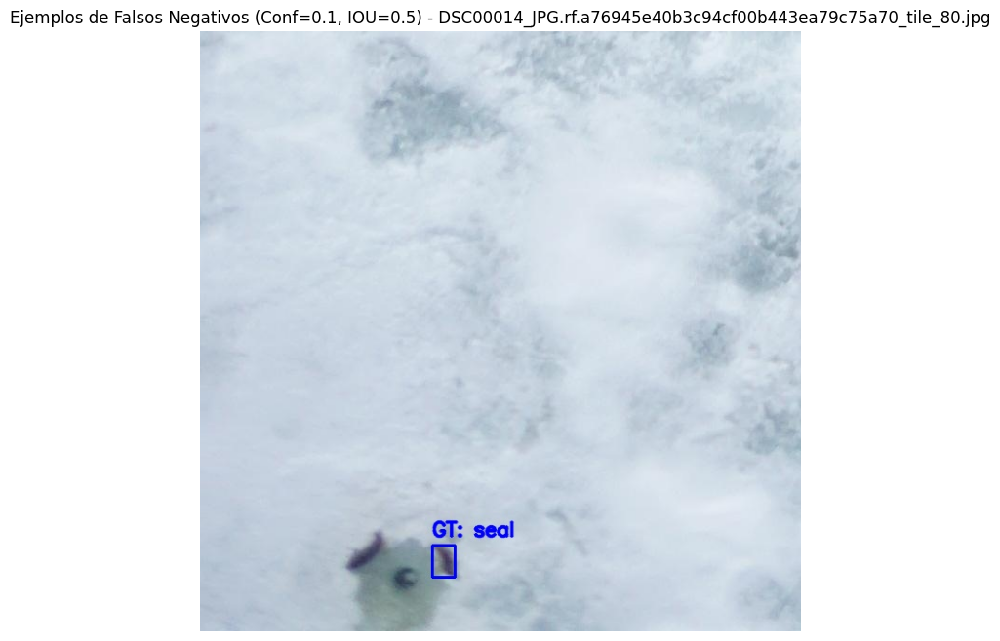


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.1, IOU=0.5)
🖼️ Mostrando: DSC00313_JPG.rf.0defa291036b5e8b14daa6c9932b0e67_tile_87.jpg


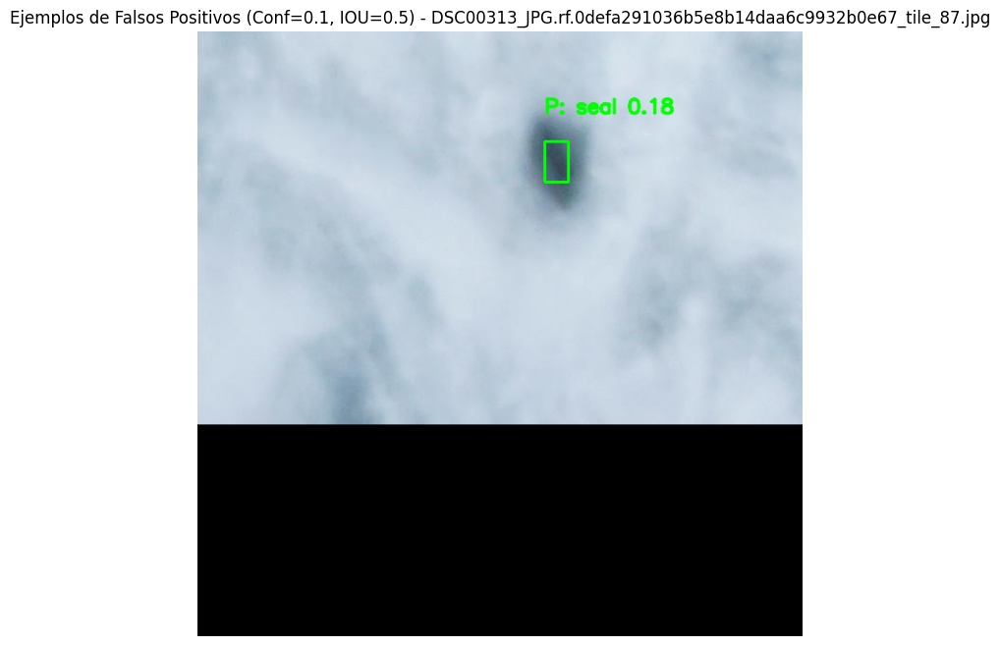

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_85.jpg


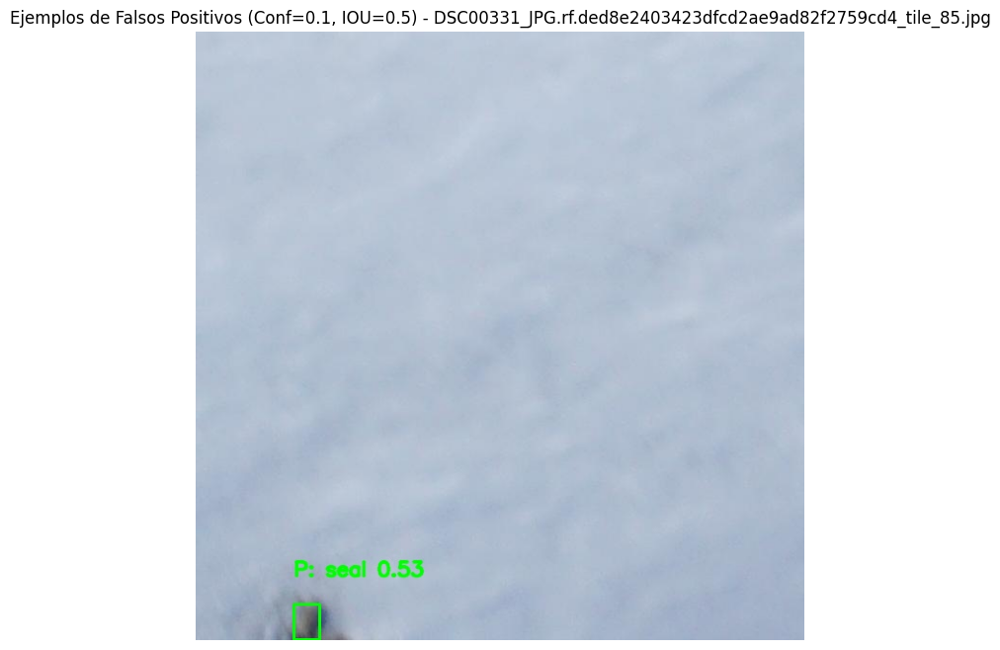

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_93.jpg


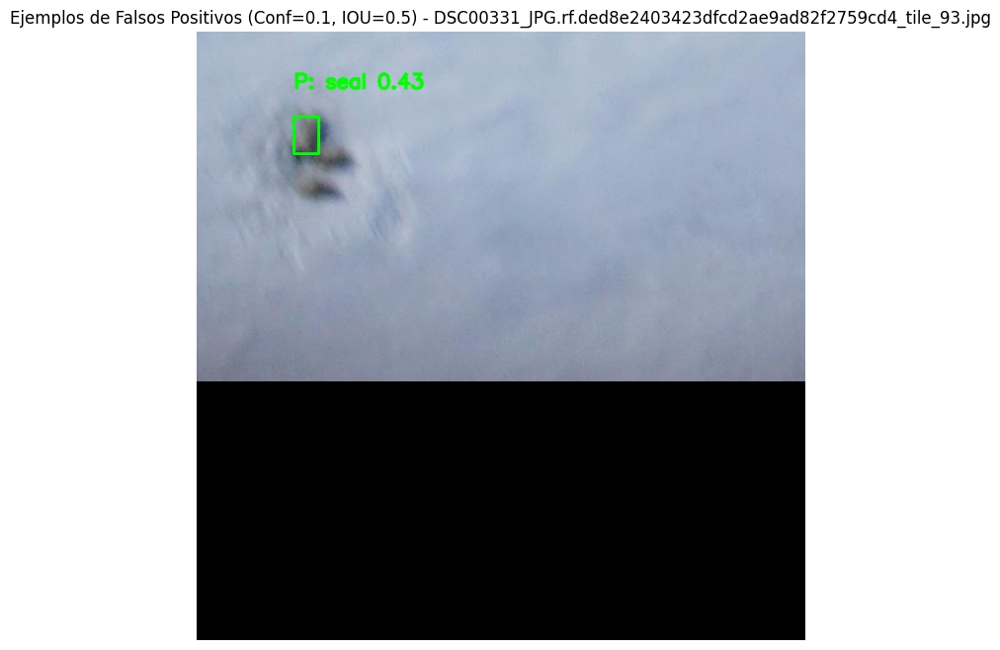


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf01_iou05/errores_por_instancia_conf01_iou05.csv

--- Generando curvas de rendimiento para Confianza=0.1, IOU=0.5 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou05/precision_recall_curve_iou05.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou05/f1_confidence_curve_iou05.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou05/precision_confidence_curve_iou05.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf01_iou05/recall_confidence_curve_iou05.png

--- Ejecutando Análisis para Confianza=0.25, IOU=0.3 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.25, IOU=0.3) ---
✔️ Verda

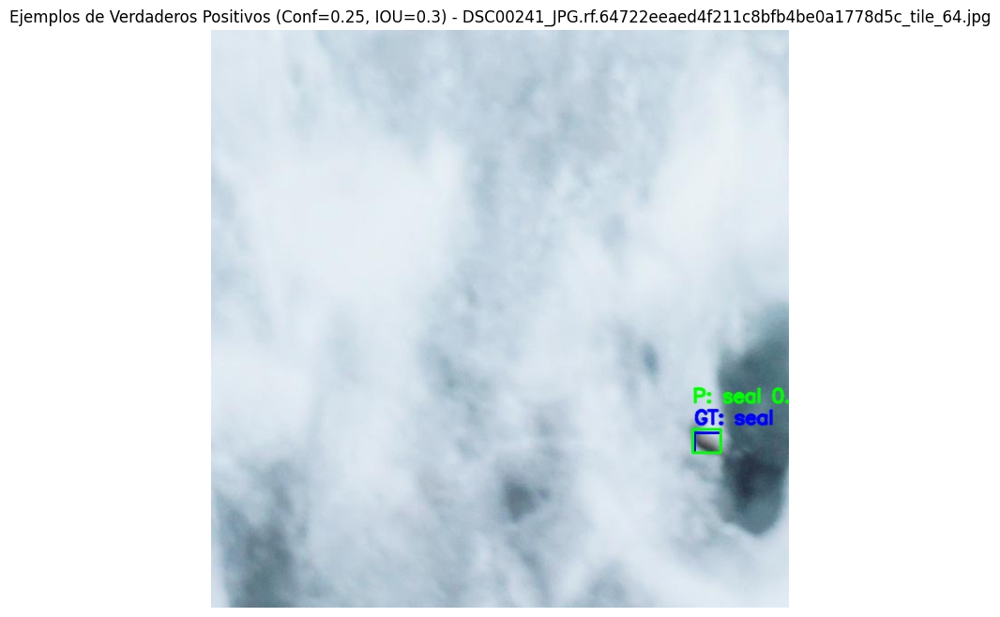

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_18.jpg


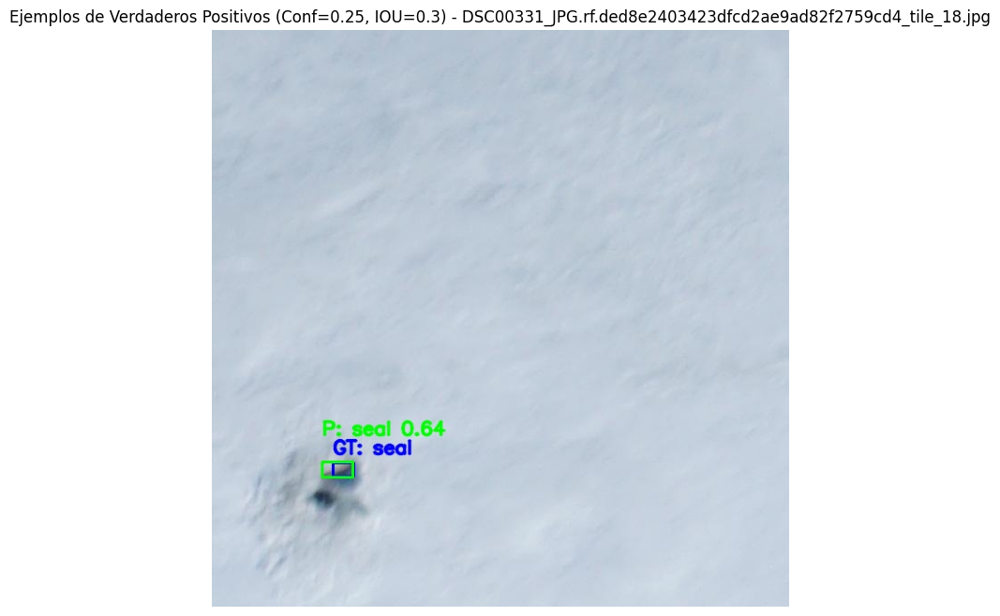

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_85.jpg


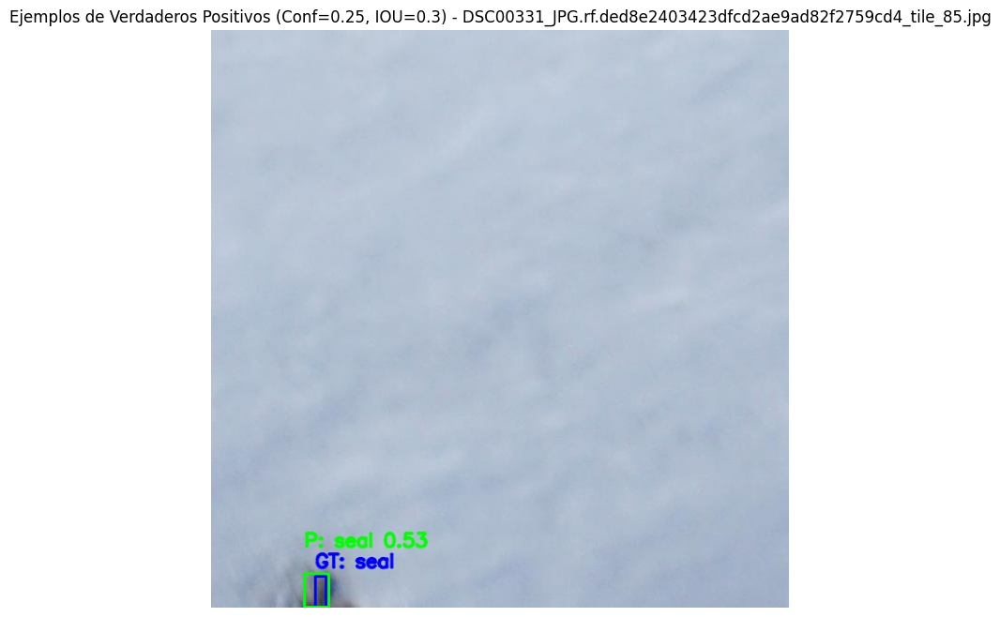


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.25, IOU=0.3)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


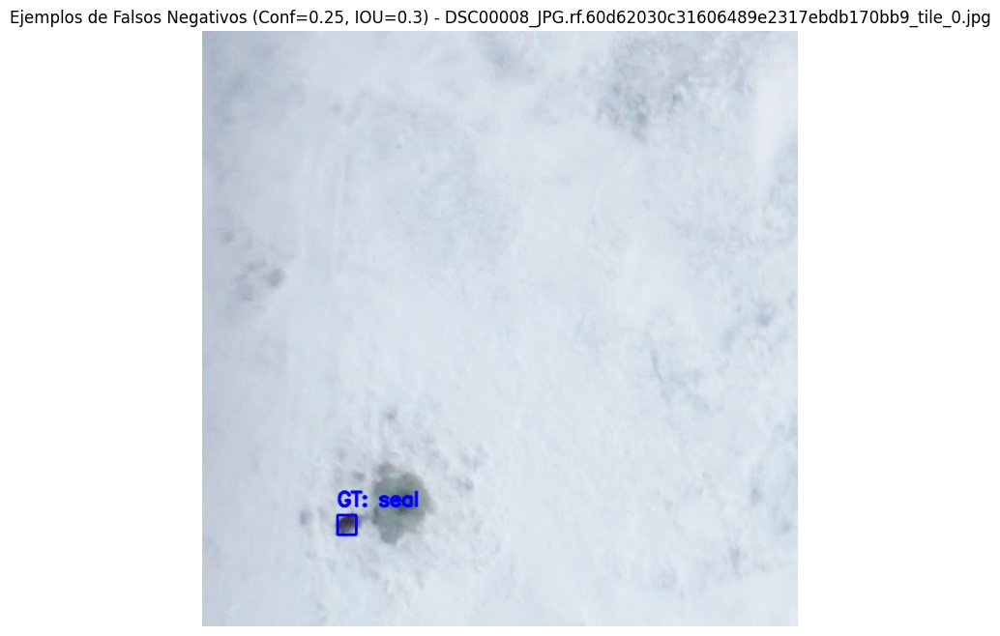

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


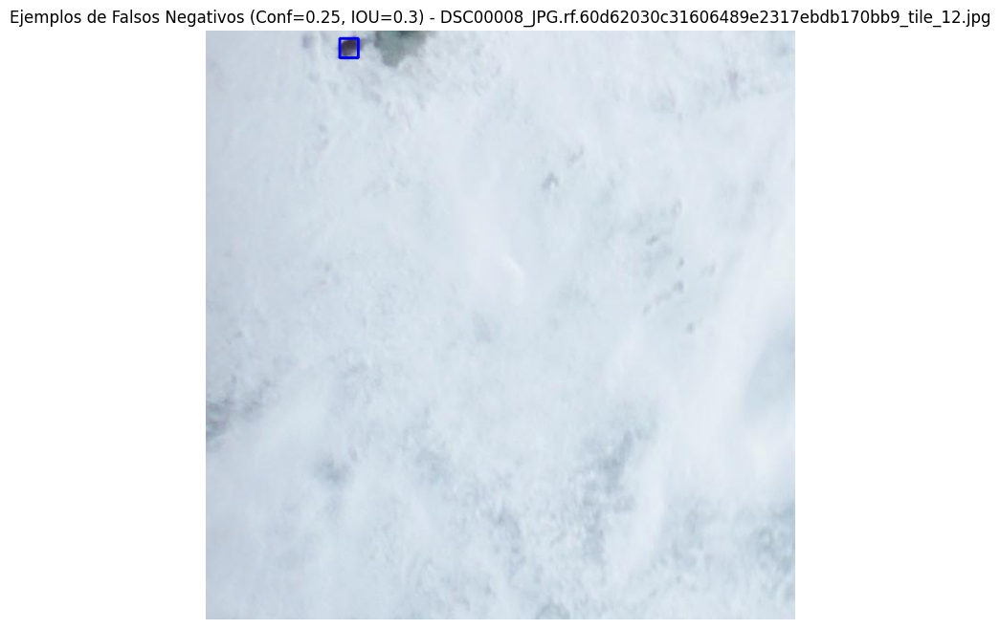

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_80.jpg


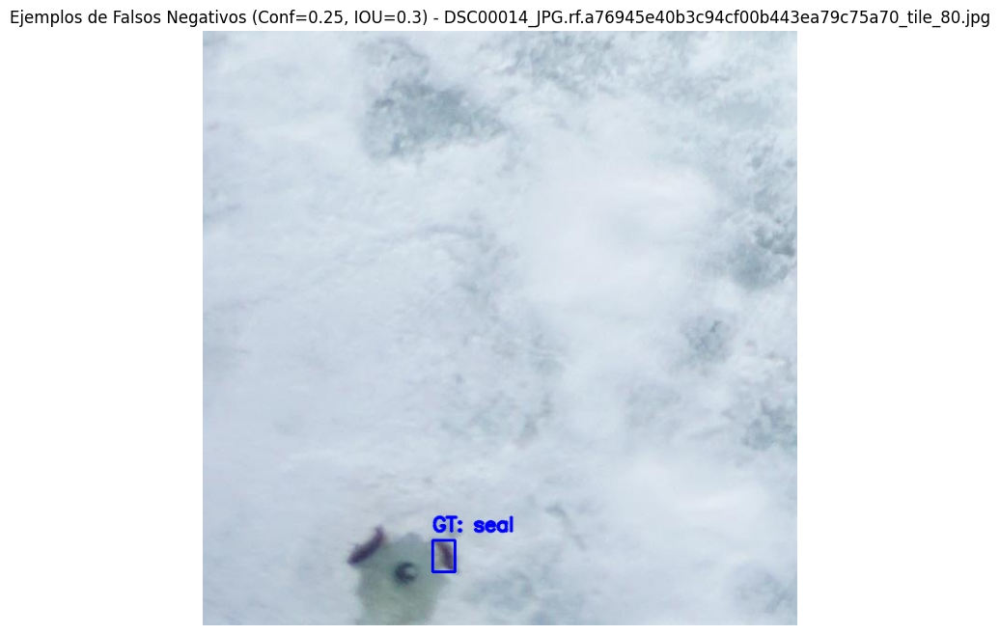


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.25, IOU=0.3)
🖼️ Mostrando: DSC00736_JPG.rf.6cc8a7d0f2708471d9cc8598ffb7868a_tile_63.jpg


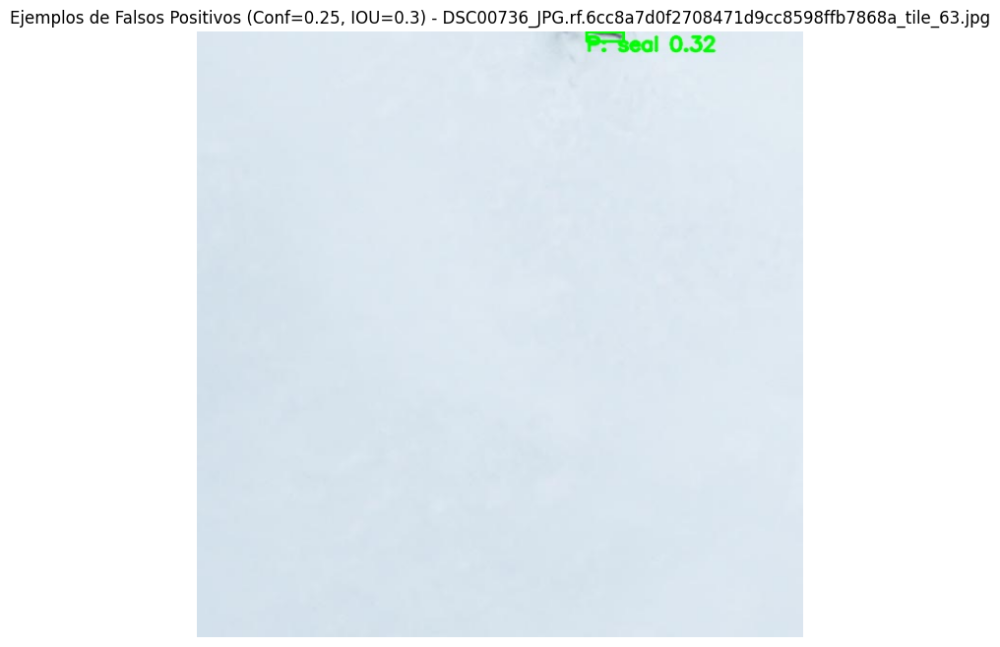

🖼️ Mostrando: DSC05302_JPG.rf.93f951a74b4cb8940b00e607329e8632_tile_85.jpg


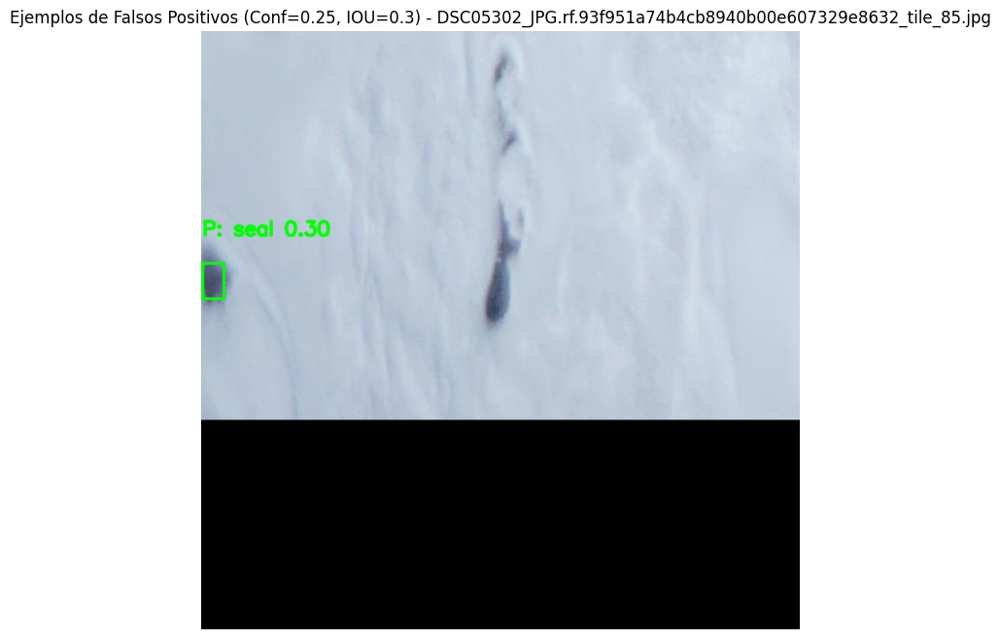

🖼️ Mostrando: DSC07582_JPG.rf.f2e6e3e2ca5da0a67a2dbc64e4314b1f_tile_24.jpg


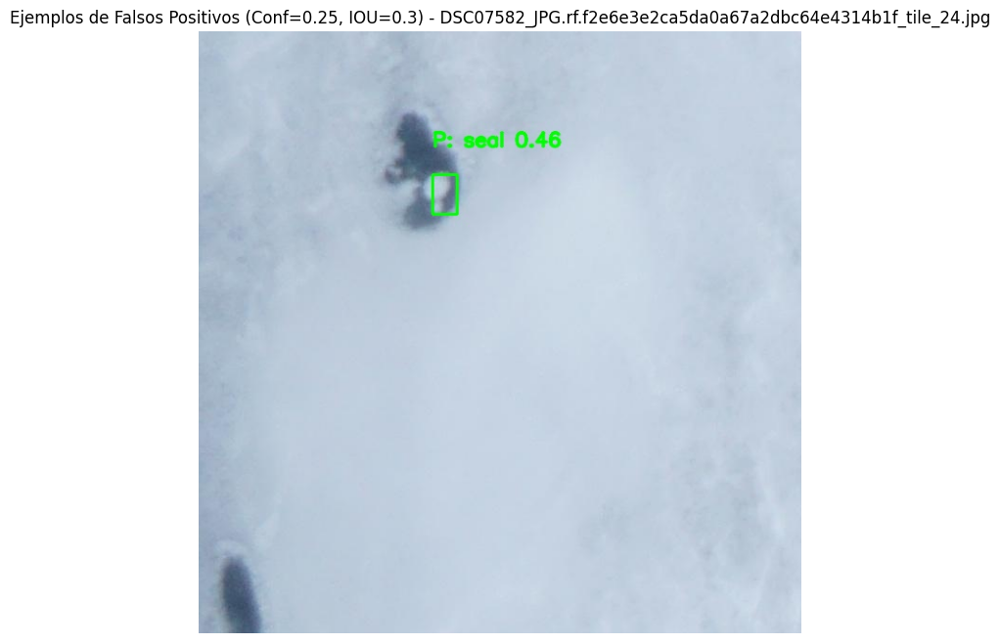


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf025_iou03/errores_por_instancia_conf025_iou03.csv

--- Generando curvas de rendimiento para Confianza=0.25, IOU=0.3 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou03/precision_recall_curve_iou03.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou03/f1_confidence_curve_iou03.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou03/precision_confidence_curve_iou03.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou03/recall_confidence_curve_iou03.png

--- Ejecutando Análisis para Confianza=0.25, IOU=0.5 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.25, IOU=0.5) ---
✔

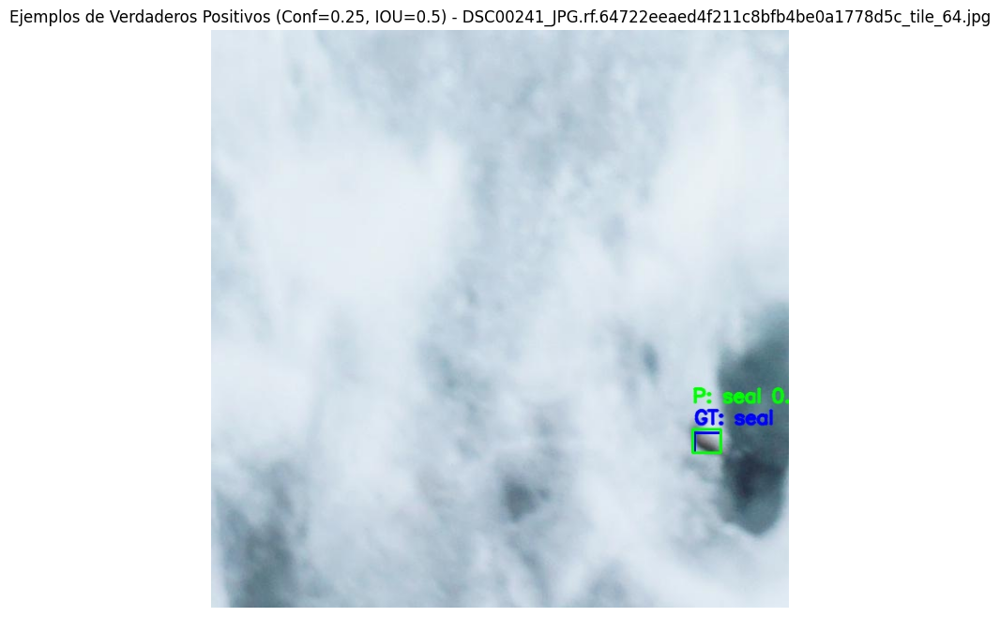

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_18.jpg


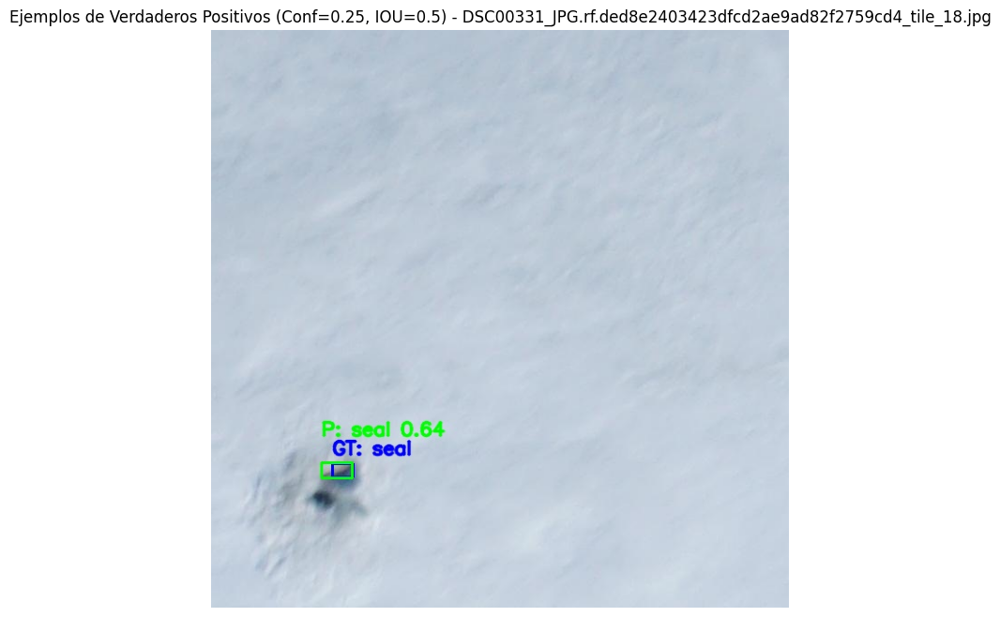

🖼️ Mostrando: DSC00736_JPG.rf.6cc8a7d0f2708471d9cc8598ffb7868a_tile_51.jpg


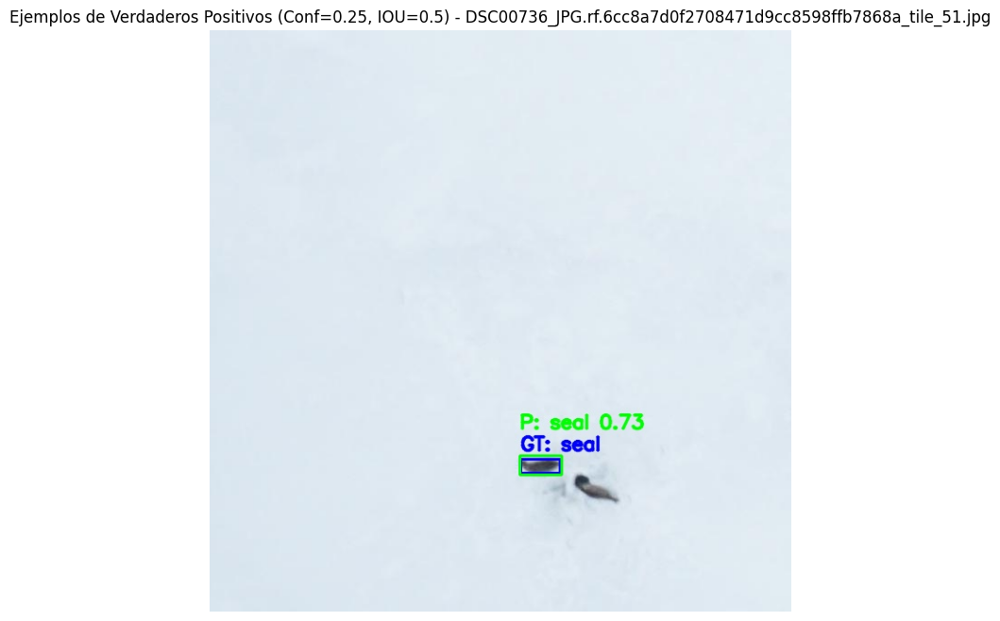


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.25, IOU=0.5)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


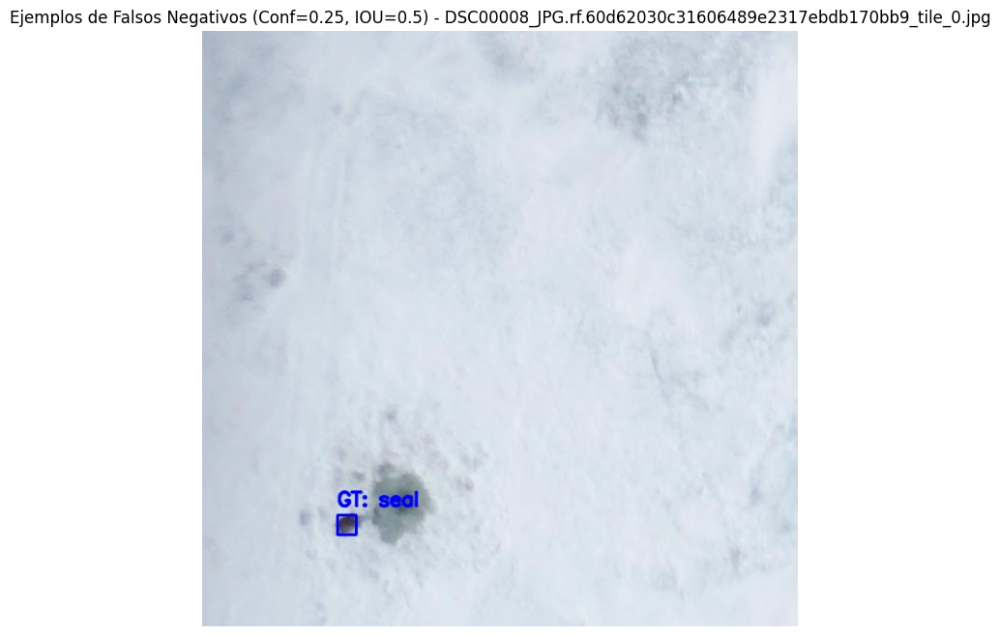

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


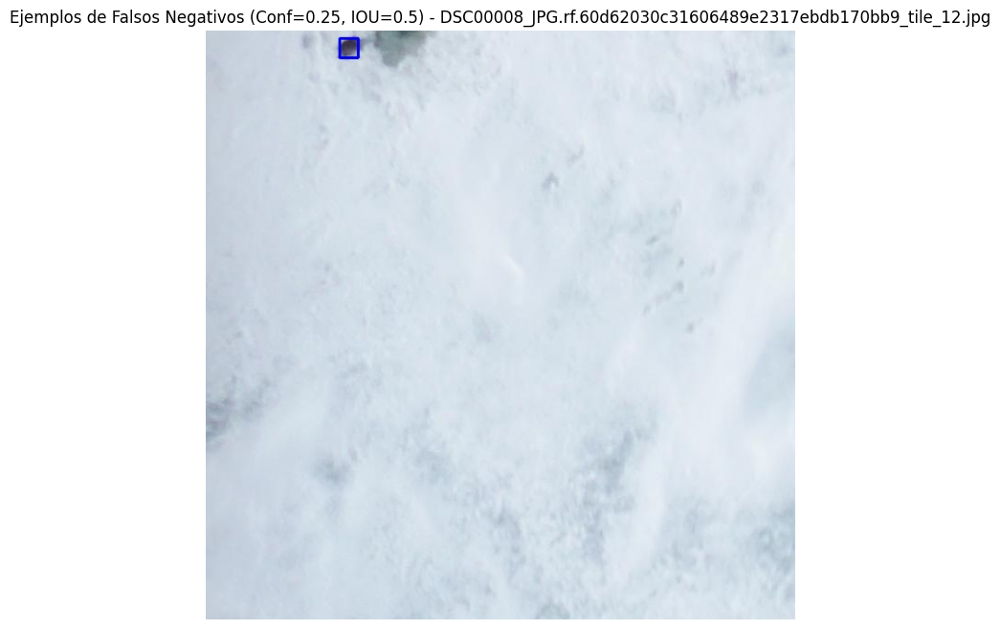

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_80.jpg


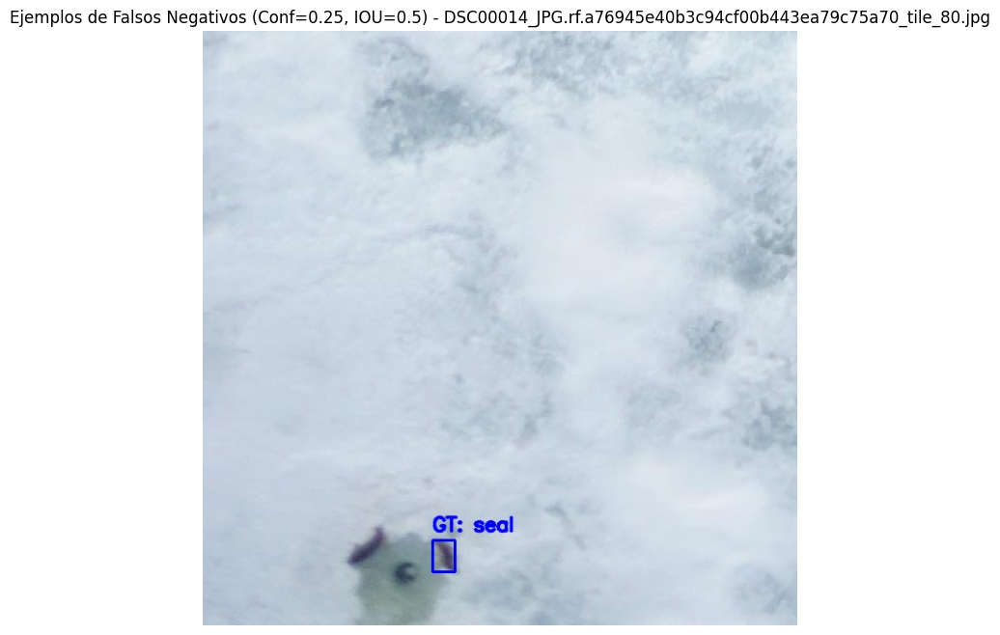


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.25, IOU=0.5)
🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_85.jpg


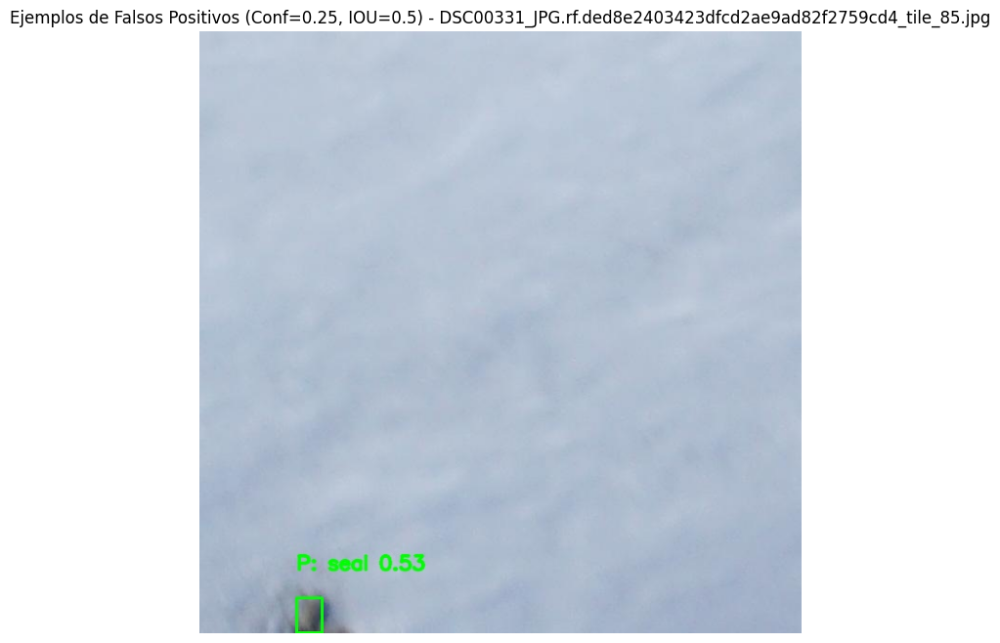

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_93.jpg


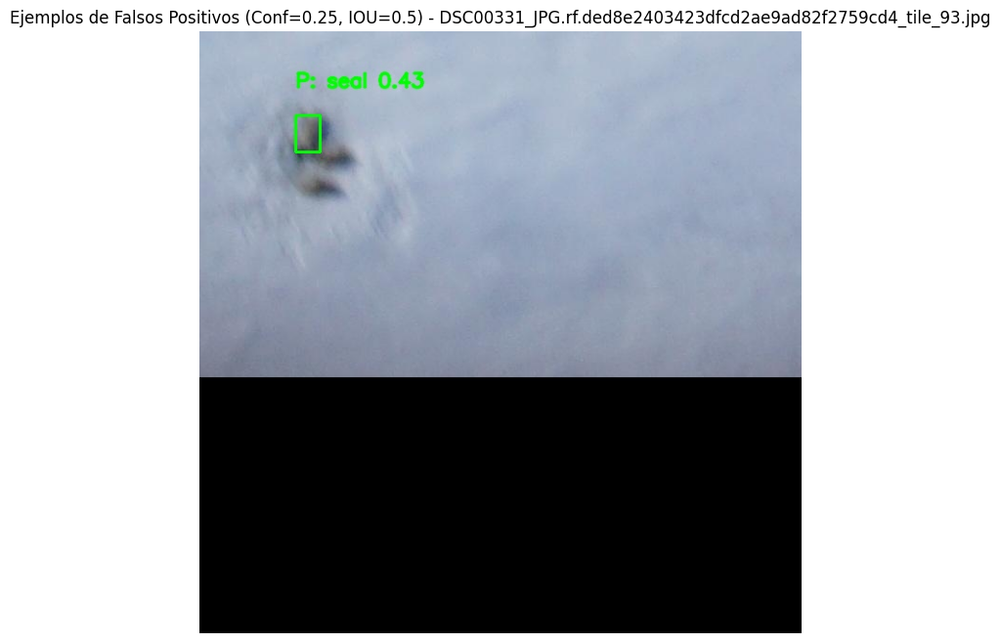

🖼️ Mostrando: DSC00736_JPG.rf.6cc8a7d0f2708471d9cc8598ffb7868a_tile_63.jpg


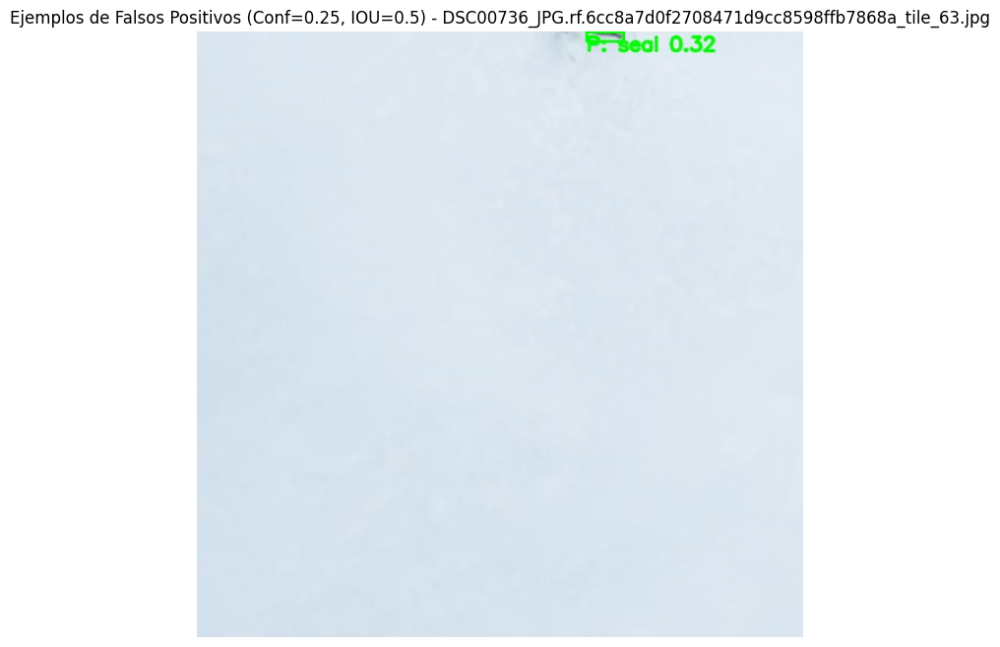


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf025_iou05/errores_por_instancia_conf025_iou05.csv

--- Generando curvas de rendimiento para Confianza=0.25, IOU=0.5 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou05/precision_recall_curve_iou05.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou05/f1_confidence_curve_iou05.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou05/precision_confidence_curve_iou05.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf025_iou05/recall_confidence_curve_iou05.png

--- Ejecutando Análisis para Confianza=0.5, IOU=0.3 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.5, IOU=0.3) ---
✔️ 

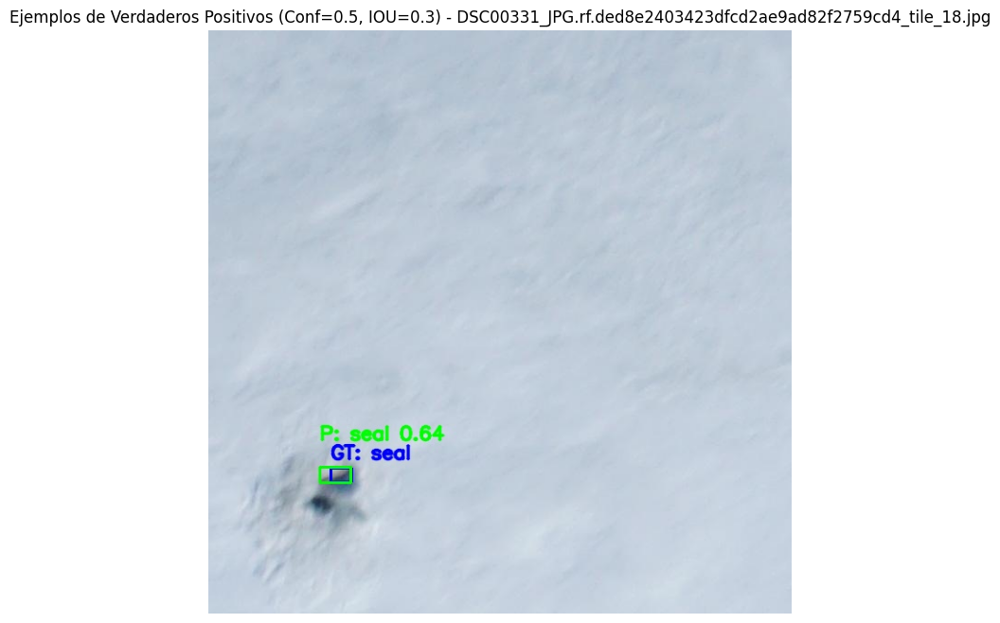

🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_85.jpg


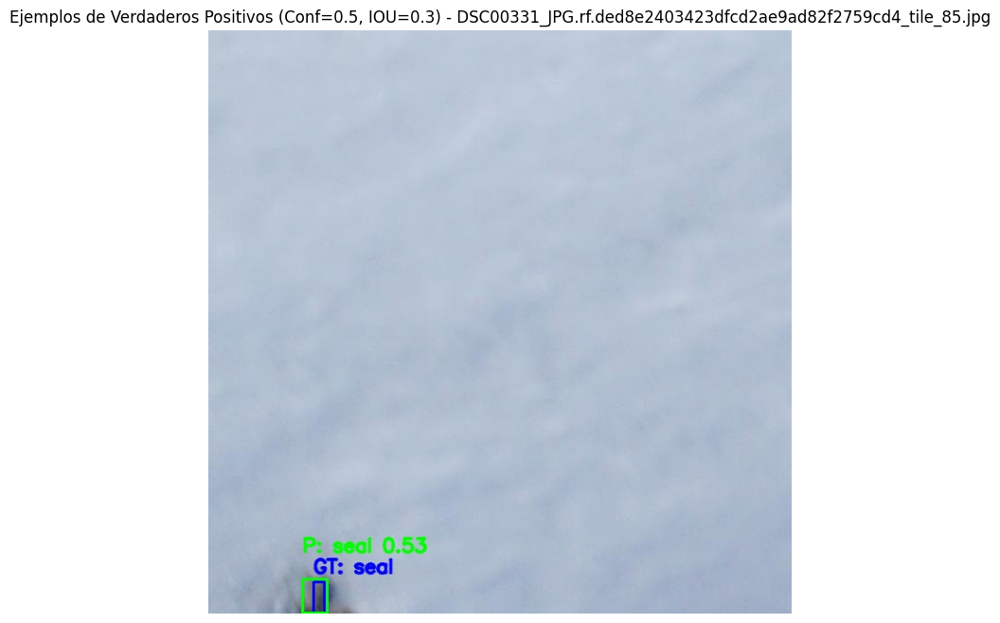

🖼️ Mostrando: DSC00736_JPG.rf.6cc8a7d0f2708471d9cc8598ffb7868a_tile_51.jpg


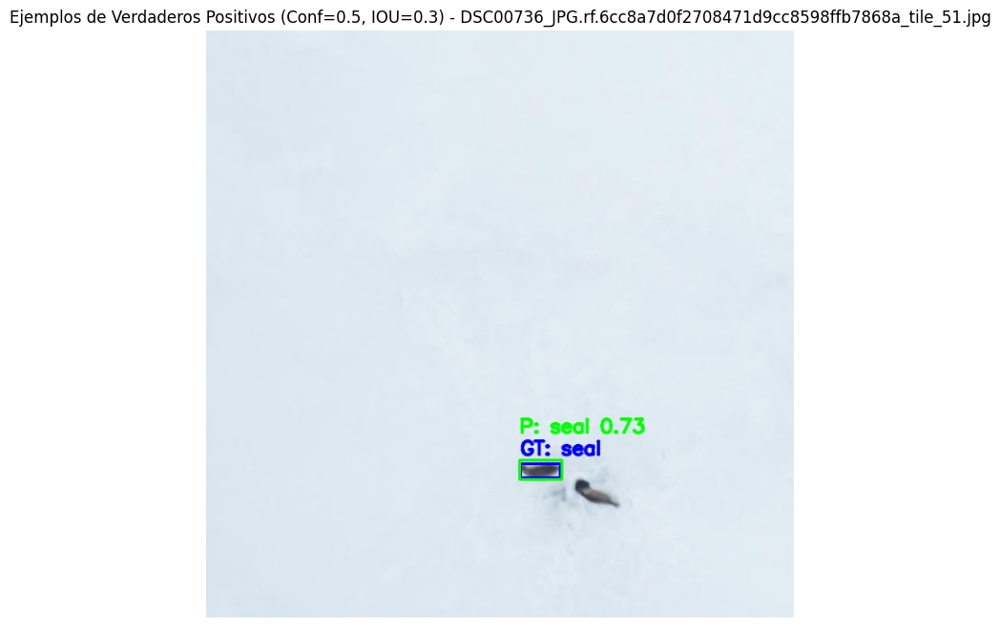


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.5, IOU=0.3)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


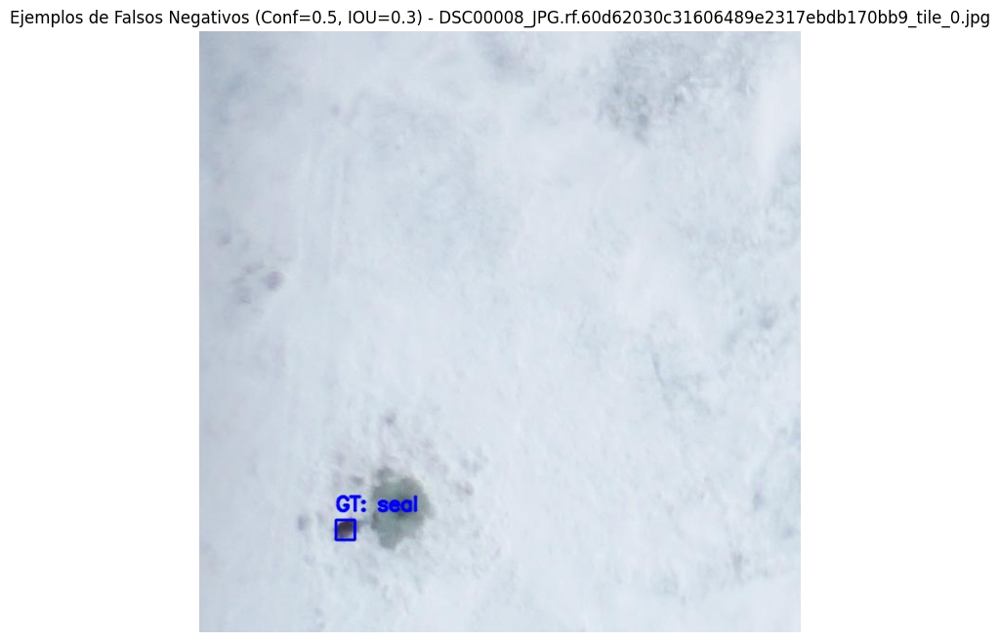

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


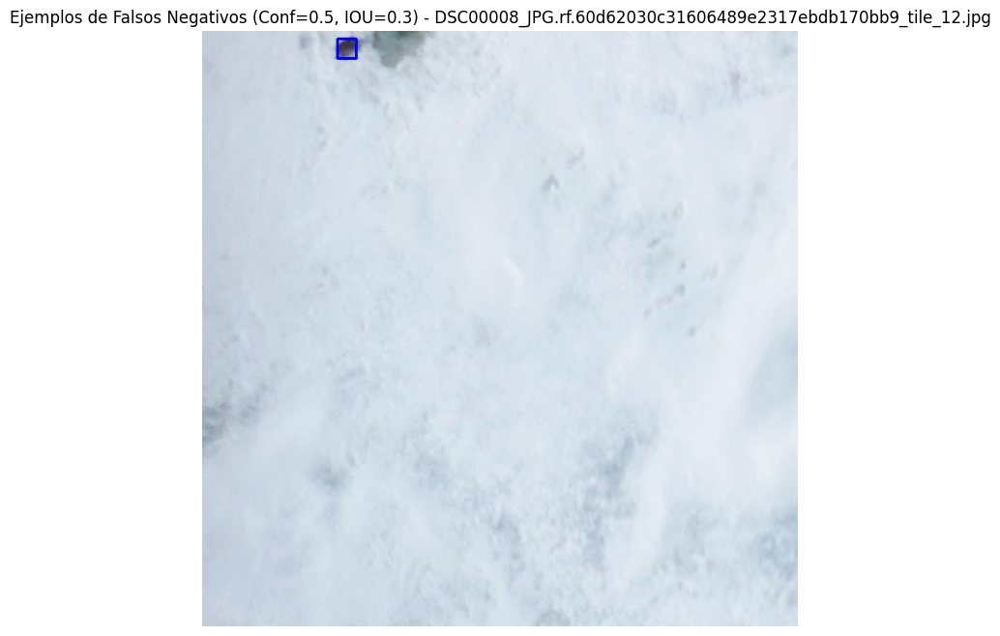

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_80.jpg


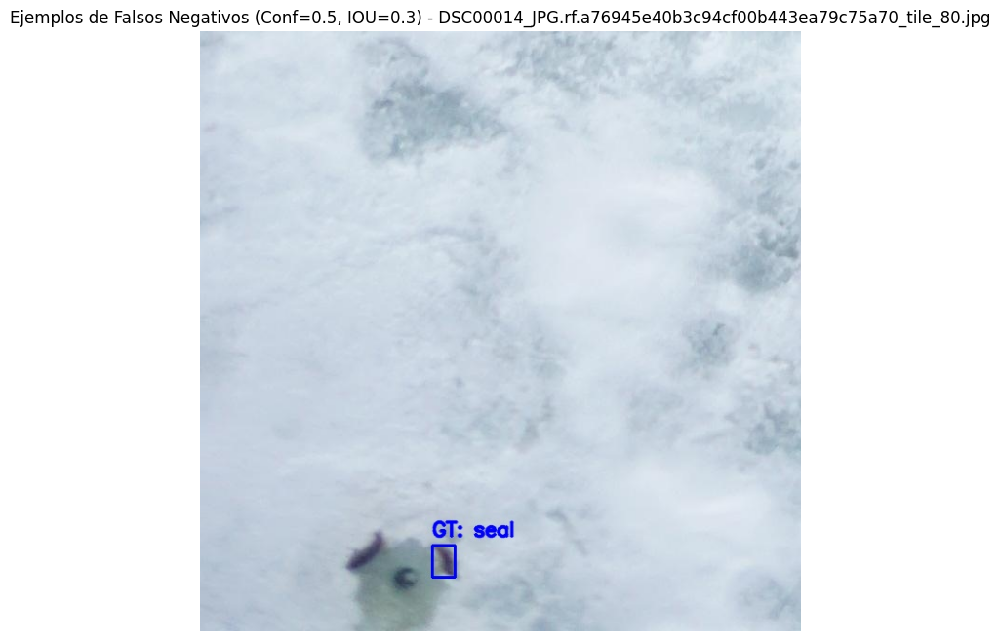


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.5, IOU=0.3)
🖼️ Mostrando: DSC09763_JPG.rf.0f59f3cd919b4143713a906960d7dace_tile_52.jpg


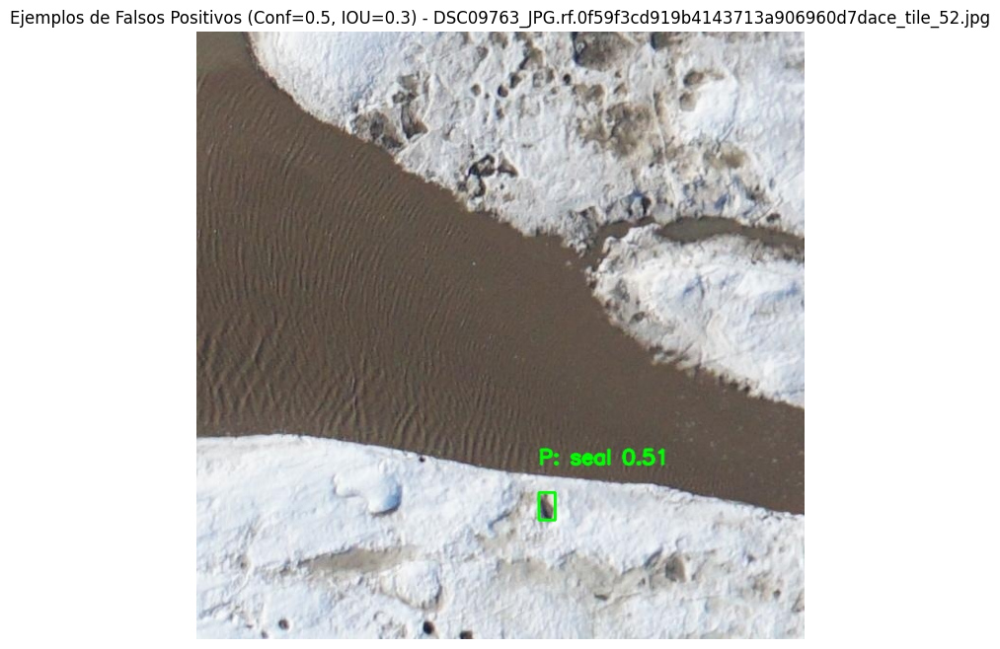


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf05_iou03/errores_por_instancia_conf05_iou03.csv

--- Generando curvas de rendimiento para Confianza=0.5, IOU=0.3 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou03/precision_recall_curve_iou03.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou03/f1_confidence_curve_iou03.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou03/precision_confidence_curve_iou03.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou03/recall_confidence_curve_iou03.png

--- Ejecutando Análisis para Confianza=0.5, IOU=0.5 ---

--- Resultados del análisis de errores PERSONALIZADO (Confianza=0.5, IOU=0.5) ---
✔️ Verdade

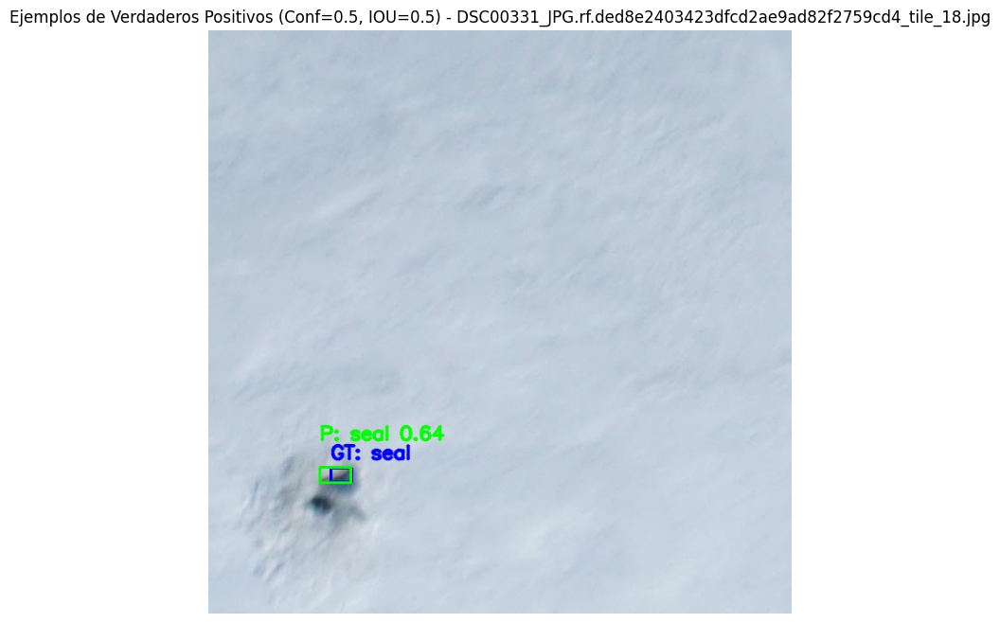

🖼️ Mostrando: DSC00736_JPG.rf.6cc8a7d0f2708471d9cc8598ffb7868a_tile_51.jpg


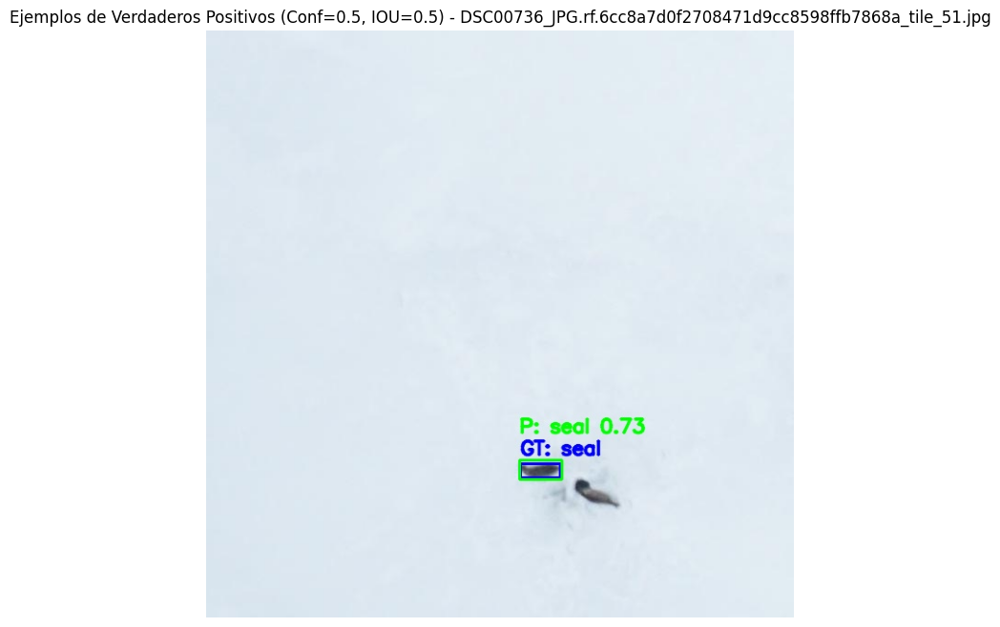

🖼️ Mostrando: DSC00751_JPG.rf.8f822fd5e0e1b2bd06a10539aeb64261_tile_56.jpg


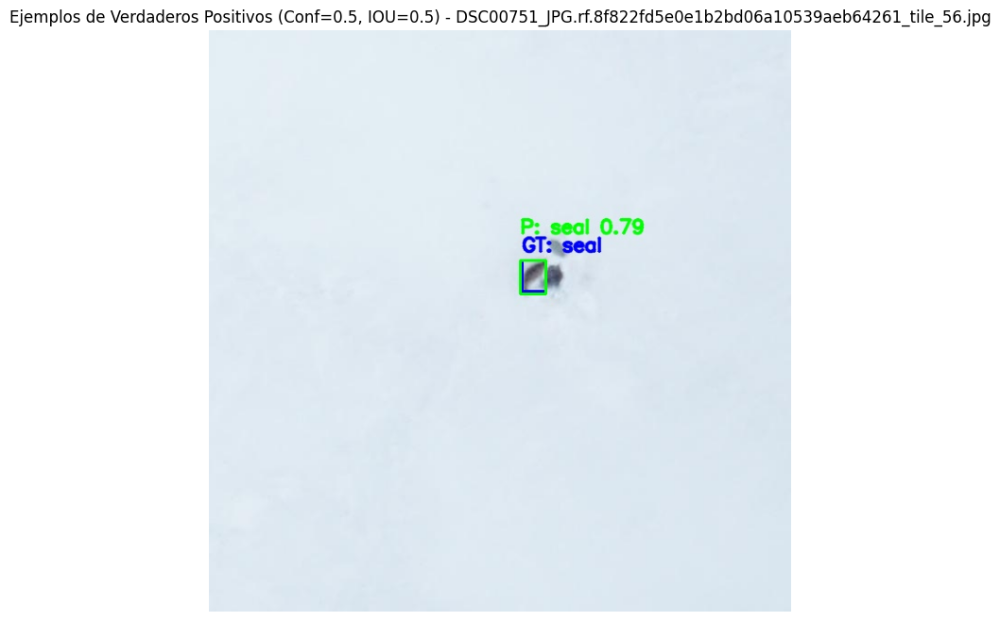


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Negativos (Conf=0.5, IOU=0.5)
🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_0.jpg


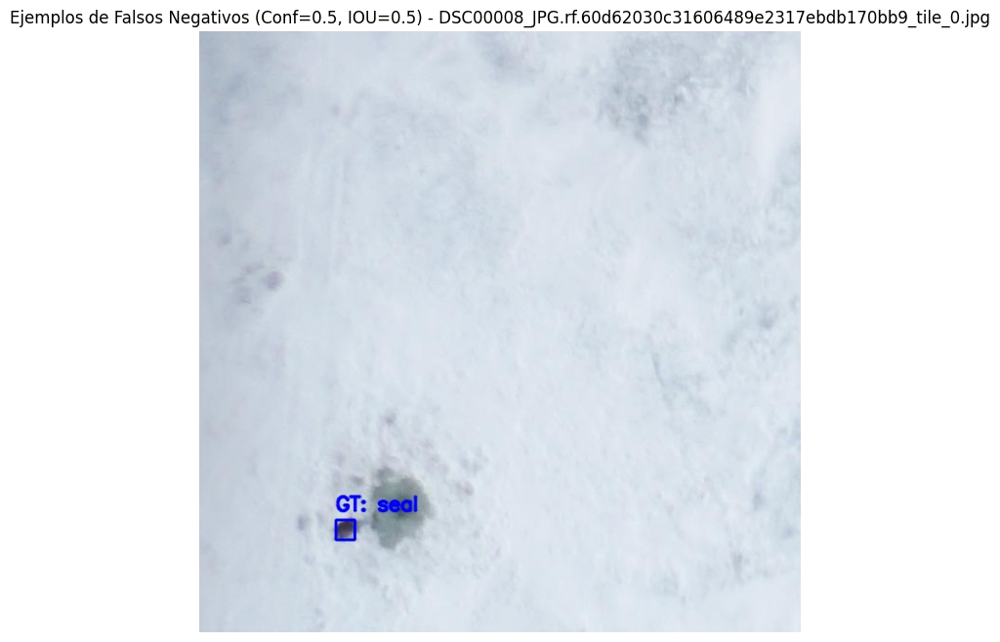

🖼️ Mostrando: DSC00008_JPG.rf.60d62030c31606489e2317ebdb170bb9_tile_12.jpg


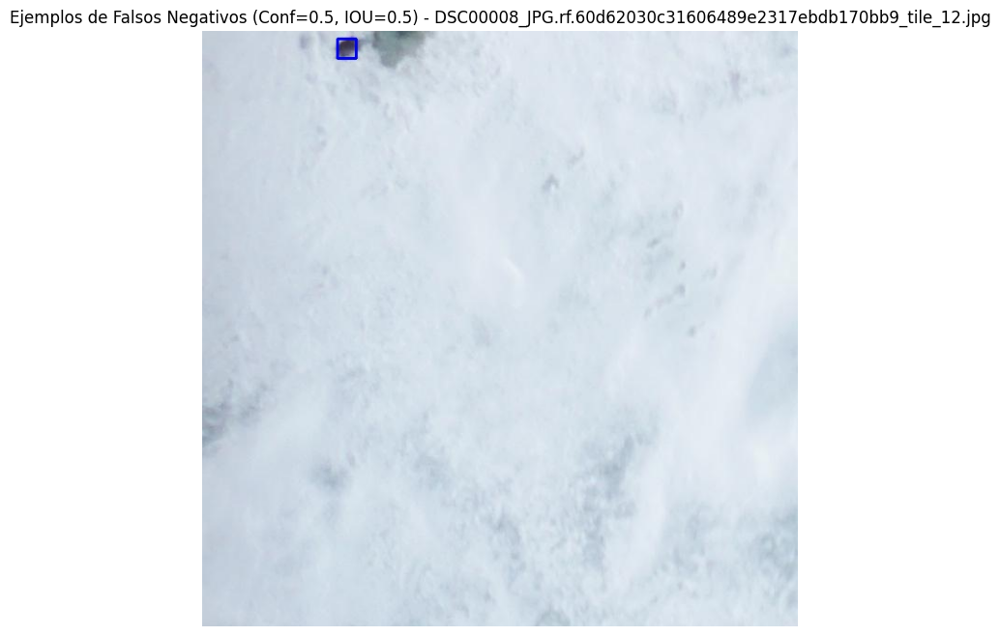

🖼️ Mostrando: DSC00014_JPG.rf.a76945e40b3c94cf00b443ea79c75a70_tile_80.jpg


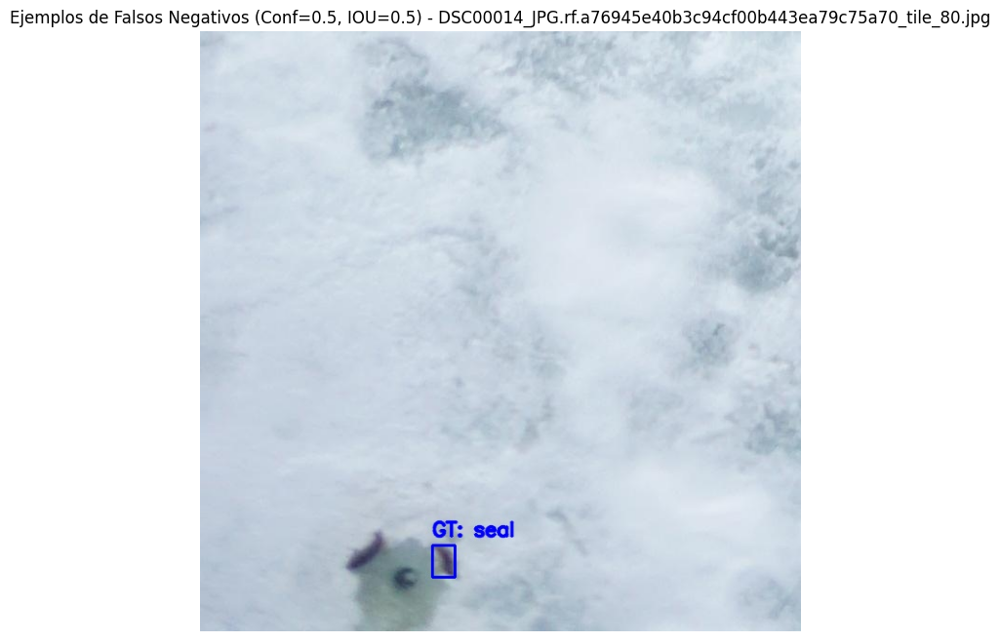


📸 Mostrando primeras 3 imágenes de: Ejemplos de Falsos Positivos (Conf=0.5, IOU=0.5)
🖼️ Mostrando: DSC00331_JPG.rf.ded8e2403423dfcd2ae9ad82f2759cd4_tile_85.jpg


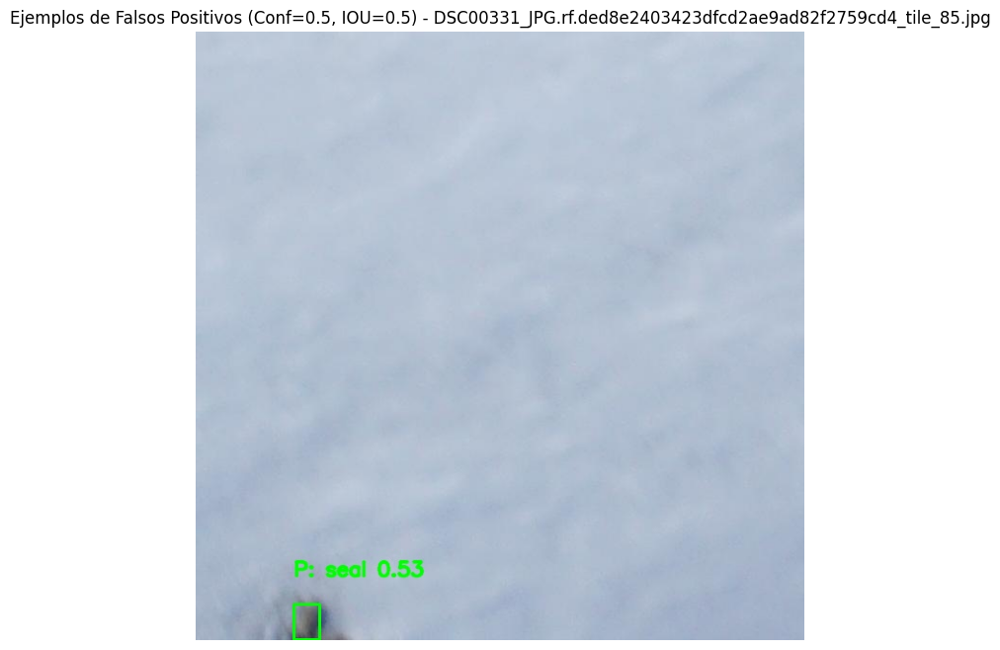

🖼️ Mostrando: DSC09763_JPG.rf.0f59f3cd919b4143713a906960d7dace_tile_52.jpg


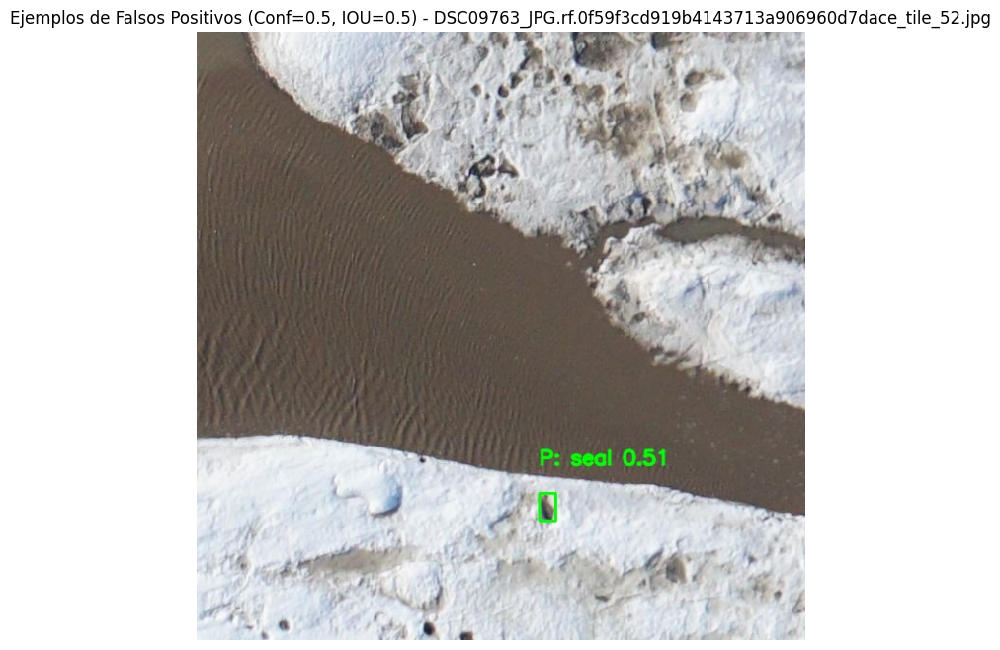


📝 CSV de errores por instancia guardado en: /content/drive/MyDrive/inferencia_proSeal/error_visualizations/conf05_iou05/errores_por_instancia_conf05_iou05.csv

--- Generando curvas de rendimiento para Confianza=0.5, IOU=0.5 ---
📈 Curva Precision-Recall personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou05/precision_recall_curve_iou05.png
📈 Curva F1-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou05/f1_confidence_curve_iou05.png
📈 Curva Precision-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou05/precision_confidence_curve_iou05.png
📈 Curva Recall-Confianza personalizada guardada en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/conf05_iou05/recall_confidence_curve_iou05.png

✅ Todas las métricas combinadas guardadas en Excel en: /content/drive/MyDrive/inferencia_proSeal/analysis_plots/metricas_deteccion_combinadas.xlsx

-

In [6]:
import os
import cv2
import shutil
import matplotlib.pyplot as plt
from pathlib import Path
import pandas as pd
from ultralytics import YOLO
import yaml
import numpy as np
from sklearn.metrics import auc

# --- CONFIGURACIÓN GENERAL ---
# IMPORTANT: CHANGE THIS PATH TO YOUR DESIRED FOLDER IN GOOGLE DRIVE!

DRIVE_BASE_OUTPUT_DIR = "/content/drive/MyDrive/inferencia_proSeal" # <--- CHANGE THIS!

# Ensure the Drive base directory exists
os.makedirs(DRIVE_BASE_OUTPUT_DIR, exist_ok=True)
print(f"✔️ Base output directory set to: {DRIVE_BASE_OUTPUT_DIR}")


# Ruta al modelo YOLOv8 entrenado (ej. 'best.pt')
# Make sure this path is accessible, e.g., if your model is also in Drive, use /content/drive/MyDrive/...
MODEL_PATH = "/content/best_coseno_z_25.pt" # <--- Potentially change if your model is in Drive
# Ruta al archivo data.yaml que define tu dataset
# Make sure this path is accessible, eg., if your data is also in Drive, use /content/drive/MyDrive/...
DATA_YAML_PATH = "/content/van_mijen_eval/data.yaml" # <--- Potentially change if your data is in Drive

# --- CONFIGURACIÓN PARA model.val() (MÉTRICAS OFICIALES) ---
VAL_CONF_THRESHOLD = 0.001
VAL_IOU_THRESHOLD = 0.70

# --- CONFIGURACIÓN PARA EL ANÁLISIS DE ERRORES Y VISUALIZACIÓN PERSONALIZADA ---
# Directorio de ground truth (verdaderas etiquetas) para el conjunto de TEST
GROUND_TRUTH_DIR = "/content/van_mijen_eval/test/labels" # <--- Potentially change if your data is in Drive
# Directorio de IMÁGENES de test (necesario para model.predict)
TEST_IMAGE_DIR = "/content/van_mijen_eval/test/images" # <--- Potentially change if your data is in Drive

# Adjusted output paths to be relative to DRIVE_BASE_OUTPUT_DIR
PREDICTION_OUTPUT_DIR = os.path.join(DRIVE_BASE_OUTPUT_DIR, "custom_predictions", "labels")
ERROR_OUTPUT_BASE_DIR = os.path.join(DRIVE_BASE_OUTPUT_DIR, "error_visualizations")
PLOT_OUTPUT_BASE_DIR = os.path.join(DRIVE_BASE_OUTPUT_DIR, "analysis_plots")
METRICS_EXCEL_DIR = PLOT_OUTPUT_BASE_DIR # Keep combined Excel in plots base folder


# --- UMBRALES MÚLTIPLES PARA EL ANÁLISIS PERSONALIZADO DE TP/FP/FN Y CURVAS ---
ANALYSIS_THRESHOLDS = [
    (0.001, 0.3),  # Primer análisis: Confianza 0.5, IOU 0.3
    (0.001, 0.5),
     (0.01, 0.3),  # Primer análisis: Confianza 0.5, IOU 0.3
    (0.01, 0.5),  # Segundo análisis: Confianza 0.7, IOU 0.5
    (0.1, 0.3),
    (0.1, 0.5),
    (0.25, 0.3),
    (0.25, 0.5),
    (0.5, 0.3),
    (0.5, 0.5)# Segundo análisis: Confianza 0.7, IOU 0.5
    # Add more tuples (confidence, iou) here for more analyses.
]

# Cantidad máxima de imágenes a mostrar en matplotlib para cada categoría de error
MAX_SHOW = 3

# --- COMPROBACIÓN INICIAL DE CARPETAS ---
print("--- Verificando directorios necesarios ---")
for path in [TEST_IMAGE_DIR, GROUND_TRUTH_DIR]:
    if not os.path.exists(path):
        raise FileNotFoundError(f"❌ Error: La carpeta necesaria no existe: {path}. Por favor, verifica tus rutas.")
print("✅ Directorios de datos encontrados.")

# --- LIMPIAR Y CREAR DIRECTORIOS DE SALIDA BASE ---
# Note: The existing folders in DRIVE_BASE_OUTPUT_DIR will *not* be cleared by this script.
# New subfolders will be created within it. If you want to delete previous runs, you'd do it manually.
print("\n--- Preparando directorios de salida ---")
os.makedirs(PREDICTION_OUTPUT_DIR, exist_ok=True)
os.makedirs(ERROR_OUTPUT_BASE_DIR, exist_ok=True)
os.makedirs(PLOT_OUTPUT_BASE_DIR, exist_ok=True)

print("✔️ Output directories ensured in Google Drive.")


# --- FUNCIONES AUXILIARES ---

def load_boxes(txt_file, is_prediction=False):
    """
    Carga las bounding boxes desde un archivo .txt en formato YOLO.
    Args:
        txt_file (str): Ruta al archivo .txt.
        is_prediction (bool): True si el archivo contiene predicciones (incluye confianza), False para GT.
    Returns:
        list: Lista de boxes (class_id, x_center, y_center, width, height, [confidence if is_prediction]).
    """
    if not os.path.exists(txt_file):
        return []
    boxes = []
    with open(txt_file, "r") as f:
        lines = f.readlines()
    for line in lines:
        parts = line.strip().split()
        if (is_prediction and len(parts) != 6) or (not is_prediction and len(parts) != 5):
            print(f"⚠️ Advertencia: Línea con formato incorrecto en {txt_file}: {line.strip()}")
            continue
        try:
            if is_prediction:
                cls, x, y, w, h, conf = map(float, parts)
                boxes.append([cls, x, y, w, h, conf])
            else:
                cls, x, y, w, h = map(float, parts)
                boxes.append([cls, x, y, w, h])
        except ValueError as e:
            print(f"❌ Error de conversión en {txt_file}, línea '{line.strip()}': {e}")
            continue
    return boxes

def iou(box1_coords, box2_coords):
    """
    Calcula el Intersection Over Union (IOU) entre dos bounding boxes YOLO.
    Las coordenadas son en formato normalizado [x_center, y_center, width, height].
    """
    x1, y1, w1, h1 = box1_coords
    x2, y2, w2, h2 = box2_coords

    # Convertir a formato (x_min, y_min, x_max, y_max)
    xa1, ya1 = x1 - w1 / 2, y1 - h1 / 2
    xa2, ya2 = x1 + w1 / 2, y1 + h1 / 2
    xb1, yb1 = x2 - w2 / 2, y2 - h2 / 2
    xb2, yb2 = x2 + w2 / 2, y2 + h2 / 2

    # Coordenadas de la intersección
    xi1, yi1 = max(xa1, xb1), max(ya1, yb1)
    xi2, yi2 = min(xa2, xb2), min(ya2, yb2)

    # Área de la intersección
    inter_area = max(0, xi2 - xi1) * max(0, yi2 - yi1)

    # Áreas de las cajas individuales
    area1 = (xa2 - xa1) * (ya2 - ya1)
    area2 = (xb2 - xb1) * (yb2 - yb1)

    # Área de la unión
    union_area = area1 + area2 - inter_area
    return inter_area / union_area if union_area > 0 else 0

def draw_and_save_boxes(img_path, gt_boxes, pred_boxes, save_path, class_names=None):
    """
    Carga una imagen, dibuja las bounding boxes de ground truth y predicciones, y guarda la imagen.
    Args:
        img_path (str): Ruta a la imagen.
        gt_boxes (list): Lista de boxes GT [class, x, y, w, h].
        pred_boxes (list): Lista de boxes predichas [class, x, y, w, h, confidence].
        save_path (str): Ruta donde guardar la imagen con las boxes dibujadas.
        class_names (list, optional): Lista de nombres de clases para las etiquetas.
    """
    img = cv2.imread(img_path)
    if img is None:
        print(f"❌ No se pudo cargar la imagen: {img_path}")
        return

    h, w = img.shape[:2]

    # Dibujar Ground Truth (azul)
    for gt_box in gt_boxes:
        cls_id, x, y, bw, bh = gt_box[:5]
        # Convertir coordenadas normalizadas a píxeles
        x1 = int((x - bw / 2) * w)
        y1 = int((y - bh / 2) * h)
        x2 = int((x + bw / 2) * w)
        y2 = int((y + bh / 2) * h)
        # Asegurarse de que las coordenadas estén dentro de los límites de la imagen
        x1, y1 = max(0, x1), max(0, y1)
        x2, y2 = min(w - 1, x2), min(h - 1, y2)
        if x2 > x1 and y2 > y1: # Asegurarse de que la caja es válida
            color = (255, 0, 0) # Azul
            cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
            label = f"GT: {int(cls_id)}"
            if class_names and int(cls_id) < len(class_names):
                label = f"GT: {class_names[int(cls_id)]}"
            cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2, cv2.LINE_AA)

    # Dibujar Predicciones (verde)
    for pred_box in pred_boxes:
        cls_id, x, y, bw, bh, conf = pred_box
        # Convertir coordenadas normalizadas a píxeles
        x1 = int((x - bw / 2) * w)
        y1 = int((y - bh / 2) * h)
        x2 = int((x + bw / 2) * w)
        y2 = int((y + bh / 2) * h)
        # Asegurarse de que las coordenadas estén dentro de los límites de la imagen
        x1, y1 = max(0, x1), max(0, y1)
        x2, y2 = min(w - 1, x2), min(h - 1, y2)
        if x2 > x1 and y2 > y1: # Asegurarse de que la caja es válida
            color = (0, 255, 0) # Verde
            cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
            label = f"P: {int(cls_id)} {conf:.2f}"
            if class_names and int(cls_id) < len(class_names):
                label = f"P: {class_names[int(cls_id)]} {conf:.2f}"
            text_y_pos = y1 - 30 if y1 > 50 else y1 + 20 # Ajustar posición del texto si está muy arriba
            cv2.putText(img, label, (x1, text_y_pos),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2, cv2.LINE_AA)

    os.makedirs(os.path.dirname(save_path), exist_ok=True)
    cv2.imwrite(save_path, img)

def mostrar_imagenes(output_dir, titulo):
    """
    Muestra una selección de imágenes guardadas en un directorio específico usando matplotlib.
    Args:
        output_dir (str): Directorio de donde cargar las imágenes.
        titulo (str): Título para las ventanas de las imágenes.
    """
    print(f"\n📸 Mostrando primeras {MAX_SHOW} imágenes de: {titulo}")
    image_paths = []
    if os.path.exists(output_dir):
        image_paths = [os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.lower().endswith((".jpg", ".jpeg", ".png"))]
    else:
        print(f"⚠️ La carpeta {output_dir} no existe para mostrar imágenes.")
        return

    image_paths.sort() # Ordenar para consistencia

    for img_path in image_paths[:MAX_SHOW]:
        print(f"🖼️ Mostrando: {os.path.basename(img_path)}")
        img = cv2.imread(img_path)
        if img is not None:
            plt.figure(figsize=(8, 8))
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.title(f"{titulo} - {os.path.basename(img_path)}")
            plt.axis("off")
            plt.show()

def calculate_all_curves_data(all_preds_flat, all_gts_flat, iou_threshold, num_confidence_bins=100):
    """
    Calcula los datos necesarios para las curvas Precision-Recall, F1-Confidence,
    Precision-Confidence y Recall-Confidence.
    Args:
        all_preds_flat (list): Lista de tuplas (confianza, pred_box_full, img_name) para todas las predicciones.
        all_gts_flat (list): Lista de tuplas (gt_box_full, img_name, gt_global_idx) para todos los ground truths.
        iou_threshold (float): El umbral de IOU fijo para el emparejamiento TP.
        num_confidence_bins (int): Número de puntos para muestrear los umbrales de confianza para las curvas Confianza-Métrica.
    Returns:
        tuple: (precisions_pr, recalls_pr, f1_scores_conf, precisions_conf, recalls_conf, conf_thresholds_for_curves)
    """
    precisions_pr = []
    recalls_pr = []

    # Ordenar todas las predicciones por confianza de mayor a menor para la curva P-R
    all_preds_flat.sort(key=lambda x: x[0], reverse=True)

    num_gts = len(all_gts_flat)
    tp_cumulative = 0
    fp_cumulative = 0
    matched_gts_global_pr = set() # Para la curva P-R, asegurar que cada GT se cuenta una vez

    # --- Calcular datos para la Curva Precision-Recall ---
    for k, (conf, pred_box_full, pred_img_name) in enumerate(all_preds_flat):
        pred_coords = pred_box_full[1:5] # Extraer [x, y, w, h]

        best_iou_for_pred = 0
        best_gt_match_idx = -1

        # Filtrar GTs solo para la imagen actual
        current_image_gts = [gt_item for gt_item in all_gts_flat if gt_item[1] == pred_img_name]

        # Intentar emparejar esta predicción con un GT no emparejado aún
        for gt_item_idx, (gt_box_full, gt_img_name, gt_global_idx) in enumerate(current_image_gts):
            if gt_global_idx in matched_gts_global_pr: # Si este GT ya fue emparejado por una predicción anterior (de mayor confianza), saltar
                continue

            gt_coords = gt_box_full[1:5] # Extraer [x, y, w, h]
            current_iou = iou(gt_coords, pred_coords)

            if current_iou >= iou_threshold and current_iou > best_iou_for_pred:
                best_iou_for_pred = current_iou
                best_gt_match_idx = gt_global_idx

        if best_gt_match_idx != -1: # Si se encontró un match válido
            tp_cumulative += 1
            matched_gts_global_pr.add(best_gt_match_idx) # Marcar el GT como emparejado
        else: # No se encontró un match o el IOU fue bajo
            fp_cumulative += 1

        precision_at_k = tp_cumulative / (tp_cumulative + fp_cumulative) if (tp_cumulative + fp_cumulative) > 0 else 0
        recall_at_k = tp_cumulative / num_gts if num_gts > 0 else 0

        precisions_pr.append(precision_at_k)
        recalls_pr.append(recall_at_k)

    # --- Calcular datos para curvas F1-Confidence, Precision-Confidence y Recall-Confidence ---
    f1_scores_conf = []
    precisions_conf = []
    recalls_conf = []
    # Generar umbrales de confianza de 0 a 1 para estas curvas
    conf_thresholds_for_curves = np.linspace(0, 1, num_confidence_bins)

    for conf_t in conf_thresholds_for_curves:
        tp_at_t = 0
        fp_at_t = 0
        matched_gts_for_current_conf_t = set() # Reiniciar GTs emparejados para cada umbral de confianza

        for pred_item in all_preds_flat:
            conf, pred_box_full, pred_img_name = pred_item
            if conf < conf_t: # Solo considerar predicciones por encima del umbral actual
                continue

            pred_coords = pred_box_full[1:5]

            best_iou_for_pred = 0
            best_gt_match_idx = -1

            current_image_gts = [gt_item for gt_item in all_gts_flat if gt_item[1] == pred_img_name]

            for gt_item_idx, (gt_box_full, gt_img_name, gt_global_idx) in enumerate(current_image_gts):
                if gt_global_idx in matched_gts_for_current_conf_t:
                    continue

                gt_coords = gt_box_full[1:5]
                current_iou = iou(gt_coords, pred_coords)

                if current_iou >= iou_threshold and current_iou > best_iou_for_pred:
                    best_iou_for_pred = current_iou
                    best_gt_match_idx = gt_global_idx

            if best_gt_match_idx != -1:
                tp_at_t += 1
                matched_gts_for_current_conf_t.add(best_gt_match_idx)
            else:
                fp_at_t += 1

        fn_at_t = num_gts - len(matched_gts_for_current_conf_t)

        precision_at_t = tp_at_t / (tp_at_t + fp_at_t) if (tp_at_t + fp_at_t) > 0 else 0
        recall_at_t = tp_at_t / num_gts if num_gts > 0 else 0
        f1_at_t = 2 * (precision_at_t * recall_at_t) / (precision_at_t + recall_at_t) if (precision_at_t + recall_at_t) > 0 else 0

        f1_scores_conf.append(f1_at_t)
        precisions_conf.append(precision_at_t)
        recalls_conf.append(recall_at_t)

    return (precisions_pr, recalls_pr,
            f1_scores_conf, precisions_conf, recalls_conf, conf_thresholds_for_curves)


def plot_curve(x_data, y_data, x_label, y_label, title, iou_threshold, save_path):
    """
    Genera y guarda un plot de una curva de rendimiento.
    Args:
        x_data (list/np.array): Datos para el eje X.
        y_data (list/np.array): Datos para el eje Y.
        x_label (str): Etiqueta del eje X.
        y_label (str): Etiqueta del eje Y.
        title (str): Título del gráfico.
        iou_threshold (float): Umbral de IOU usado para el cálculo (se incluye en el título).
        save_path (str): Ruta completa para guardar el gráfico.
    """
    plt.figure(figsize=(10, 7))
    plt.plot(x_data, y_data, marker='o', linestyle='-', markersize=2)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(f'{title} (IOU={iou_threshold})')
    plt.grid(True)
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    os.makedirs(os.path.dirname(save_path), exist_ok=True)
    plt.savefig(save_path)
    plt.close() # Cerrar la figura para liberar memoria

def plot_metrics_bar_chart(metric_names, metric_values, title, conf, iou, save_path):
    """
    Genera y guarda un gráfico de barras de métricas.
    Args:
        metric_names (list): Nombres de las métricas.
        metric_values (list): Valores de las métricas.
        title (str): Título del gráfico.
        conf (float): Umbral de confianza usado.
        iou (float): Umbral de IOU usado.
        save_path (str): Ruta completa para guardar el gráfico.
    """
    plt.figure(figsize=(10, 6))
    plt.bar(metric_names, metric_values, color='skyblue')
    plt.ylim(0, 1.05)
    plt.title(f"{title}\n(Conf={conf:.2f}, IOU={iou:.2f})")
    plt.ylabel("Valor")
    plt.grid(axis='y')
    plt.tight_layout()
    os.makedirs(os.path.dirname(save_path), exist_ok=True)
    plt.savefig(save_path)
    plt.close()

# --- INICIO DE LA EJECUCIÓN PRINCIPAL ---

# 1. Cargar el modelo YOLOv8 entrenado
print(f"\n--- Paso 1: Cargando el modelo: {MODEL_PATH} ---")
model = YOLO(MODEL_PATH)
print("✅ Modelo cargado exitosamente.")

# 2. Ejecutar VALIDACIÓN para obtener las métricas oficiales de Ultralytics
print("\n--- Paso 2: Ejecutando model.val() para obtener métricas oficiales ---")
# Usar los umbrales de VAL específicos
val_results = model.val(data=DATA_YAML_PATH, split="test", conf=VAL_CONF_THRESHOLD, iou=VAL_IOU_THRESHOLD)

# Mostrar las métricas principales de Ultralytics
metrics = val_results.box
print(f"\n--- Métricas de Validación del Conjunto de TEST (model.val() con conf={VAL_CONF_THRESHOLD}, iou={VAL_IOU_THRESHOLD}) ---")
print(f"mAP50:       {metrics.map50:.4f}")
print(f"mAP50-95:    {metrics.map:.4f}")
print(f"Precisión:   {metrics.mp:.4f}")
print(f"Recall:      {metrics.mr:.4f}")

# Obtener los nombres de clase directamente de los resultados de validación
class_names = val_results.names
class_maps = metrics.maps # mAP@0.5:0.95 para cada clase

print("\n=== mAP50-95 por Clase ===")
for i, cls_map in enumerate(class_maps):
    print(f"{class_names[i]}: mAP50-95 = {cls_map:.4f}")

# Informar la ubicación de los resultados guardados por Ultralytics
try:
    print(f"\n✅ Plots y resultados de model.val() guardados automáticamente por Ultralytics en: {val_results.save_dir}")
except AttributeError:
    print(f"\n✅ Plots y resultados de model.val() guardados automáticamente por Ultralytics.")
    print("   El atributo 'save_dir' no se encontró directamente en el objeto de resultados de esta versión de Ultralytics.")
    print("   Por favor, busca los resultados en el directorio 'runs/detect/valX' (donde X es un número de ejecución) dentro de tu directorio de trabajo.")


# --- GENERAR CSV Y GRÁFICA DE BARRAS PARA LAS MÉTRICAS DE ULTRALYTICS VAL ---
val_precision = metrics.mp
val_recall = metrics.mr
val_f1 = 2 * val_precision * val_recall / (val_precision + val_recall) if (val_precision + val_recall) > 0 else 0
val_map50 = metrics.map50
val_map5095 = metrics.map

val_metric_names = ["Precision", "Recall", "F1-score", "mAP@0.5", "mAP@0.5:0.95"]
val_metric_values = [val_precision, val_recall, val_f1, val_map50, val_map5095]

# Crear un subdirectorio para las métricas de Ultralytics val dentro de PLOT_OUTPUT_BASE_DIR
ultralytics_val_metrics_dir = os.path.join(PLOT_OUTPUT_BASE_DIR, "ultralytics_val_metrics")
os.makedirs(ultralytics_val_metrics_dir, exist_ok=True)

# Guardar CSV de métricas de Ultralytics val
val_csv_filename = f"metricas_ultralytics_val_conf{str(VAL_CONF_THRESHOLD).replace('.', '')}_iou{str(VAL_IOU_THRESHOLD).replace('.', '')}.csv"
val_csv_path = os.path.join(ultralytics_val_metrics_dir, val_csv_filename)
df_val_metrics = pd.DataFrame({
    "Metrica": val_metric_names,
    "Valor": val_metric_values
})
df_val_metrics.to_csv(val_csv_path, index=False)
print(f"\n📄 CSV de métricas de Ultralytics val guardado en: {val_csv_path}")

# Generar y guardar gráfica de barras de métricas de Ultralytics val
val_plot_filename = f"grafica_ultralytics_val_conf{str(VAL_CONF_THRESHOLD).replace('.', '')}_iou{str(VAL_IOU_THRESHOLD).replace('.', '')}.png"
val_plot_path = os.path.join(ultralytics_val_metrics_dir, val_plot_filename)
plot_metrics_bar_chart(val_metric_names, val_metric_values, "Métricas de Ultralytics Val", VAL_CONF_THRESHOLD, VAL_IOU_THRESHOLD, val_plot_path)
print(f"🖼️ Gráfico de métricas de Ultralytics val guardado en: {val_plot_path}")

# Almacenar métricas de Ultralytics para el Excel combinado
all_metrics_to_excel = []
all_metrics_to_excel.append({
    "Metrica": f"mAP50 (Ultralytics, Conf={VAL_CONF_THRESHOLD}, IOU={VAL_IOU_THRESHOLD})",
    "Valor": metrics.map50
})
all_metrics_to_excel.append({
    "Metrica": f"mAP50-95 (Ultralytics, Conf={VAL_CONF_THRESHOLD}, IOU={VAL_IOU_THRESHOLD})",
    "Valor": metrics.map
})
all_metrics_to_excel.append({
    "Metrica": f"Precision (Ultralytics, Conf={VAL_CONF_THRESHOLD}, IOU={VAL_IOU_THRESHOLD})",
    "Valor": metrics.mp
})
all_metrics_to_excel.append({
    "Metrica": f"Recall (Ultralytics, Conf={VAL_CONF_THRESHOLD}, IOU={VAL_IOU_THRESHOLD})",
    "Valor": metrics.mr
})


# 3. Generar y Guardar Predicciones CON CONFIANZA de forma manual
print(f"\n--- Paso 3: Generando predicciones con confianza y guardándolas en {PREDICTION_OUTPUT_DIR} ---")

image_files = [f for f in os.listdir(TEST_IMAGE_DIR) if f.lower().endswith((".jpg", ".png", ".jpeg"))]
image_files.sort() # Ordenar para un procesamiento consistente

if not image_files:
    print(f"⚠️ No se encontraron imágenes en {TEST_IMAGE_DIR}. No se pueden generar predicciones.")
else:
    # Ejecutar predict con un CONF muy bajo (ej. 0.001) para obtener casi todas las detecciones
    # y un IOU de NMS permisivo (ej. 0.7) para no descartar demasiadas predicciones.
    # Es crucial que aquí no se pierdan detecciones por umbrales altos.
    raw_predict_results = model.predict(source=TEST_IMAGE_DIR, conf=0.001, iou=0.7, verbose=False, stream=True)

    for r in raw_predict_results:
        img_name = Path(r.path).name
        img_stem = Path(img_name).stem # Nombre del archivo sin extensión
        pred_txt_path = os.path.join(PREDICTION_OUTPUT_DIR, f"{img_stem}.txt")

        with open(pred_txt_path, "w") as f_out:
            if r.boxes is not None:
                for box in r.boxes:
                    xywhn = box.xywhn[0].tolist() # Coordenadas normalizadas [x_center, y_center, width, height]
                    conf = box.conf[0].item()    # Confianza de la predicción
                    cls_id = box.cls[0].item()   # ID de la clase
                    f_out.write(f"{int(cls_id)} {xywhn[0]:.6f} {xywhn[1]:.6f} {xywhn[2]:.6f} {xywhn[3]:.6f} {conf:.6f}\n")
    print(f"✅ Predicciones con confianza generadas y guardadas manualmente en: {PREDICTION_OUTPUT_DIR}")


# 4. Bucle para Múltiples Análisis de Errores y Curvas Personalizadas
print("\n--- Paso 4: Iniciando bucle para análisis de errores y curvas PERSONALIZADAS ---")

# Almacenar todas las predicciones y GTs para el cálculo de curvas (fuera del bucle para no recargar)
all_preds_flat_for_curves = []
all_gts_flat_for_curves = []
gt_global_counter = 0

if not os.path.exists(PREDICTION_OUTPUT_DIR):
    print(f"❌ La carpeta de predicciones {PREDICTION_OUTPUT_DIR} no se encontró. No se pueden realizar los análisis de errores.")
else:
    # Precargar todos los GTs y predicciones una única vez
    for img_name in image_files:
        img_stem = Path(img_name).stem
        gt_file = os.path.join(GROUND_TRUTH_DIR, f"{img_stem}.txt")
        pred_file = os.path.join(PREDICTION_OUTPUT_DIR, f"{img_stem}.txt") # Predicciones RAW

        gt_boxes_for_image = load_boxes(gt_file, is_prediction=False)
        pred_boxes_for_image = load_boxes(pred_file, is_prediction=True)

        for gt_box in gt_boxes_for_image:
            all_gts_flat_for_curves.append((gt_box, img_name, gt_global_counter))
            gt_global_counter += 1
        for pred_box in pred_boxes_for_image:
            all_preds_flat_for_curves.append((pred_box[5], pred_box, img_name)) # (confianza, box_full, img_name)


    for analysis_conf_threshold, analysis_iou_threshold in ANALYSIS_THRESHOLDS:
        print(f"\n--- Ejecutando Análisis para Confianza={analysis_conf_threshold}, IOU={analysis_iou_threshold} ---")

        # Crear subdirectorios específicos para este análisis
        current_analysis_dir_suffix = f"conf{str(analysis_conf_threshold).replace('.', '')}_iou{str(analysis_iou_threshold).replace('.', '')}"
        current_error_output_dir = os.path.join(ERROR_OUTPUT_BASE_DIR, current_analysis_dir_suffix)
        current_plot_output_dir = os.path.join(PLOT_OUTPUT_BASE_DIR, current_analysis_dir_suffix)

        os.makedirs(os.path.join(current_error_output_dir, "falsos_negativos"), exist_ok=True)
        os.makedirs(os.path.join(current_error_output_dir, "falsos_positivos"), exist_ok=True)
        os.makedirs(os.path.join(current_error_output_dir, "verdaderos_positivos"), exist_ok=True)
        os.makedirs(current_plot_output_dir, exist_ok=True)


        errors_log_current_analysis = [] # Registro para CSV de errores por instancia para este análisis

        for img_name in image_files:
            img_stem = Path(img_name).stem
            gt_file = os.path.join(GROUND_TRUTH_DIR, f"{img_stem}.txt")
            pred_file = os.path.join(PREDICTION_OUTPUT_DIR, f"{img_stem}.txt")
            img_path = os.path.join(TEST_IMAGE_DIR, img_name)

            gt_boxes = load_boxes(gt_file, is_prediction=False)
            pred_boxes_with_conf = load_boxes(pred_file, is_prediction=True) # Predicciones RAW

            # Filtrar las predicciones con el umbral de confianza actual para este análisis
            filtered_pred_boxes = [box for box in pred_boxes_with_conf if box[5] >= analysis_conf_threshold]

            matched_preds_indices = set() # Para evitar contar la misma predicción dos veces
            matched_gts_indices = set()   # Para evitar contar el mismo GT dos veces

            for j, pred_box_full in enumerate(filtered_pred_boxes):
                pred_coords = pred_box_full[1:5] # Coordenadas normalizadas [x,y,w,h]
                best_iou_val = 0
                best_gt_idx = -1

                for i, gt_box_full in enumerate(gt_boxes):
                    if i in matched_gts_indices: # Si este GT ya ha sido emparejado por una predicción anterior
                        continue

                    gt_coords = gt_box_full[1:5]
                    current_iou = iou(gt_coords, pred_coords)

                    # Si el IOU es suficiente y es el mejor IOU para esta predicción hasta ahora
                    if current_iou >= analysis_iou_threshold and current_iou > best_iou_val:
                        best_iou_val = current_iou
                        best_gt_idx = i

                if best_gt_idx != -1: # Si se encontró un match (Verdadero Positivo)
                    matched_preds_indices.add(j)
                    matched_gts_indices.add(best_gt_idx)
                    tp_dest = os.path.join(current_error_output_dir, "verdaderos_positivos", os.path.basename(img_path))
                    draw_and_save_boxes(img_path, [gt_boxes[best_gt_idx]], [pred_box_full], tp_dest, class_names=class_names)
                    errors_log_current_analysis.append([img_name, "true_positive", f"conf{analysis_conf_threshold}_iou{analysis_iou_threshold}", f"GT:{gt_boxes[best_gt_idx]}|Pred:{pred_box_full}"])
                # Si no hay match para esta predicción, es un Falso Positivo (FP)

            # Identificar Falsos Negativos (FN): GTs que no fueron emparejados por ninguna predicción
            for i, gt_box_full in enumerate(gt_boxes):
                if i not in matched_gts_indices:
                    fn_dest = os.path.join(current_error_output_dir, "falsos_negativos", os.path.basename(img_path))
                    draw_and_save_boxes(img_path, [gt_box_full], [], fn_dest, class_names=class_names)
                    errors_log_current_analysis.append([img_name, "false_negative", f"conf{analysis_conf_threshold}_iou{analysis_iou_threshold}", str(gt_box_full)])

            # Identificar Falsos Positivos (FP): Predicciones que no emparejaron con ningún GT
            for j, pred_box_full in enumerate(filtered_pred_boxes):
                if j not in matched_preds_indices:
                    fp_dest = os.path.join(current_error_output_dir, "falsos_positivos", os.path.basename(img_path))
                    draw_and_save_boxes(img_path, [], [pred_box_full], fp_dest, class_names=class_names)
                    errors_log_current_analysis.append([img_name, "false_positive", f"conf{analysis_conf_threshold}_iou{analysis_iou_threshold}", str(pred_box_full)])


        # --- CÁLCULO DE MÉTRICAS DE ANÁLISIS PERSONALIZADO (TP, FP, FN, P, R, F1, AP) ---
        TP_count = len([e for e in errors_log_current_analysis if e[1] == "true_positive"])
        FN_count = len([e for e in errors_log_current_analysis if e[1] == "false_negative"])
        FP_count = len([e for e in errors_log_current_analysis if e[1] == "false_positive"])

        precision_analysis = TP_count / (TP_count + FP_count) if (TP_count + FP_count) > 0 else 0
        recall_analysis = TP_count / (TP_count + FN_count) if (TP_count + FN_count) > 0 else 0
        f1_analysis = 2 * precision_analysis * recall_analysis / (precision_analysis + recall_analysis) if (precision_analysis + recall_analysis) > 0 else 0

        # Calcular Average Precision (AP) para la curva P-R personalizada
        precisions_pr_curve, recalls_pr_curve, \
        f1_scores_conf_curve, precisions_conf_curve, recalls_conf_curve, conf_thresholds_for_curves = \
            calculate_all_curves_data(all_preds_flat_for_curves, all_gts_flat_for_curves, analysis_iou_threshold)

        # Ordenar puntos por recall para el cálculo del AUC y eliminar duplicados para precisión
        pr_points = sorted(zip(recalls_pr_curve, precisions_pr_curve))
        sorted_recalls = [p[0] for p in pr_points]
        sorted_precisions = [p[1] for p in pr_points]

        # Filtrar puntos duplicados para un cálculo de AUC más robusto
        unique_recalls = []
        unique_precisions = []
        if sorted_recalls:
            unique_recalls.append(sorted_recalls[0])
            unique_precisions.append(sorted_precisions[0])
            for i in range(1, len(sorted_recalls)):
                if sorted_recalls[i] != unique_recalls[-1] or sorted_precisions[i] != unique_precisions[-1]:
                    unique_recalls.append(sorted_recalls[i])
                    unique_precisions.append(sorted_precisions[i])

        # Calcular el Average Precision (AP)
        if len(unique_recalls) > 1 and len(unique_precisions) > 1:
            custom_ap = auc(unique_recalls, unique_precisions)
        else:
            custom_ap = 0.0 # Si no hay suficientes puntos para una curva significativa

        print(f"\n--- Resultados del análisis de errores PERSONALIZADO (Confianza={analysis_conf_threshold}, IOU={analysis_iou_threshold}) ---")
        print(f"✔️ Verdaderos positivos (TP): {TP_count}")
        print(f"❌ Falsos negativos (FN): {FN_count}")
        print(f"⚠️ Falsos positivos (FP): {FP_count}")
        print(f"📊 Precision (análisis): {precision_analysis:.4f}")
        print(f"📊 Recall (análisis):     {recall_analysis:.4f}")
        print(f"📊 F1-score (análisis):  {f1_analysis:.4f}")
        print(f"📊 Average Precision (AP) de curva P-R: {custom_ap:.4f}")
        if len(class_names) == 1:
            print(f"    (Para una sola clase, AP es equivalente al mAP para este IOU.)")
        else:
            print(f"    (Para múltiples clases, este es el AP para la clase 'seal'. El mAP general promediaría los AP de todas las clases.)")

        # Almacenar métricas de este análisis personalizado para el Excel combinado
        all_metrics_to_excel.append({
            "Metrica": f"TP (Análisis Personalizado, Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})",
            "Valor": TP_count
        })
        all_metrics_to_excel.append({
            "Metrica": f"FN (Análisis Personalizado, Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})",
            "Valor": FN_count
        })
        all_metrics_to_excel.append({
            "Metrica": f"FP (Análisis Personalizado, Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})",
            "Valor": FP_count
        })
        all_metrics_to_excel.append({
            "Metrica": f"Precision (Análisis Personalizado, Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})",
            "Valor": precision_analysis
        })
        all_metrics_to_excel.append({
            "Metrica": f"Recall (Análisis Personalizado, Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})",
            "Valor": recall_analysis
        })
        all_metrics_to_excel.append({
            "Metrica": f"F1-score (Análisis Personalizado, Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})",
            "Valor": f1_analysis
        })
        all_metrics_to_excel.append({
            "Metrica": f"AP Personalizado (IOU={analysis_iou_threshold})",
            "Valor": custom_ap
        })

        # --- GENERAR CSV Y GRÁFICA DE BARRAS PARA LAS MÉTRICAS DE ESTE ANÁLISIS PERSONALIZADO ---
        current_analysis_metric_names = ["TP", "FN", "FP", "Precision", "Recall", "F1-score", "AP"]
        current_analysis_metric_values = [TP_count, FN_count, FP_count, precision_analysis, recall_analysis, f1_analysis, custom_ap]

        # Guardar CSV de métricas de este análisis
        analysis_csv_filename = f"metricas_analisis_conf{str(analysis_conf_threshold).replace('.', '')}_iou{str(analysis_iou_threshold).replace('.', '')}.csv"
        analysis_csv_path = os.path.join(current_plot_output_dir, analysis_csv_filename)
        df_analysis_metrics = pd.DataFrame({
            "Metrica": current_analysis_metric_names,
            "Valor": current_analysis_metric_values
        })
        df_analysis_metrics.to_csv(analysis_csv_path, index=False)
        print(f"\n📄 CSV de métricas de este análisis guardado en: {analysis_csv_path}")

        # Generar y guardar gráfica de barras de métricas de este análisis
        analysis_plot_filename = f"grafica_analisis_conf{str(analysis_conf_threshold).replace('.', '')}_iou{str(analysis_iou_threshold).replace('.', '')}.png"
        analysis_plot_path = os.path.join(current_plot_output_dir, analysis_plot_filename)
        plot_metrics_bar_chart(current_analysis_metric_names, current_analysis_metric_values, "Métricas de Análisis Personalizado", analysis_conf_threshold, analysis_iou_threshold, analysis_plot_path)
        print(f"🖼️ Gráfico de métricas de este análisis guardado en: {analysis_plot_path}")


        # --- MOSTRAR IMÁGENES DE EJEMPLO DE ERRORES/ACIERTO PARA ESTE ANÁLISIS ---
        mostrar_imagenes(os.path.join(current_error_output_dir, "verdaderos_positivos"), f"Ejemplos de Verdaderos Positivos (Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})")
        mostrar_imagenes(os.path.join(current_error_output_dir, "falsos_negativos"), f"Ejemplos de Falsos Negativos (Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})")
        mostrar_imagenes(os.path.join(current_error_output_dir, "falsos_positivos"), f"Ejemplos de Falsos Positivos (Conf={analysis_conf_threshold}, IOU={analysis_iou_threshold})")

        # --- EXPORTAR REGISTRO DE ERRORES A CSV PARA ESTE ANÁLISIS ---
        df_errors = pd.DataFrame(errors_log_current_analysis, columns=["image", "instance_type", "analysis_params", "box_coords"])
        csv_output_path_errors = os.path.join(current_error_output_dir, f"errores_por_instancia_{current_analysis_dir_suffix}.csv")
        df_errors.to_csv(csv_output_path_errors, index=False)
        print(f"\n📝 CSV de errores por instancia guardado en: {csv_output_path_errors}")

        # --- GENERAR Y GUARDAR PLOTS DE CURVAS PERSONALIZADAS PARA ESTE ANÁLISIS ---
        print(f"\n--- Generando curvas de rendimiento para Confianza={analysis_conf_threshold}, IOU={analysis_iou_threshold} ---")

        # Curva Precision-Recall
        filename_pr = f"precision_recall_curve_iou{str(analysis_iou_threshold).replace('.', '')}.png"
        plot_curve(recalls_pr_curve, precisions_pr_curve, 'Recall', 'Precision',
                    f'Curva Precision-Recall Personalizada',
                    analysis_iou_threshold, os.path.join(current_plot_output_dir, filename_pr))
        print(f"📈 Curva Precision-Recall personalizada guardada en: {os.path.join(current_plot_output_dir, filename_pr)}")

        # Curva F1-Confianza
        filename_f1_conf = f"f1_confidence_curve_iou{str(analysis_iou_threshold).replace('.', '')}.png"
        plot_curve(conf_thresholds_for_curves, f1_scores_conf_curve, 'Umbral de Confianza', 'Puntuación F1',
                    f'Curva F1-Confianza Personalizada',
                    analysis_iou_threshold, os.path.join(current_plot_output_dir, filename_f1_conf))
        print(f"📈 Curva F1-Confianza personalizada guardada en: {os.path.join(current_plot_output_dir, filename_f1_conf)}")

        # Curva Precision-Confianza
        filename_p_conf = f"precision_confidence_curve_iou{str(analysis_iou_threshold).replace('.', '')}.png"
        plot_curve(conf_thresholds_for_curves, precisions_conf_curve, 'Umbral de Confianza', 'Precision',
                    f'Curva Precision-Confianza Personalizada',
                    analysis_iou_threshold, os.path.join(current_plot_output_dir, filename_p_conf))
        print(f"📈 Curva Precision-Confianza personalizada guardada en: {os.path.join(current_plot_output_dir, filename_p_conf)}")

        # Curva Recall-Confianza
        filename_r_conf = f"recall_confidence_curve_iou{str(analysis_iou_threshold).replace('.', '')}.png"
        plot_curve(conf_thresholds_for_curves, recalls_conf_curve, 'Umbral de Confianza', 'Recall',
                    f'Curva Recall-Confianza Personalizada',
                    analysis_iou_threshold, os.path.join(current_plot_output_dir, filename_r_conf))
        print(f"📈 Curva Recall-Confianza personalizada guardada en: {os.path.join(current_plot_output_dir, filename_r_conf)}")

# Guardar todas las métricas combinadas en un archivo Excel al final
df_all_metrics = pd.DataFrame(all_metrics_to_excel)
excel_output_path = os.path.join(METRICS_EXCEL_DIR, "metricas_deteccion_combinadas.xlsx")
df_all_metrics.to_excel(excel_output_path, index=False)
print(f"\n✅ Todas las métricas combinadas guardadas en Excel en: {excel_output_path}")

print("\n--- Script Finalizado ---")

# **6. Saving any results or especific folder into Google Drive if desired**

In [ ]:
# 10. Guardar los resultados del experimento

# Define la carpeta de destino en Google Drive
dest_folder = "/content/drive/MyDrive/inferencia/Van_mijenfjorden_2025"
!mkdir -p "{dest_folder}"                                                           #El comando mkdir -p crea esa carpeta (y cualquier subcarpeta necesaria) si no existe.

# Copia la carpeta de resultados (ajusta el nombre según el que se haya generado)
!cp -r /content/runs/detect/val "{dest_folder}/"   #copiar los reultados del modelo en drive


# Comprueba que se copiaron los archivos (opcional)
!ls "{dest_folder}"                                                                 #verifica que los archivos se han copiado correctamente

# Opcional: comprimir la carpeta de resultados para descargarla a tu PC
#!zip -r /content/seals_2025/focas_prueba_snow.zip "{dest_folder}/focas_prueba_snow"   #Aquí se comprime la carpeta que acabas de copiar en Drive (la subcarpeta focas_training_prueba1_640_24_02_25 dentro de foquitas) en un archivo ZIP llamado foquitas.zip que se guarda en /content (la carpeta principal del entorno de Colab).

# Descargar el archivo ZIP a tu PC
#from google.colab import files
#files.download('/content/seals_2025/focas_prueba_snow.zip')                                             #Este comando abre una ventana de descarga para que puedas bajar el archivo ZIP a tu ordenador.